<a href="https://colab.research.google.com/github/Andre-do-Amaral/Competicao_Regressao/blob/main/7COMPETICAO_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Treino e Comparação de Modelos

In [ ]:
from sklearn.model_selection import cross_val_predict
def retorna_resultados(X = treino.drop('remuneracao_log', axis = 1), y = treino.remuneracao_log, modelo = RandomForestRegressor(),
                       num = num_11, cat = cat_11, scaler = StandardScaler(), encoder = ce.OneHotEncoder()):

  num_pipe = Pipeline(steps = [('scaler', scaler)])
  cat_pipe = Pipeline(steps = [('encoder', encoder)])
  preprocessing = ColumnTransformer([('trans_num', num_pipe, num),
                                     ('trans_cat', cat_pipe, cat)])
  pipe_ = Pipeline(steps = [('Preprocessing', preprocessing), ('model', modelo)])
  scoring = ['neg_mean_absolute_error', 'neg_root_mean_squared_error', 'r2']
  scores = cross_validate(pipe_, X, y, scoring=scoring, return_train_score = True, cv = 5)
  preditos_log = cross_val_predict(pipe_, X, y, cv = 5)
  preditos = np.exp(preditos_log)

  mae_train = scores['train_neg_mean_absolute_error']
  mae_test = scores['test_neg_mean_absolute_error']
  rmse_train = scores['train_neg_root_mean_squared_error']
  rmse_test = scores['test_neg_root_mean_squared_error']
  r2_train = scores['train_r2']
  r2_test = scores['test_r2']

  return mae_train, mae_test, rmse_train, rmse_test, r2_train, r2_test, preditos

In [ ]:
num_cats = [[(num_11, cat_11), (num_12, cat_12)],
           [(num_21, cat_21), (num_22, cat_22)],
           [(num_31, cat_31), (num_32, cat_32)],
           [(num_41, cat_41), (num_42, cat_42)],
           [(num_51, cat_51), (num_52, cat_52)],
           [(num_61, cat_61), (num_62, cat_62)]]

In [ ]:
dados.tamanho_da_empresa.unique()

array([10,  3,  7,  8,  5,  4,  6,  2,  9])

In [ ]:


dadosao = [dados_1, dados_2, dados_3,
           dados_4, dados_5, dados_6]

num_cats = [[(num_11, cat_11), (num_12, cat_12)],
           [(num_21, cat_21), (num_22, cat_22)],
           [(num_31, cat_31), (num_32, cat_32)],
           [(num_41, cat_41), (num_42, cat_42)],
           [(num_51, cat_51), (num_52, cat_52)],
           [(num_61, cat_61), (num_62, cat_62)]]
num_cats[0]
modelos = [RandomForestRegressor(), GradientBoostingRegressor(), KNeighborsRegressor(),
           Ridge(), Lasso(), ElasticNet(), SVR(), LGBMRegressor(), XGBRegressor()]

name_modelos = ['RF', 'GBR', 'KNN', 'L2', 'L1', 'L1_L2', 'SVM', 'LGBM', 'XGB']

scalers = [StandardScaler(), MinMaxScaler()]
encoders = [ce.OneHotEncoder(), ce.OrdinalEncoder(), ce.CatBoostEncoder()]
name_dados = [1,2,3,4,5,6]
name_scal = ['Standard', 'MinMax']
name_encoder = ['OneHot', 'Ordinal', 'CatBoost']
num_cats_name = [1,2]

data_frame = []
mae_train_list = []
mae_test_list = []
rmse_train_list = []
rmse_test_list = []
r2_train_list = []
r2_test_list = []
tipo = []
mae_medio_train = []
mae_median_train = []
mae_std_train = []
rmse_medio_train = []
rmse_std_train = []
r2_medio_train = []
r2_std_train = []
mae_medio_test = []
mae_median_test = []
mae_std_test = []
rmse_medio_test = []
rmse_std_test = []
r2_medio_test = []
r2_std_test = []
preditos_test = []
real_test =  np.exp(treino.remuneracao_log)
columns = ['MAE_TRAIN_MEAN', 'MAE_TEST_MEAN',
                     'MAE_TRAIN_SUM','MAE_TEST_SUM',
                     'MAE_TRAIN_STD', 'MAE_TEST_STD',
                     'RMSE_TRAIN_MEAN', 'RMSE_TEST_MEAN',
                     'RMSE_TRAIN_STD', 'RMSE_TEST_STD',
                     'R2_TRAIN_MEAN', 'R2_TEST_MEAN',
                     'R2_TRAIN_STD', 'R2_TEST_STD']
                     
for pos_dados, dados_aqui in enumerate(dadosao):
  for pos_cat, num_cat in enumerate(num_cats[pos_dados]):
    for pos_scaler, scaler in enumerate(scalers):
      for pos_encoder, encoder in enumerate(encoders):
        for pos_modelo, modelo in enumerate(modelos):
          print(f'=================Rodando {name_modelos[pos_modelo]}=================')
          mae_train, mae_test, rmse_train, rmse_test, r2_train, r2_test, preditos = retorna_resultados(X = dados_aqui.drop('remuneracao_log', axis = 1),
                                                                                             y = dados_aqui.remuneracao_log,
                                                                                             modelo = modelo,
                                                                                             num = num_cat[0],
                                                                                             cat = num_cat[1],
                                                                                             scaler = scaler, encoder = encoder)
          
          mae_train_list.append(mae_train)
          mae_test_list.append(mae_test)
          rmse_train_list.append(rmse_train)
          rmse_test_list.append(rmse_test)
          r2_train_list.append(r2_train)
          r2_test_list.append(r2_test)
          preditos_test.append(preditos)
          tipo.append(f'''Dados: {name_dados[pos_dados]}
                      Categorias: {num_cats_name[pos_cat]}
                      Scaler: {name_scal[pos_scaler]}
                      Encoder: {name_encoder[pos_encoder]}
                      Modelo: {name_modelos[pos_modelo]}''')
          
          mae_medio_train.append(mae_train.mean())
          mae_median_train.append(mae_train.sum())
          mae_std_train.append(mae_train.std())
          mae_medio_test.append(mae_test.mean())
          mae_median_test.append(mae_test.sum())
          mae_std_test.append(mae_test.std())
          rmse_medio_train.append(rmse_train.mean())
          rmse_std_train.append(rmse_train.std())
          rmse_medio_test.append(rmse_test.mean())
          rmse_std_test.append(rmse_test.std())
          r2_medio_train.append(r2_train.mean())
          r2_std_train.append(r2_train.std())
          r2_medio_test.append(r2_test.mean())
          r2_std_test.append(r2_test.std())

          data_frame.append([mae_train.mean(), mae_test.mean(),
                             mae_train.sum(), mae_test.sum(),
                             mae_train.std(), mae_test.std(),
                             rmse_train.mean(), rmse_test.mean(),
                             rmse_train.std(), rmse_test.std(),
                             r2_train.mean(), r2_test.mean(),
                             r2_train.std(), r2_test.std()])
          
          print(f'=================Rodou o {name_modelos[pos_modelo]}=================')
          
          

=================Rodando RF=================
=================Rodou o RF=================
=================Rodando GBR=================
=================Rodou o GBR=================
=================Rodando KNN=================
=================Rodou o KNN=================
=================Rodando L2=================
=================Rodou o L2=================
=================Rodando L1=================
=================Rodou o L1=================
=================Rodando L1_L2=================
=================Rodou o L1_L2=================
=================Rodando SVM=================
=================Rodou o SVM=================
=================Rodando LGBM=================
=================Rodou o LGBM=================
=================Rodando XGB=================
[16:37:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:37:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now depre

In [ ]:
pd.set_option('display.max_rows', None)
df = pd.DataFrame(data_frame, index = tipo, columns = columns).sort_values('MAE_TEST_MEAN', ascending = False)
df

,MAE_TRAIN_MEAN,MAE_TEST_MEAN,MAE_TRAIN_SUM,MAE_TEST_SUM,MAE_TRAIN_STD,MAE_TEST_STD,RMSE_TRAIN_MEAN,RMSE_TEST_MEAN,RMSE_TRAIN_STD,RMSE_TEST_STD,R2_TRAIN_MEAN,R2_TEST_MEAN,R2_TRAIN_STD,R2_TEST_STD
Dados: 6\n Categorias: 2\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 2\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 2\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 1\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 6\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,-0.314419,-0.357050,-1.572094,-1.785252,0.001142,0.003006,-0.424053,-0.488336,0.001170,0.005934,0.661132,0.549673,0.004300,0.019788
Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310
Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310
Dados: 1\n Categorias: 2\n Scaler: MinMax\n Encoder: CatBoost\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310
Dados: 1\n Categorias: 2\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,-0.314420,-0.357283,-1.572100,-1.786413,0.001193,0.002282,-0.423976,-0.488299,0.001199,0.004784,0.661256,0.549737,0.004218,0.019310


In [ ]:
real_test

11797     1526.86
5899      1525.97
9513     17515.11
1572      3534.93
12995     2965.29
879       2426.42
1578      2671.56
6472      1532.53
1509      2484.89
1896      6890.13
8963      5160.60
4112      1141.67
10140     1785.79
1845      1029.44
13942     2852.54
9751      3514.28
9282      1807.60
7565      1638.09
5194      3539.73
5418      5230.12
13896     1128.83
13133     1099.89
7413      1658.24
14115     2226.70
5405      9361.48
8310       502.61
3614      2719.24
2108      3507.13
12437     2371.44
8248      3533.61
14947     2096.82
11376     3025.31
14126     1204.78
7759      1040.16
12695     1342.33
5653      1350.82
13210     1218.26
8431      3286.09
6827      2003.14
14744     1117.70
4325      1303.45
3219     11135.15
9642      2413.59
6345      1145.06
6884      1100.49
1193      1174.39
45        3245.56
13954     3252.37
976       6929.87
11890     1168.82
2963     10027.52
1584      1745.21
9459      1041.14
4515       706.44
12799     1030.45
11038     

In [ ]:
pd.set_option('display.max_rows', 10)

df = pd.DataFrame(preditos_test).T
df = df.set_index(real_test.index)
df.columns = tipo
df = pd.concat([df, pd.Series(real_test, name = 'VERDADEIRO')], axis = 1)

In [ ]:
pd.set_option('display.max_rows', 10)
df

,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: L2,...,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categor

In [ ]:
erros = df.copy()
for column in erros.columns:
  erros[column] = erros[column] - erros['VERDADEIRO']
erros

,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: OneHot\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: MinMax\n Encoder: Ordinal\n Modelo: L2,...,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: Ordinal\n Modelo: XGB,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categor

In [ ]:
t = erros.filter(regex = '(Dados: 6|Dados: 1)').filter(regex = 'CatB').filter(regex = 'Standard').filter(regex = 'Categorias: 1\n')
metricas = t.T.describe()
metricas

,11797,5899,9513,1572,12995,879,1578,6472,1509,1896,8963,4112,10140,1845,13942,9751,9282,7565,5194,5418,13896,13133,7413,14115,5405,8310,3614,2108,12437,8248,14947,11376,14126,7759,12695,5653,13210,8431,6827,14744,...,2747,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6420,5051,5311,2433,6949,13803,10583,769,1685,8322,11111,11363,11636,14423,5578,4426,13526,466,6265,5734,11284,11964,5191,13418,5390,860,7270
count,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,...,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000,18.000000
mean,176.498310,155.426938,-13739.713992,-1797.062124,-714.741070,-459.948334,2175.909302,409.594770,-771.889249,-3669.475323,-3094.308143,331.532719,-275.195350,662.801946,-921.755087,-651.686246,-213.529170,264.301206,-803.810672,-1995.748263,288.199819,320.422024,-110.134399,-258.332253,-6234.110157,596.235603,14.011719,-1430.079935,-659.667334,-1763.808703,410.725614,-528.166586,162.202367,692.927891,111.915720,14.618259,517.173908,408.561259,-534.190428,142.814538,...,2193.677237,262.711120,352.434733,333.434271,22.780061,-776.760826,-378.669605,244.440058,1085.703875,749.013137,199.227844,379.271427,672.558853,1370.842995,-2670.069531,-1523.918613,-2062.809259,619.027979,413.637572,-6823.579333,589.531344,353.831392,-499.975785,432.080906,1154.961592,-838.437039,-437.855370,229.737505,-1330.553086,-1098.360433,1244.239512,-11396.563934,2147.978142,-3015.213680,370.183907,301.921390,1454.740169,559.092326,753.972868,369.560172
std,155.895838,151.870290,628.762497,106.356813,646.350188,372.004262,957.614889,751.270580,157.750763,1032.651560,303.396434,217.990753,181.200175,85.816794,172.412605,442.649661,147.580593,733.109438,492.521317,1006.606202,183.723659,202.195418,173.218433,701.602019,1052.947141,394.544963,371.477920,667.069826,200.791651,88.261316,539.038792,597.606814,237.485453,851.911112,200.165218,257.472679,291.029628,1522.336790,191.322713,355.132250,...,1184.611206,478.669733,1163.529764,242.737413,299.514075,653.592360,124.333547,181.288430,465.477754,172.066232,511.140323,210.104224,535.965395,706.012930,380.878264,168.038046,664.839249,172.145289,523.375124,1553.448452,281.004190,261.983331,528.616767,122.392337,362.746480,364.318686,200.826174,377.734990,278.029678,627.620602,586.290443,729.019856,497.785552,1853.262886,138.786155,230.322066,681.494742,164.251886,127.353771,223.399559
min,-94.576284,-14.431804,-14459.343171,-1991.052170,-1412.572123,-866.547216,524.788883,-481.950571,-1247.183490,-5122.004380,-3616.072315,-21.134673,-671.091927,492.068819,-1136.904457,-1758.232885,-373.223626,-247.839921,-1755.229487,-3508.654957,62.412589,134.855660,-414.178938,-869.310437,-7593.354380,-15.974679,-409.810706,-2135.542460,-992.181097,-1878.955265,-328.694380,-1503.429271,-86.991378,-194.582112,-126.076475,-401.809403,206.013339,-1517.964380,-843.290472,-493.105811,...,489.068447,-267.487470,-1142.119663,109.123422,-249.549818,-1751.756889,-506.692283,89.667237,337.385652,558.774014,-315.016803,163.106196,94.306323,378.918781,-3137.968097,-1797.141256,-3143.571553,268.100521,-21.918090,-8932.921553,149.661124,49.511924,-1522.711416,298.619123,418.775026,-1506.068014,-649.747992,-533.467460,-1714.411276,-1636.663009,212.119046,-12446.791553,1312.704235,-5352.131276,215.689461,108.551789,208.

In [ ]:

pd.set_option('max_rows', 10)
aux_filt = t.T.abs()
aux_filt

,11797,5899,9513,1572,12995,879,1578,6472,1509,1896,8963,4112,10140,1845,13942,9751,9282,7565,5194,5418,13896,13133,7413,14115,5405,8310,3614,2108,12437,8248,14947,11376,14126,7759,12695,5653,13210,8431,6827,14744,...,2747,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6420,5051,5311,2433,6949,13803,10583,769,1685,8322,11111,11363,11636,14423,5578,4426,13526,466,6265,5734,11284,11964,5191,13418,5390,860,7270
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,335.123819,522.003935,13105.257187,1672.097689,1412.572123,342.793371,2898.602210,151.864520,698.679199,3340.987782,3039.438038,18.722113,316.173134,597.337871,1082.960081,445.148715,31.245189,236.693685,1227.752447,1188.038284,301.320772,210.962625,283.232355,399.253110,6227.468662,345.544370,282.335005,1716.209653,787.955817,1834.635333,1286.405217,1317.283439,61.276785,272.847695,79.266172,168.901758,214.619244,2713.202248,810.480342,270.882605,...,3110.436776,211.795471,2393.608523,225.035245,17.243395,1586.587650,501.219455,91.974705,730.641800,1249.005197,315.016803,494.269134,114.152766,444.179731,2040.818133,1391.331855,1849.112042,944.258998,21.918090,4849.180664,149.661124,697.292910,1189.595683,298.619123,1982.898406,894.636629,472.646391,343.790648,1502.799071,1439.065047,293.592413,10661.828750,1533.065092,556.726278,371.177165,456.997341,2443.158224,702.691487,628.772372,346.768363
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,129.931092,29.966077,13621.685592,1814.041210,1221.439952,647.178869,2433.206421,351.618890,737.469313,2859.029187,3036.377921,284.711750,364.619812,675.109923,899.302626,828.381015,331.672550,96.043527,475.161030,1828.871751,140.889585,270.122614,227.319220,652.983634,5106.824312,433.733606,303.114505,1919.707857,748.537744,1798.932614,706.429085,793.949267,8.002573,512.857264,35.163204,43.653204,407.829480,1361.998866,661.511404,113.175870,...,2826.632372,107.339942,349.845613,235.875434,84.021792,868.746072,426.655622,169.070900,875.295467,629.442946,96.989535,163.106196,147.216889,1041.018716,2643.544573,1571.639527,1539.589212,561.407219,23.371791,5725.799575,344.610786,213.092972,140.467013,348.280010,815.057786,868.336294,560.439803,243.052097,1258.113161,1539.946787,1258.141130,10750.693962,2422.888771,2604.262809,275.640599,159.396846,2069.437617,562.984295,705.540466,291.442128
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,260.904917,99.609522,14459.343171,1885.125066,779.420747,866.547216,3379.880099,344.659256,1045.022034,4260.278105,3616.072315,52.640381,580.312098,548.343999,652.254011,1758.232885,237.948972,247.839921,1755.229487,1546.150961,62.412589,256.154357,49.520984,538.904156,4773.874687,15.974679,409.810706,1254.227350,992.181097,1878.955265,61.198924,643.211848,86.991378,464.459623,129.205618,401.809403,1545.670162,621.370517,385.104691,49.382230,...,4216.627090,440.323063,1680.244178,109.123422,165.358098,1751.756889,429.683304,92.924618,337.385652,667.036377,71.887155,282.693195,1117.457762,496.476434,3137.968097,1473.597805,2573.795180,268.100521,21.446564,6677.172748,750.636710,977.931278,1522.711416,390.421248,864.541015,448.133650,468.295162,537.898809,1292.769578,1636.663009,754.514576,11204.677762,1933.711954,1092.748341,231.292168,188.530316,662.313076,709.035617,1039.396186,316.847053
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,450.241268,244.671327,13957.564446,1920.741333,960.055859,235.610915,2906.826158,6.018715,659.466673,3407.645613,2517.263327,443.672084,129.975679,713.909438,602.546952,94.855707,179.926668,81.539980,328.016662,1921.741216,218.211283,138.954651,49.919679,439.360452,6640.551256,464.605016,359.363682,1758.248571,507.043185,1559.505816,713.247636,144.720726,171.089286,36.810772,154.669699,32.053635,563.741032,61.520578,478.938425,493.105811,...,1579.855325,296.935487,1138.970984,268.515749,246.725589,358.381350,79.761629,298.733234,1632.909626,87

### Selecionando meus maiores erros

In [ ]:
soma_aux = pd.DataFrame(pd.Series(aux_filt.sum(), name = 'soma'))
index_outliers = soma_aux[soma_aux['soma']>20000].index
index_normais = soma_aux[soma_aux['soma']<=20000].index

In [ ]:
print(len(index_normais))
print(len(index_outliers))
display(aux_filt[index_normais].head(1))
display(aux_filt[index_outliers].head(1))
display(t.T.head())

7423
3077


,11797,5899,12995,879,6472,1509,4112,10140,1845,13942,9751,9282,7565,5194,13896,13133,7413,14115,8310,3614,12437,14947,11376,14126,7759,12695,5653,13210,6827,14744,4325,9642,6345,6884,1193,11890,1584,9459,4515,12799,...,10253,8792,5393,14502,11080,8838,3890,3556,11394,1528,7734,1899,189,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6949,13803,769,1685,8322,11111,11636,14423,5578,13526,11964,5191,5390,860,7270
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,335.123819,522.003935,1412.572123,342.793371,151.86452,698.679199,18.722113,316.173134,597.337871,1082.960081,445.148715,31.245189,236.693685,1227.752447,301.320772,210.962625,283.232355,399.25311,345.54437,282.335005,787.955817,1286.405217,1317.283439,61.276785,272.847695,79.266172,168.901758,214.619244,810.480342,270.882605,857.57816,154.789493,733.72387,139.007442,387.012867,144.088952,0.603608,1118.750739,1130.778901,104.31113,...,265.541359,300.220329,686.608999,191.625248,709.735156,285.346172,6.360838,249.293961,1406.96325,1739.528719,99.823818,68.819622,105.439057,211.795471,2393.608523,225.035245,17.243395,1586.58765,501.219455,91.974705,730.6418,1249.005197,315.016803,494.269134,114.152766,944.258998,21.91809,149.661124,697.29291,1189.595683,298.619123,894.636629,472.646391,343.790648,1439.065047,371.177165,456.997341,702.691487,628.772372,346.768363


,9513,1572,1578,1896,8963,5418,5405,2108,8248,8431,3219,45,13954,976,2963,3912,9811,11880,12456,11923,12450,10132,37,576,4822,2335,11522,1180,13142,13204,9558,5733,9185,2829,10735,5277,8254,4219,11705,3118,...,8571,14552,12185,7892,7869,9467,11990,14605,161,5675,14737,7989,13417,1021,3152,8226,9555,7513,10555,10627,14356,1267,4658,3005,2734,9998,9167,2747,6420,5051,5311,2433,10583,11363,4426,466,6265,5734,11284,13418
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,13105.257187,1672.097689,2898.60221,3340.987782,3039.438038,1188.038284,6227.468662,1716.209653,1834.635333,2713.202248,5094.573561,1244.733626,1489.47397,332.115267,4932.133044,7196.236531,1088.723423,4798.118959,1143.059309,1837.570418,2538.845513,3814.544842,6278.835455,1728.210775,3701.819532,2588.320905,1269.914655,2168.518119,2204.801744,1061.468062,1186.863615,10139.662347,4572.147177,1210.513713,1114.426282,4739.987563,2189.577878,2541.645699,6422.811735,7787.816074,...,1835.928376,6926.629467,1728.499312,1973.72325,2884.354625,1782.434052,3426.63164,56.1022,1258.46089,1776.37134,12398.887425,1303.621834,1201.471483,1159.362678,21061.630171,2547.315336,2039.404941,7595.883784,2230.014785,6990.944993,1408.386564,581.022694,302.568625,923.622562,1258.821471,2416.824437,5578.99648,3110.436776,444.179731,2040.818133,1391.331855,1849.112042,4849.180664,1982.898406,1502.799071,293.592413,10661.82875,1533.065092,556.726278,2443.158224


,11797,5899,9513,1572,12995,879,1578,6472,1509,1896,8963,4112,10140,1845,13942,9751,9282,7565,5194,5418,13896,13133,7413,14115,5405,8310,3614,2108,12437,8248,14947,11376,14126,7759,12695,5653,13210,8431,6827,14744,...,2747,2047,7849,2558,9274,8666,11096,13035,6396,12309,3385,4555,1184,6420,5051,5311,2433,6949,13803,10583,769,1685,8322,11111,11363,11636,14423,5578,4426,13526,466,6265,5734,11284,11964,5191,13418,5390,860,7270
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,335.123819,522.003935,-13105.257187,-1672.097689,-1412.572123,342.793371,2898.602210,-151.864520,-698.679199,-3340.987782,-3039.438038,-18.722113,-316.173134,597.337871,-1082.960081,-445.148715,31.245189,-236.693685,-1227.752447,-1188.038284,301.320772,210.962625,-283.232355,-399.253110,-6227.468662,345.544370,-282.335005,-1716.209653,-787.955817,-1834.635333,1286.405217,-1317.283439,61.276785,272.847695,-79.266172,-168.901758,214.619244,2713.202248,-810.480342,270.882605,...,3110.436776,-211.795471,2393.608523,225.035245,-17.243395,-1586.587650,-501.219455,91.974705,730.641800,1249.005197,-315.016803,494.269134,114.152766,444.179731,-2040.818133,-1391.331855,-1849.112042,944.258998,-21.918090,-4849.180664,149.661124,697.292910,-1189.595683,298.619123,1982.898406,-894.636629,-472.646391,343.790648,-1502.799071,-1439.065047,293.592413,-10661.828750,1533.065092,556.726278,371.177165,456.997341,2443.158224,702.691487,628.772372,346.768363
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,129.931092,29.966077,-13621.685592,-1814.041210,-1221.439952,-647.178869,2433.206421,351.618890,-737.469313,-2859.029187,-3036.377921,284.711750,-364.619812,675.109923,-899.302626,-828.381015,-331.672550,-96.043527,-475.161030,-1828.871751,140.889585,270.122614,-227.319220,-652.983634,-5106.824312,433.733606,-303.114505,-1919.707857,-748.537744,-1798.932614,706.429085,-793.949267,8.002573,512.857264,-35.163204,-43.653204,407.829480,1361.998866,-661.511404,113.175870,...,2826.632372,-107.339942,349.845613,235.875434,-84.021792,-868.746072,-426.655622,169.070900,875.295467,629.442946,-96.989535,163.106196,147.216889,1041.018716,-2643.544573,-1571.639527,-1539.589212,561.407219,23.371791,-5725.799575,344.610786,213.092972,-140.467013,348.280010,815.057786,-868.336294,-560.439803,243.052097,-1258.113161,-1539.946787,1258.141130,-10750.693962,2422.888771,-2604.262809,275.640599,159.396846,2069.437617,562.984295,705.540466,291.442128
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,260.904917,99.609522,-14459.343171,-1885.125066,-779.420747,-866.547216,3379.880099,344.659256,-1045.022034,-4260.278105,-3616.072315,52.640381,-580.312098,548.343999,-652.254011,-1758.232885,-237.948972,-247.839921,-1755.229487,-1546.150961,62.412589,256.154357,49.520984,-538.904156,-4773.874687,-15.974679,-409.810706,-1254.227350,-992.181097,-1878.955265,61.198924,-643.211848,-86.991378,464.459623,129.205618,-401.809403,1545.670162,621.370517,-385.104691,49.382230,...,4216.627090,440.323063,1680.244178,109.123422,-165.358098,-1751.756889,-429.683304,92.924618,337.385652,667.036377,71.887155,282.693195,1117.457762,496.476434,-3137.968097,-1473.597805,-2573.795180,268.100521,-21.446564,-6677.172748,750.636710,977.931278,-1522.711416,390.421248,864.541015,-448.133650,-468.295162,537.898809,-1292.769578,-1636.663009,754.514576,-11204.677762,1933.711954,-1092.748341,231.292168,188.530316,662.313076,709.035617,1039.396186,316.847053
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,450.241268,244.671327,-13957.564446,-1920.741333,-960.055859,-235.610915,2906.826158,-6.018715,-659.466673,-3407.645613,-2517.263327,443.672084,-129.975679,713.909438,-602.546952,-94.855707,-179.926668,81.539980,-328.016662,-1921.741216,218.211283,138.954651,-49.919679,-439.360452,-6640.551256,464.605016,359.363682,-1758.248571,-507.043185,-1559.505816,713.247636,144.720726,171.089286,-36.810772,154.669699,32.053635,563.741

In [ ]:
t_transpose = t.T.copy() #previsto - verdadeiro
fig = px.histogram(t_transpose[index_outliers])
fig.show()

/usr/local/lib/python3.7/dist-packages/plotly/express/_core.py:1222: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  df_output[col_name] = to_unindexed_series(df_input[argument])


In [ ]:
t_transpose = t.T.copy() #previsto - verdadeiro
fig = px.histogram(t_transpose[index_normais])
fig.show()

/usr/local/lib/python3.7/dist-packages/plotly/express/_core.py:1222: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`



In [ ]:
#aux = metricas.T
#aux[(aux['50%']>1000)|(aux['50%']<-1000)].abs().mean()

In [ ]:
#aux[(aux['50%']<5000)&(aux['50%']>-5000)].abs()#.mean()

In [ ]:


#index_normais = aux[(aux['50%']<2000)&(aux['50%']>-2000)].abs().index
#index_outliers = aux[(aux['50%']>2000)|(aux['50%']<-2000)].abs().index

In [ ]:


normais = dados.loc[index_normais]
out = dados.loc[index_outliers]


### Entendendo o que torna um dado com erros grandes e com erros normais

================sexo=============


,sexo,sexo
1,4329,0.583187
2,3094,0.416813


Grafico de distribuição de idade com relação a sexo


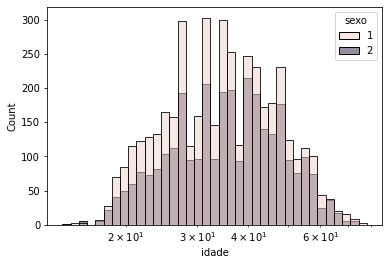

==================Categoria 1


count    4329.000000
mean       35.890044
std        11.113509
min        14.000000
25%        27.000000
50%        34.000000
75%        43.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 2


count    3094.000000
mean       36.774402
std        10.981902
min        14.000000
25%        28.000000
50%        36.000000
75%        44.000000
max        74.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


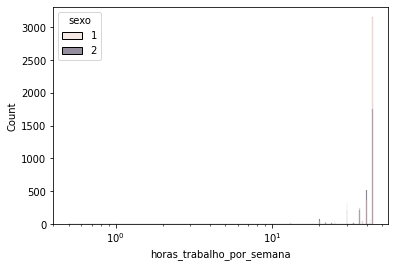

==================Categoria 1


count    4329.000000
mean       41.196466
std         6.492133
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    3094.000000
mean       39.362153
std         7.429983
min         0.500000
25%        36.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


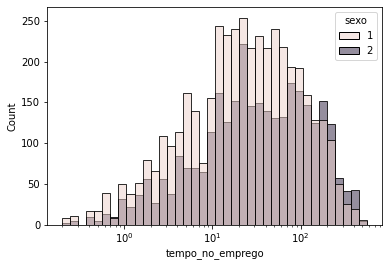

==================Categoria 1


count    4329.000000
mean       50.281959
std        66.806669
min         0.200000
25%         8.800000
50%        23.500000
75%        64.900000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    3094.000000
mean       68.196542
std        84.626565
min         0.200000
25%        11.325000
50%        31.800000
75%        94.475000
max       525.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a sexo


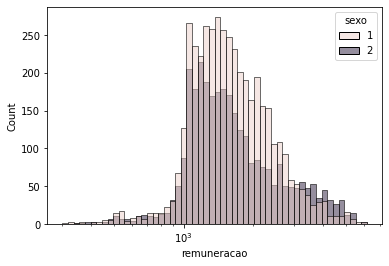

==================Categoria 1


count    4329.000000
mean     1720.355098
std       744.983663
min       301.430000
25%      1212.180000
50%      1529.930000
75%      2054.710000
max      5877.420000
Name: remuneracao, dtype: float64

==================Categoria 2


count    3094.000000
mean     1824.219250
std       948.138727
min       343.840000
25%      1182.407500
50%      1501.240000
75%      2134.010000
max      6141.800000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a sexo


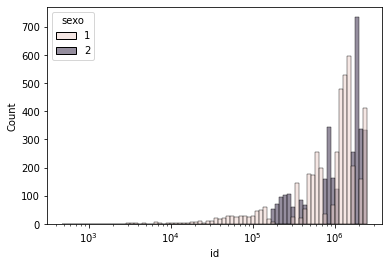

==================Categoria 1


count    4.329000e+03
mean     1.091476e+06
std      6.505612e+05
min      4.770000e+02
25%      5.524750e+05
50%      1.179030e+06
75%      1.479791e+06
max      2.350277e+06
Name: id, dtype: float64

==================Categoria 2


count    3.094000e+03
mean     1.352859e+06
std      7.416831e+05
min      1.728660e+05
25%      7.907280e+05
50%      1.718010e+06
75%      1.939978e+06
max      2.459818e+06
Name: id, dtype: float64

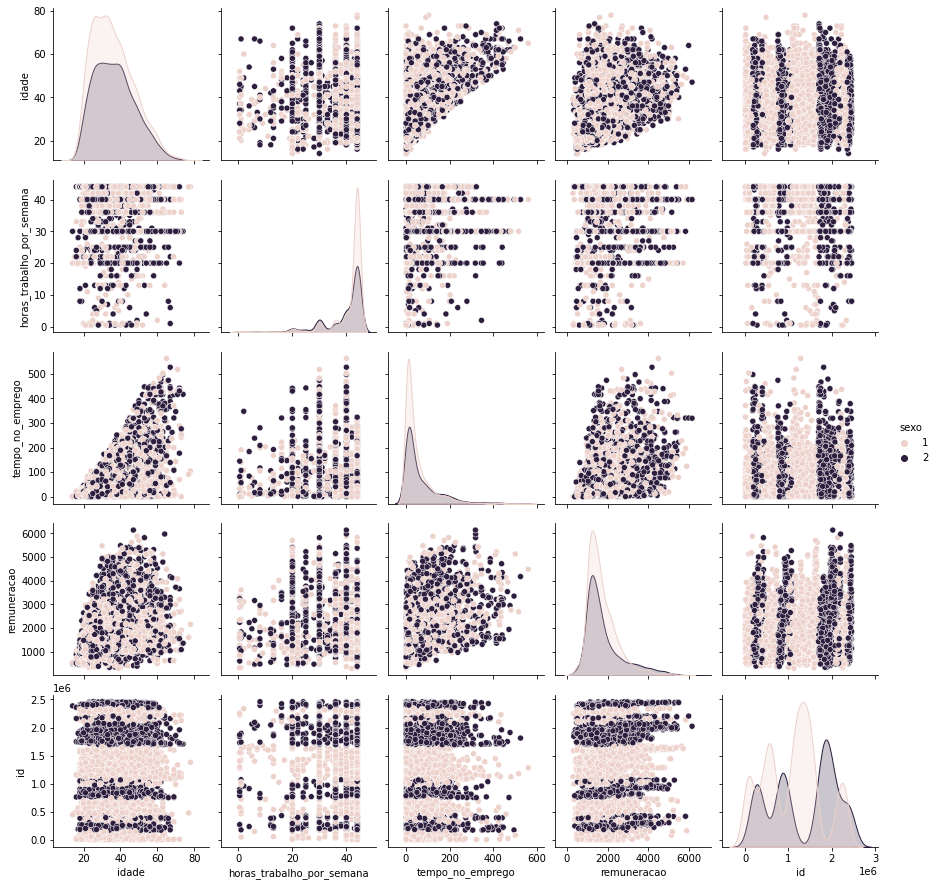

================faixa_etaria=============


,faixa_etaria,faixa_etaria
5,2393,0.322376
6,1690,0.227671
4,1241,0.167183
3,1084,0.146033
7,917,0.123535
8,73,0.009834
2,23,0.003098
1,2,0.000269


Grafico de distribuição de idade com relação a faixa_etaria


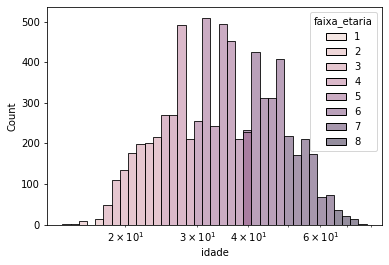

==================Categoria 6


count    1690.000000
mean       43.936095
std         2.880191
min        40.000000
25%        41.000000
50%        44.000000
75%        46.000000
max        49.000000
Name: idade, dtype: float64

==================Categoria 4


count    1241.000000
mean       26.899275
std         1.401730
min        25.000000
25%        26.000000
50%        27.000000
75%        28.000000
max        29.000000
Name: idade, dtype: float64

==================Categoria 3


count    1084.000000
mean       21.687269
std         1.782490
min        18.000000
25%        20.000000
50%        22.000000
75%        23.000000
max        24.000000
Name: idade, dtype: float64

==================Categoria 7


count    917.000000
mean      55.000000
std        3.906103
min       50.000000
25%       52.000000
50%       54.000000
75%       58.000000
max       64.000000
Name: idade, dtype: float64

==================Categoria 5


count    2393.000000
mean       34.337651
std         2.865372
min        30.000000
25%        32.000000
50%        34.000000
75%        37.000000
max        39.000000
Name: idade, dtype: float64

==================Categoria 1


count     2.0
mean     14.0
std       0.0
min      14.0
25%      14.0
50%      14.0
75%      14.0
max      14.0
Name: idade, dtype: float64

==================Categoria 8


count    73.000000
mean     68.397260
std       3.076523
min      65.000000
25%      66.000000
50%      67.000000
75%      70.000000
max      78.000000
Name: idade, dtype: float64

==================Categoria 2


count    23.000000
mean     16.478261
std       0.665348
min      15.000000
25%      16.000000
50%      17.000000
75%      17.000000
max      17.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


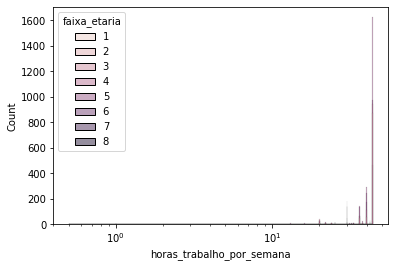

==================Categoria 6


count    1690.000000
mean       39.541420
std         7.333391
min         0.500000
25%        36.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    1241.000000
mean       41.607977
std         6.066734
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    1084.000000
mean       41.572878
std         6.605927
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    917.000000
mean      39.097601
std        7.012895
min        0.500000
25%       36.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    2393.000000
mean       40.740493
std         6.747053
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     2.000000
mean     25.000000
std       7.071068
min      20.000000
25%      22.500000
50%      25.000000
75%      27.500000
max      30.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    73.000000
mean     35.794521
std       9.419187
min       1.000000
25%      30.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    23.000000
mean     25.782609
std       9.085235
min      20.000000
25%      20.000000
50%      22.000000
75%      26.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


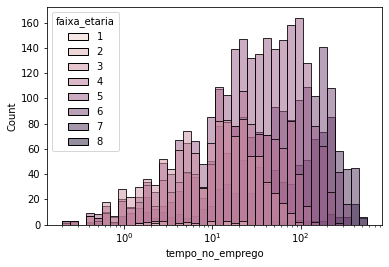

==================Categoria 6


count    1690.00000
mean       78.32645
std        76.68103
min         0.20000
25%        15.75000
50%        47.90000
75%       128.27500
max       368.90000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    1241.000000
mean       27.982756
std        26.949500
min         0.200000
25%         7.500000
50%        18.800000
75%        39.900000
max       133.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    1084.000000
mean       14.294742
std        14.903351
min         0.200000
25%         3.600000
50%         9.900000
75%        20.200000
max       104.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    917.000000
mean     127.377099
std      118.513134
min        0.300000
25%       25.000000
50%       94.700000
75%      199.800000
max      501.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    2393.000000
mean       46.842457
std        46.914222
min         0.200000
25%        10.900000
50%        29.300000
75%        70.900000
max       250.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count    2.000000
mean     1.800000
std      0.565685
min      1.400000
25%      1.600000
50%      1.800000
75%      2.000000
max      2.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     73.000000
mean     232.608219
std      164.831885
min        0.500000
25%       78.900000
50%      227.000000
75%      386.800000
max      561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    23.00000
mean      8.43913
std       7.02125
min       1.40000
25%       2.55000
50%       5.50000
75%      14.95000
max      21.80000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a faixa_etaria


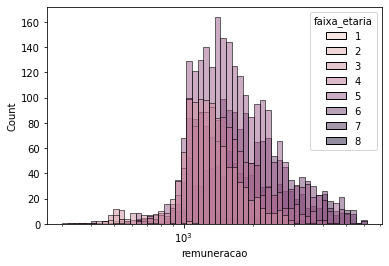

==================Categoria 6


count    1690.000000
mean     1987.888243
std       949.325155
min       327.040000
25%      1288.675000
50%      1697.395000
75%      2402.790000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 4


count    1241.000000
mean     1567.328147
std       593.807219
min       349.910000
25%      1157.000000
50%      1418.710000
75%      1812.630000
max      4613.610000
Name: remuneracao, dtype: float64

==================Categoria 3


count    1084.000000
mean     1317.393026
std       425.625128
min       326.150000
25%      1067.780000
50%      1251.715000
75%      1482.282500
max      3556.980000
Name: remuneracao, dtype: float64

==================Categoria 7


count     917.000000
mean     2110.424351
std      1040.671486
min       502.670000
25%      1342.240000
50%      1777.640000
75%      2586.210000
max      5974.310000
Name: remuneracao, dtype: float64

==================Categoria 5


count    2393.000000
mean     1778.433782
std       790.551760
min       301.430000
25%      1235.820000
50%      1556.470000
75%      2111.230000
max      5477.340000
Name: remuneracao, dtype: float64

==================Categoria 1


count      2.00000
mean     519.98000
std       24.56489
min      502.61000
25%      511.29500
50%      519.98000
75%      528.66500
max      537.35000
Name: remuneracao, dtype: float64

==================Categoria 8


count      73.000000
mean     2083.964932
std       907.128903
min       623.220000
25%      1434.590000
50%      1887.430000
75%      2637.730000
max      4487.360000
Name: remuneracao, dtype: float64

==================Categoria 2


count      23.000000
mean      638.765652
std       219.471771
min       466.530000
25%       504.510000
50%       523.730000
75%       747.955000
max      1144.250000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a faixa_etaria


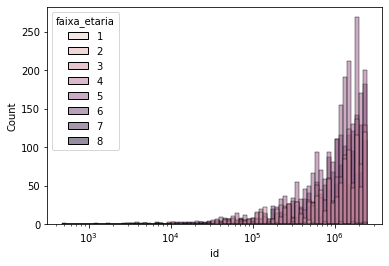

==================Categoria 6


count    1.690000e+03
mean     1.216882e+06
std      6.948159e+05
min      3.781000e+03
25%      6.278775e+05
50%      1.172716e+06
75%      1.792392e+06
max      2.458471e+06
Name: id, dtype: float64

==================Categoria 4


count    1.241000e+03
mean     1.197259e+06
std      7.121070e+05
min      3.195000e+03
25%      5.764230e+05
50%      1.238370e+06
75%      1.820907e+06
max      2.457833e+06
Name: id, dtype: float64

==================Categoria 3


count    1.084000e+03
mean     1.148086e+06
std      7.314615e+05
min      4.815000e+03
25%      5.024968e+05
50%      1.196954e+06
75%      1.774600e+06
max      2.451342e+06
Name: id, dtype: float64

==================Categoria 7


count    9.170000e+02
mean     1.237052e+06
std      7.037086e+05
min      1.187000e+03
25%      6.327760e+05
50%      1.218198e+06
75%      1.778964e+06
max      2.445626e+06
Name: id, dtype: float64

==================Categoria 5


count    2.393000e+03
mean     1.201849e+06
std      6.873675e+05
min      4.770000e+02
25%      6.003570e+05
50%      1.222348e+06
75%      1.790268e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 1


count    2.000000e+00
mean     1.416436e+06
std      1.369908e+06
min      4.477640e+05
25%      9.320998e+05
50%      1.416436e+06
75%      1.900771e+06
max      2.385107e+06
Name: id, dtype: float64

==================Categoria 8


count    7.300000e+01
mean     1.216210e+06
std      6.158228e+05
min      6.847000e+03
25%      9.838720e+05
50%      1.179273e+06
75%      1.708747e+06
max      2.224773e+06
Name: id, dtype: float64

==================Categoria 2


count    2.300000e+01
mean     9.510079e+05
std      7.877024e+05
min      1.371800e+04
25%      4.675165e+05
50%      7.648670e+05
75%      1.745934e+06
max      2.362464e+06
Name: id, dtype: float64

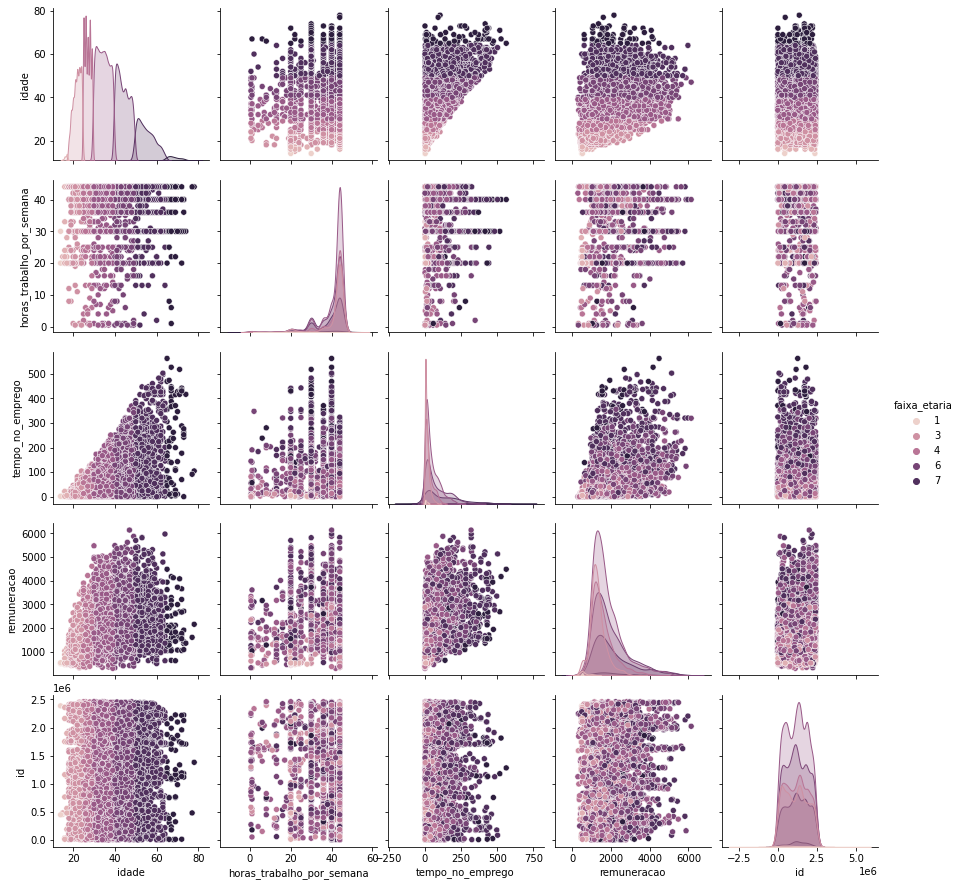

================cor_raca=============


,cor_raca,cor_raca
8,3872,0.521622
99,1569,0.211370
9,1002,0.134986
2,747,0.100633
4,180,0.024249
6,41,0.005523
1,12,0.001617


Grafico de distribuição de idade com relação a cor_raca


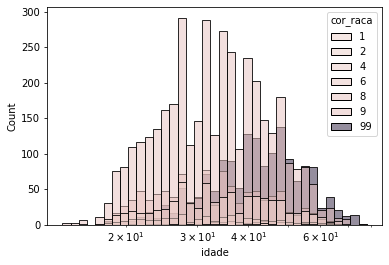

==================Categoria 8


count    3872.000000
mean       34.441890
std        10.317398
min        14.000000
25%        26.000000
50%        33.000000
75%        41.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 9


count    1002.000000
mean       33.919162
std        10.314943
min        17.000000
25%        25.000000
50%        32.000000
75%        41.000000
max        66.000000
Name: idade, dtype: float64

==================Categoria 99


count    1569.000000
mean       42.767368
std        10.968941
min        18.000000
25%        35.000000
50%        42.000000
75%        50.000000
max        74.000000
Name: idade, dtype: float64

==================Categoria 2


count    747.000000
mean      35.613119
std       10.921067
min       17.000000
25%       27.000000
50%       34.000000
75%       43.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 4


count    180.000000
mean      33.283333
std       10.550901
min       16.000000
25%       25.000000
50%       31.500000
75%       40.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 6


count    41.000000
mean     39.609756
std      10.530617
min      21.000000
25%      33.000000
50%      38.000000
75%      44.000000
max      64.000000
Name: idade, dtype: float64

==================Categoria 1


count    12.000000
mean     40.166667
std      10.187634
min      26.000000
25%      32.750000
50%      40.500000
75%      43.750000
max      59.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


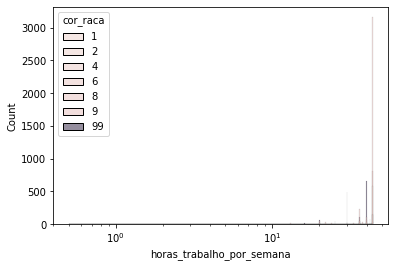

==================Categoria 8


count    3872.000000
mean       41.909478
std         6.126730
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    1002.000000
mean       42.089321
std         5.774202
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 99


count    1569.000000
mean       35.204589
std         6.908168
min         1.000000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    747.000000
mean      41.213521
std        7.318464
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    180.000000
mean      41.947222
std        5.597160
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    41.000000
mean     40.902439
std       8.437431
min       1.000000
25%      44.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    12.000000
mean     35.750000
std      13.798057
min       5.000000
25%      33.250000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


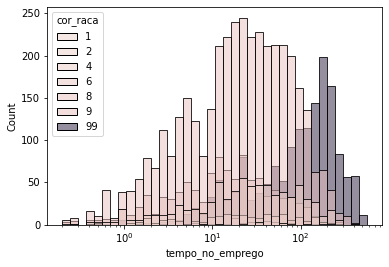

==================Categoria 8


count    3872.000000
mean       38.636157
std        46.834707
min         0.200000
25%         7.100000
50%        20.900000
75%        53.500000
max       352.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    1002.000000
mean       26.356487
std        37.988627
min         0.200000
25%         4.900000
50%        13.800000
75%        31.750000
max       436.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 99


count    1569.000000
mean      132.488400
std       107.074095
min         0.500000
25%        42.100000
50%       114.900000
75%       190.600000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    747.000000
mean      46.335475
std       53.893026
min        0.200000
25%       10.550000
50%       26.200000
75%       62.900000
max      379.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    180.000000
mean      40.851667
std       50.055292
min        0.300000
25%        9.400000
50%       22.150000
75%       55.850000
max      376.700000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     41.000000
mean      47.490244
std       60.013439
min        0.300000
25%       16.200000
50%       26.900000
75%       49.700000
max      263.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     12.000000
mean      72.916667
std       69.196411
min        7.500000
25%       29.350000
50%       49.400000
75%       89.650000
max      230.700000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a cor_raca


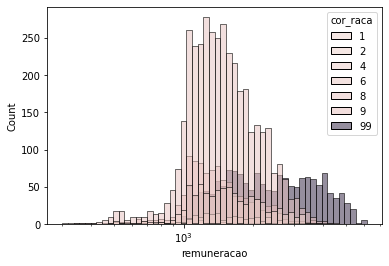

==================Categoria 8


count    3872.000000
mean     1553.521191
std       556.970617
min       326.150000
25%      1160.847500
50%      1431.515000
75%      1824.212500
max      4480.490000
Name: remuneracao, dtype: float64

==================Categoria 9


count    1002.000000
mean     1465.981078
std       525.318491
min       343.840000
25%      1115.985000
50%      1336.920000
75%      1693.652500
max      3911.050000
Name: remuneracao, dtype: float64

==================Categoria 99


count    1569.000000
mean     2554.218260
std      1155.214539
min       828.610000
25%      1585.430000
50%      2297.590000
75%      3398.610000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 2


count     747.000000
mean     1643.941539
std       619.321501
min       301.430000
25%      1183.840000
50%      1503.080000
75%      1980.390000
max      4176.580000
Name: remuneracao, dtype: float64

==================Categoria 4


count     180.000000
mean     1616.069056
std       610.738546
min       488.960000
25%      1208.897500
50%      1443.800000
75%      1922.370000
max      3876.690000
Name: remuneracao, dtype: float64

==================Categoria 6


count      41.000000
mean     1508.133659
std       611.181662
min       549.390000
25%      1080.350000
50%      1306.420000
75%      1753.120000
max      3439.710000
Name: remuneracao, dtype: float64

==================Categoria 1


count      12.000000
mean     1590.483333
std       770.211685
min       986.550000
25%      1209.350000
50%      1330.525000
75%      1600.955000
max      3724.680000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a cor_raca


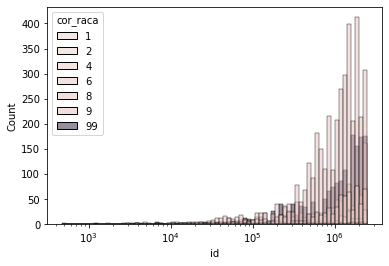

==================Categoria 8


count    3.872000e+03
mean     1.193166e+06
std      6.554839e+05
min      4.770000e+02
25%      6.347085e+05
50%      1.210618e+06
75%      1.736737e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 9


count    1.002000e+03
mean     1.162917e+06
std      7.956777e+05
min      3.360000e+03
25%      3.521698e+05
50%      1.142630e+06
75%      1.878783e+06
max      2.457804e+06
Name: id, dtype: float64

==================Categoria 99


count    1.569000e+03
mean     1.286209e+06
std      7.161474e+05
min      1.187000e+03
25%      7.136220e+05
50%      1.291766e+06
75%      1.861788e+06
max      2.455152e+06
Name: id, dtype: float64

==================Categoria 2


count    7.470000e+02
mean     1.123584e+06
std      7.265039e+05
min      3.185000e+03
25%      4.809900e+05
50%      1.152992e+06
75%      1.747582e+06
max      2.437366e+06
Name: id, dtype: float64

==================Categoria 4


count    1.800000e+02
mean     1.177962e+06
std      7.892222e+05
min      3.660000e+03
25%      3.035398e+05
50%      1.297304e+06
75%      1.790395e+06
max      2.417408e+06
Name: id, dtype: float64

==================Categoria 6


count    4.100000e+01
mean     9.598457e+05
std      7.628204e+05
min      1.761000e+03
25%      3.191840e+05
50%      7.602630e+05
75%      1.695410e+06
max      2.416691e+06
Name: id, dtype: float64

==================Categoria 1


count    1.200000e+01
mean     1.399896e+06
std      7.572501e+05
min      1.201830e+05
25%      9.978568e+05
50%      1.672477e+06
75%      1.893122e+06
max      2.172930e+06
Name: id, dtype: float64

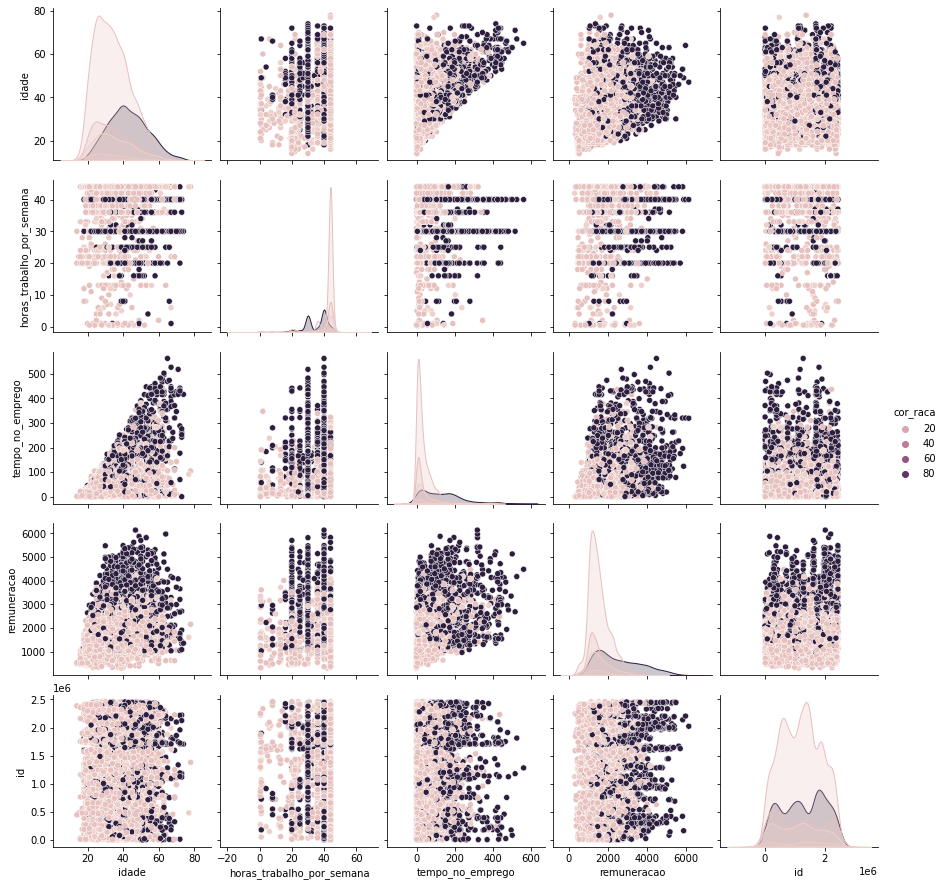

================escolaridade=============


,escolaridade,escolaridade
7,4657,0.627374
9,785,0.105752
5,563,0.075845
6,452,0.060892
4,354,0.047690
...,...,...
2,202,0.027213
3,133,0.017917
1,35,0.004715
10,5,0.000674


Grafico de distribuição de idade com relação a escolaridade


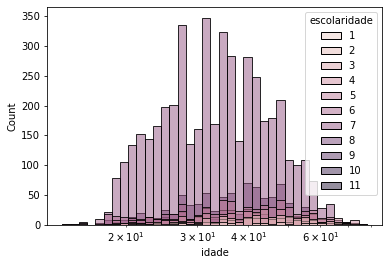

==================Categoria 7


count    4657.000000
mean       34.746189
std        10.328163
min        14.000000
25%        26.000000
50%        33.000000
75%        41.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 8


count    234.000000
mean      30.735043
std        9.658453
min       18.000000
25%       23.000000
50%       29.000000
75%       36.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 2


count    202.000000
mean      43.554455
std       11.323796
min       19.000000
25%       35.000000
50%       43.000000
75%       51.750000
max       70.000000
Name: idade, dtype: float64

==================Categoria 5


count    563.000000
mean      40.291297
std       11.804926
min       15.000000
25%       32.000000
50%       39.000000
75%       48.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 6


count    452.000000
mean      34.765487
std       12.271968
min       15.000000
25%       25.000000
50%       33.000000
75%       43.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 4


count    354.000000
mean      42.344633
std       12.986587
min       14.000000
25%       32.000000
50%       42.000000
75%       51.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 9


count    785.000000
mean      38.705732
std        9.395303
min       20.000000
25%       31.000000
50%       39.000000
75%       45.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 3


count    133.000000
mean      43.165414
std       11.911403
min       21.000000
25%       35.000000
50%       41.000000
75%       52.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 1


count    35.000000
mean     43.657143
std      12.632691
min      19.000000
25%      35.000000
50%      44.000000
75%      52.500000
max      69.000000
Name: idade, dtype: float64

==================Categoria 10


count     5.00000
mean     40.80000
std      12.83355
min      26.00000
25%      30.00000
50%      41.00000
75%      53.00000
max      54.00000
Name: idade, dtype: float64

==================Categoria 11


count     3.000000
mean     33.333333
std       7.571878
min      28.000000
25%      29.000000
50%      30.000000
75%      36.000000
max      42.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


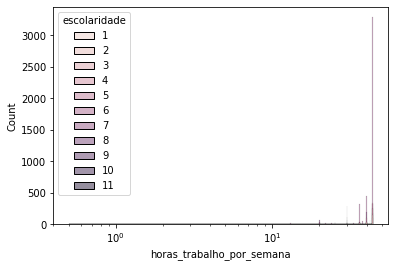

==================Categoria 7


count    4657.000000
mean       41.208289
std         6.002513
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    234.000000
mean      41.042735
std        7.223909
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    202.000000
mean      41.915842
std        4.474121
min        8.000000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    563.000000
mean      40.363233
std        6.401452
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    452.000000
mean      40.247788
std        7.680171
min        1.000000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    354.000000
mean      40.922316
std        6.173395
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    785.000000
mean      35.188535
std        9.996944
min        1.000000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    133.000000
mean      41.609023
std        5.041997
min       20.000000
25%       42.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    35.000000
mean     40.971429
std       6.085111
min      16.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count     5.00000
mean     16.80000
std       9.20326
min       6.00000
25%       8.00000
50%      20.00000
75%      25.00000
max      25.00000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count     3.000000
mean     23.333333
std       2.886751
min      20.000000
25%      22.500000
50%      25.000000
75%      25.000000
max      25.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


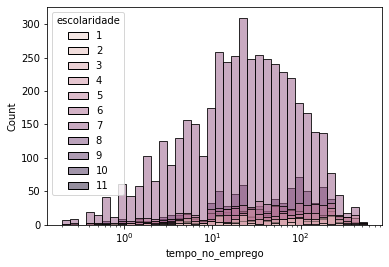

==================Categoria 7


count    4657.000000
mean       47.605046
std        64.281756
min         0.200000
25%         8.100000
50%        22.800000
75%        60.200000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    234.000000
mean      45.498718
std       61.270888
min        0.200000
25%        8.225000
50%       21.000000
75%       54.400000
max      439.000000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    202.000000
mean      78.397030
std       88.898415
min        0.700000
25%       10.975000
50%       33.400000
75%      121.325000
max      425.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    563.000000
mean      82.142984
std       96.341683
min        0.300000
25%       13.450000
50%       40.300000
75%      122.400000
max      517.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    452.000000
mean      59.745796
std       77.212394
min        0.300000
25%       10.600000
50%       32.900000
75%       73.125000
max      465.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    354.000000
mean      95.890395
std      115.041135
min        0.200000
25%       13.975000
50%       43.300000
75%      139.875000
max      496.100000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    785.000000
mean      72.654904
std       73.609342
min        0.200000
25%       14.600000
50%       46.400000
75%      106.900000
max      378.000000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    133.000000
mean      98.215789
std      100.587412
min        1.800000
25%       16.300000
50%       66.900000
75%      160.700000
max      472.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     35.000000
mean      68.991429
std       89.187553
min        0.500000
25%        9.500000
50%       28.300000
75%       82.250000
max      335.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count      5.000000
mean     127.420000
std       96.832598
min       15.900000
25%       28.500000
50%      178.900000
75%      206.900000
max      206.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count     3.000000
mean     48.566667
std      34.017985
min      23.100000
25%      29.250000
50%      35.400000
75%      61.300000
max      87.200000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a escolaridade


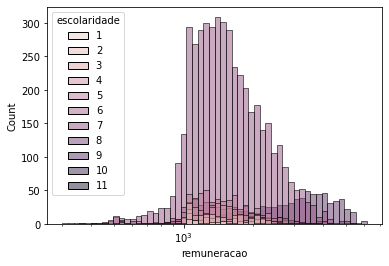

==================Categoria 7


count    4657.000000
mean     1641.287404
std       645.274052
min       326.150000
25%      1185.700000
50%      1480.460000
75%      1939.680000
max      5220.940000
Name: remuneracao, dtype: float64

==================Categoria 8


count     234.000000
mean     1814.437949
std       836.347494
min       419.970000
25%      1211.312500
50%      1596.235000
75%      2219.727500
max      5426.330000
Name: remuneracao, dtype: float64

==================Categoria 2


count     202.000000
mean     1512.136386
std       464.428289
min       636.520000
25%      1117.892500
50%      1389.495000
75%      1794.180000
max      2985.600000
Name: remuneracao, dtype: float64

==================Categoria 5


count     563.000000
mean     1545.813623
std       563.334537
min       407.580000
25%      1163.850000
50%      1421.330000
75%      1767.110000
max      4193.570000
Name: remuneracao, dtype: float64

==================Categoria 6


count     452.000000
mean     1424.231527
std       545.437546
min       466.530000
25%      1086.202500
50%      1319.425000
75%      1679.225000
max      4284.280000
Name: remuneracao, dtype: float64

==================Categoria 4


count     354.000000
mean     1546.407034
std       505.854137
min       301.430000
25%      1179.260000
50%      1451.080000
75%      1801.317500
max      3627.520000
Name: remuneracao, dtype: float64

==================Categoria 9


count     785.000000
mean     3027.926280
std      1206.914572
min       363.000000
25%      2068.430000
50%      3058.500000
75%      3924.670000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 3


count     133.000000
mean     1568.233308
std       487.068507
min       849.300000
25%      1183.270000
50%      1409.950000
75%      1892.230000
max      3245.140000
Name: remuneracao, dtype: float64

==================Categoria 1


count      35.000000
mean     1309.146571
std       372.368269
min       829.590000
25%      1062.220000
50%      1167.830000
75%      1475.345000
max      2558.100000
Name: remuneracao, dtype: float64

==================Categoria 10


count       5.000000
mean     3167.958000
std      1913.081347
min       482.140000
25%      1864.660000
50%      4121.400000
75%      4361.290000
max      5010.300000
Name: remuneracao, dtype: float64

==================Categoria 11


count       3.000000
mean     3138.406667
std       394.191279
min      2734.650000
25%      2946.470000
50%      3158.290000
75%      3340.285000
max      3522.280000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a escolaridade


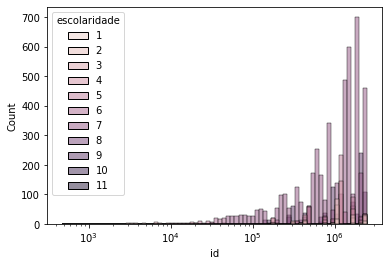

==================Categoria 7


count    4.657000e+03
mean     1.194056e+06
std      7.006611e+05
min      4.760700e+04
25%      5.875870e+05
50%      1.318744e+06
75%      1.808768e+06
max      2.416305e+06
Name: id, dtype: float64

==================Categoria 8


count    2.340000e+02
mean     1.356655e+06
std      7.832436e+05
min      1.437320e+05
25%      6.908660e+05
50%      1.599282e+06
75%      1.966598e+06
max      2.420201e+06
Name: id, dtype: float64

==================Categoria 2


count    2.020000e+02
mean     1.167948e+06
std      6.715647e+05
min      1.187000e+03
25%      9.838915e+05
50%      1.096602e+06
75%      1.695403e+06
max      2.354220e+06
Name: id, dtype: float64

==================Categoria 5


count    5.630000e+02
mean     1.114316e+06
std      5.926209e+05
min      2.061000e+04
25%      7.629115e+05
50%      1.182648e+06
75%      1.222354e+06
max      2.359895e+06
Name: id, dtype: float64

==================Categoria 6


count    4.520000e+02
mean     1.064766e+06
std      6.930523e+05
min      3.277200e+04
25%      4.815975e+05
50%      1.234424e+06
75%      1.740598e+06
max      2.363022e+06
Name: id, dtype: float64

==================Categoria 4


count    3.540000e+02
mean     1.080172e+06
std      6.249901e+05
min      1.085800e+04
25%      4.552332e+05
50%      1.132540e+06
75%      1.155490e+06
max      2.356035e+06
Name: id, dtype: float64

==================Categoria 9


count    7.850000e+02
mean     1.412534e+06
std      7.638884e+05
min      1.482520e+05
25%      7.449430e+05
50%      1.635133e+06
75%      2.067811e+06
max      2.458758e+06
Name: id, dtype: float64

==================Categoria 3


count    1.330000e+02
mean     1.030238e+06
std      5.803708e+05
min      6.384000e+03
25%      7.551180e+05
50%      1.106903e+06
75%      1.115843e+06
max      2.354888e+06
Name: id, dtype: float64

==================Categoria 1


count    3.500000e+01
mean     1.331169e+06
std      6.615771e+05
min      4.770000e+02
25%      1.078308e+06
50%      1.080080e+06
75%      2.153685e+06
max      2.352223e+06
Name: id, dtype: float64

==================Categoria 10


count    5.000000e+00
mean     1.721925e+06
std      6.927994e+05
min      9.807390e+05
25%      9.808190e+05
50%      2.094024e+06
75%      2.094579e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 11


count    3.000000e+00
mean     1.522322e+06
std      8.122056e+05
min      1.031127e+06
25%      1.053574e+06
50%      1.076021e+06
75%      1.767920e+06
max      2.459818e+06
Name: id, dtype: float64

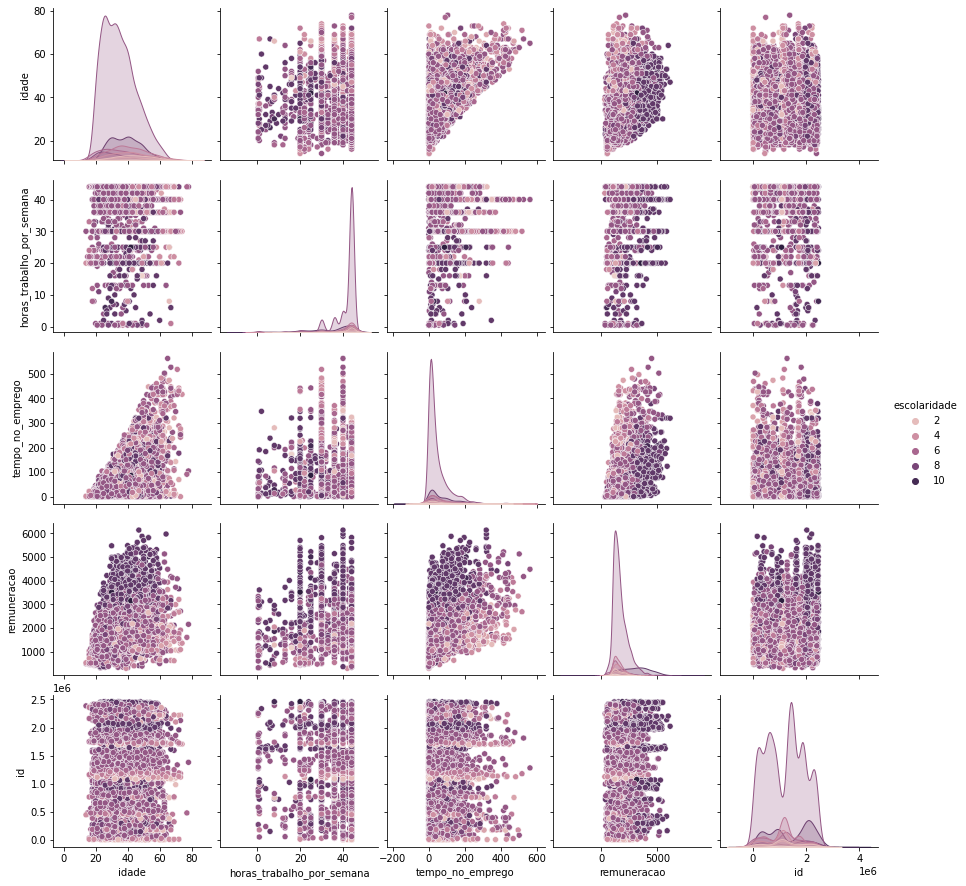

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,7355,0.990839
1,68,0.009161


Grafico de distribuição de idade com relação a portador_de_deficiencia


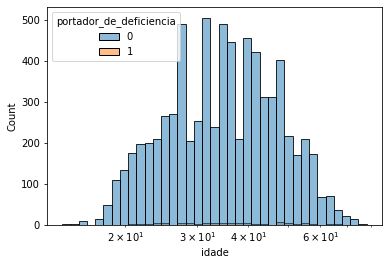

==================Categoria 0


count    7355.000000
mean       36.240517
std        11.061843
min        14.000000
25%        27.000000
50%        35.000000
75%        43.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 1


count    68.000000
mean     38.220588
std      11.495418
min      21.000000
25%      29.000000
50%      37.000000
75%      47.000000
max      65.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


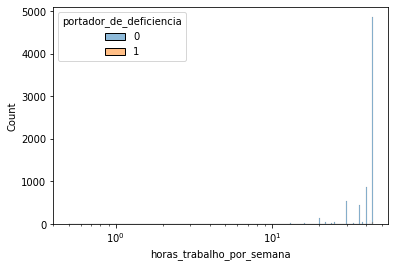

==================Categoria 0


count    7355.000000
mean       40.425425
std         6.969175
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    68.000000
mean     41.132353
std       5.493291
min      20.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


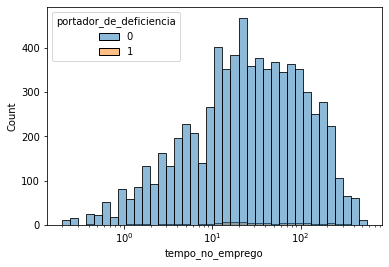

==================Categoria 0


count    7355.000000
mean       57.725656
std        75.228824
min         0.200000
25%         9.900000
50%        26.900000
75%        76.900000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     68.000000
mean      60.272059
std       79.834491
min        0.400000
25%       14.075000
50%       26.100000
75%       75.325000
max      353.600000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a portador_de_deficiencia


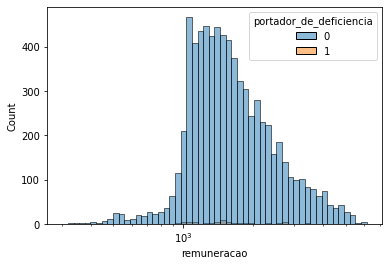

==================Categoria 0


count    7355.000000
mean     1764.684885
std       838.113925
min       301.430000
25%      1198.415000
50%      1515.230000
75%      2081.850000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 1


count      68.000000
mean     1651.386029
std       727.309948
min       535.320000
25%      1111.310000
50%      1474.910000
75%      1903.877500
max      4176.580000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a portador_de_deficiencia


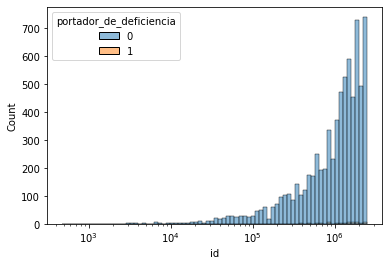

==================Categoria 0


count    7.355000e+03
mean     1.200533e+06
std      7.023894e+05
min      4.770000e+02
25%      5.918960e+05
50%      1.211405e+06
75%      1.792570e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 1


count    6.800000e+01
mean     1.188557e+06
std      6.504280e+05
min      4.692600e+04
25%      6.397225e+05
50%      1.173746e+06
75%      1.735525e+06
max      2.385913e+06
Name: id, dtype: float64

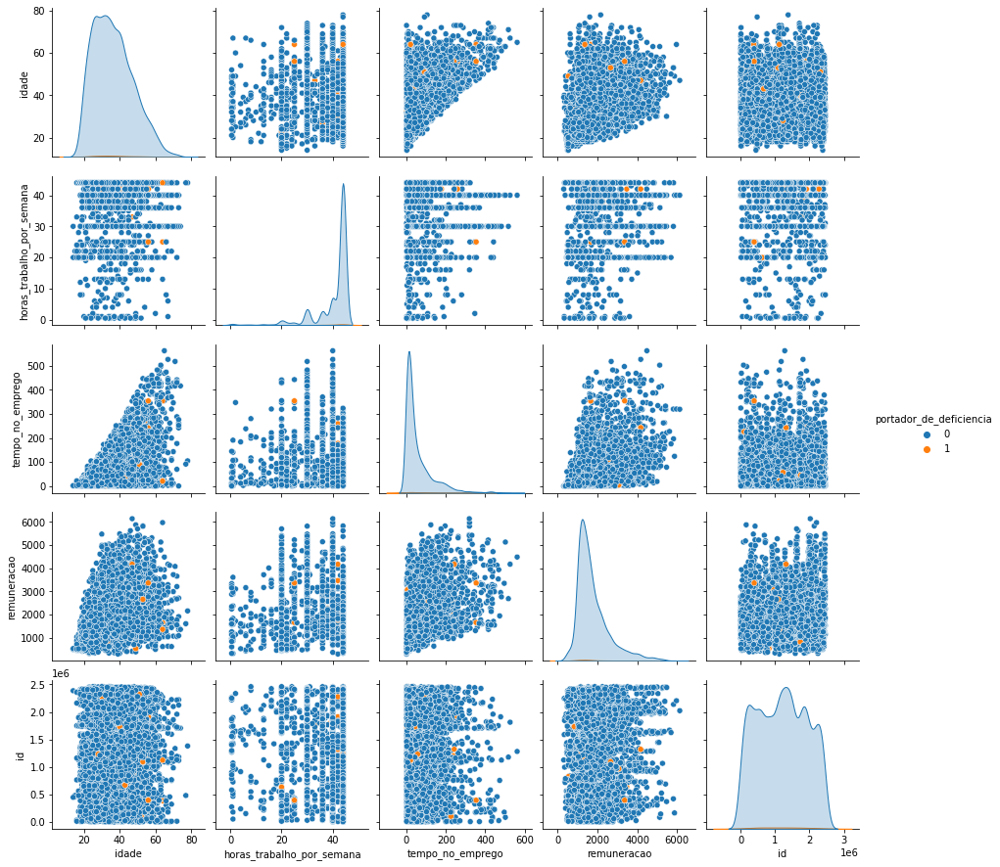

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,1706,0.229826
5,849,0.114374
7,785,0.105752
4,740,0.099690
3,710,0.095649
9,688,0.092685
8,663,0.089317
2,661,0.089048
6,621,0.083659


Grafico de distribuição de idade com relação a tamanho_da_empresa


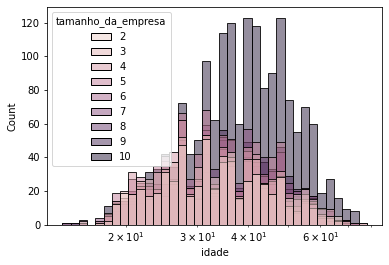

==================Categoria 2


count    661.000000
mean      35.075643
std       11.135407
min       16.000000
25%       26.000000
50%       33.000000
75%       42.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 7


count    785.000000
mean      35.768153
std       11.052969
min       14.000000
25%       27.000000
50%       34.000000
75%       43.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 5


count    849.000000
mean      34.330978
std       10.214561
min       16.000000
25%       26.000000
50%       33.000000
75%       41.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 8


count    663.000000
mean      36.464555
std       11.201729
min       15.000000
25%       28.000000
50%       35.000000
75%       44.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 6


count    621.000000
mean      34.636071
std       10.423744
min       16.000000
25%       27.000000
50%       33.000000
75%       41.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 9


count    688.000000
mean      37.265988
std       10.739358
min       14.000000
25%       29.000000
50%       36.500000
75%       45.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 10


count    1706.000000
mean       39.679953
std        11.165543
min        17.000000
25%        31.000000
50%        39.000000
75%        47.000000
max        74.000000
Name: idade, dtype: float64

==================Categoria 3


count    710.000000
mean      34.466197
std       11.044511
min       17.000000
25%       25.250000
50%       32.000000
75%       41.750000
max       78.000000
Name: idade, dtype: float64

==================Categoria 4


count    740.000000
mean      34.120270
std       10.528156
min       17.000000
25%       26.000000
50%       32.000000
75%       41.000000
max       72.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


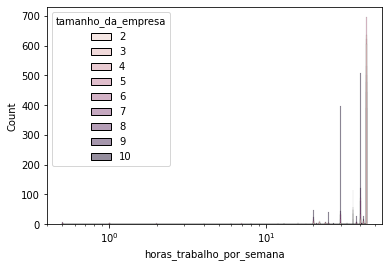

==================Categoria 2


count    661.000000
mean      42.662632
std        5.238229
min        1.000000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    785.000000
mean      40.554777
std        7.226752
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    849.000000
mean      41.428151
std        7.451582
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    663.000000
mean      40.541478
std        7.311489
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    621.000000
mean      41.066828
std        7.387760
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    688.000000
mean      39.837209
std        7.322600
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    1706.000000
mean       37.308324
std         6.710076
min         8.000000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    710.000000
mean      42.898592
std        4.093184
min       13.000000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    740.000000
mean      41.922297
std        6.490107
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


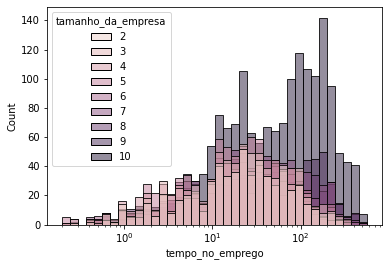

==================Categoria 2


count    661.000000
mean      37.287292
std       46.983066
min        0.300000
25%        8.100000
50%       21.900000
75%       46.900000
max      290.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    785.000000
mean      52.145605
std       66.648670
min        0.200000
25%        9.200000
50%       24.900000
75%       66.100000
max      465.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    849.000000
mean      36.064311
std       46.232950
min        0.200000
25%        5.900000
50%       19.900000
75%       45.000000
max      346.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    663.000000
mean      62.275716
std       79.022691
min        0.400000
25%        9.250000
50%       29.100000
75%       83.900000
max      429.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    621.000000
mean      41.272625
std       59.529052
min        0.200000
25%        7.100000
50%       19.900000
75%       51.400000
max      517.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    688.000000
mean      74.309884
std       83.087059
min        0.300000
25%       12.775000
50%       41.050000
75%      118.900000
max      481.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count    1706.000000
mean       94.591794
std       100.183369
min         0.200000
25%        16.975000
50%        59.850000
75%       148.100000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    710.000000
mean      39.690141
std       50.796401
min        0.200000
25%        7.825000
50%       20.900000
75%       49.900000
max      352.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    740.000000
mean      33.612162
std       40.779488
min        0.200000
25%        5.800000
50%       18.850000
75%       47.900000
max      282.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a tamanho_da_empresa


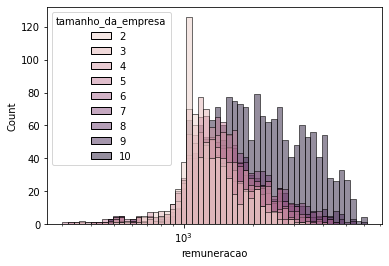

==================Categoria 2


count     661.000000
mean     1321.435189
std       405.734677
min       394.610000
25%      1052.690000
50%      1191.540000
75%      1498.930000
max      3149.050000
Name: remuneracao, dtype: float64

==================Categoria 7


count     785.000000
mean     1725.870484
std       703.101643
min       386.450000
25%      1246.760000
50%      1549.950000
75%      2043.680000
max      4420.170000
Name: remuneracao, dtype: float64

==================Categoria 5


count     849.000000
mean     1542.858622
std       559.689313
min       301.430000
25%      1170.380000
50%      1412.200000
75%      1775.010000
max      4145.600000
Name: remuneracao, dtype: float64

==================Categoria 8


count     663.000000
mean     1798.812323
std       741.413622
min       410.210000
25%      1317.795000
50%      1608.190000
75%      2129.385000
max      5374.610000
Name: remuneracao, dtype: float64

==================Categoria 6


count     621.000000
mean     1635.090467
std       638.515159
min       327.040000
25%      1178.200000
50%      1453.150000
75%      1971.100000
max      4309.510000
Name: remuneracao, dtype: float64

==================Categoria 9


count     688.000000
mean     1882.411177
std       869.988403
min       477.150000
25%      1309.032500
50%      1657.730000
75%      2191.605000
max      6141.800000
Name: remuneracao, dtype: float64

==================Categoria 10


count    1706.000000
mean     2329.830996
std      1107.775767
min       473.940000
25%      1450.915000
50%      2057.775000
75%      3030.040000
max      5974.310000
Name: remuneracao, dtype: float64

==================Categoria 3


count     710.000000
mean     1394.707070
std       444.282123
min       343.840000
25%      1112.112500
50%      1280.010000
75%      1599.847500
max      3352.610000
Name: remuneracao, dtype: float64

==================Categoria 4


count     740.000000
mean     1466.690919
std       479.489168
min       326.150000
25%      1137.752500
50%      1381.105000
75%      1689.200000
max      4082.040000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a tamanho_da_empresa


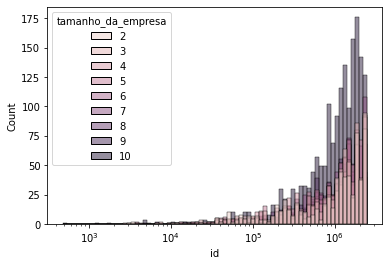

==================Categoria 2


count    6.610000e+02
mean     1.193605e+06
std      7.716668e+05
min      3.185000e+03
25%      3.964620e+05
50%      1.214509e+06
75%      1.868107e+06
max      2.435874e+06
Name: id, dtype: float64

==================Categoria 7


count    7.850000e+02
mean     1.271346e+06
std      7.137112e+05
min      4.953000e+03
25%      6.243470e+05
50%      1.269651e+06
75%      1.916003e+06
max      2.458758e+06
Name: id, dtype: float64

==================Categoria 5


count    8.490000e+02
mean     1.209802e+06
std      7.279601e+05
min      3.679000e+03
25%      5.454820e+05
50%      1.247600e+06
75%      1.862742e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 8


count    6.630000e+02
mean     1.166799e+06
std      6.592859e+05
min      1.761000e+03
25%      6.287870e+05
50%      1.171375e+06
75%      1.697790e+06
max      2.457533e+06
Name: id, dtype: float64

==================Categoria 6


count    6.210000e+02
mean     1.196694e+06
std      6.926638e+05
min      1.092300e+04
25%      6.273100e+05
50%      1.189235e+06
75%      1.730620e+06
max      2.455152e+06
Name: id, dtype: float64

==================Categoria 9


count    6.880000e+02
mean     1.165209e+06
std      6.308765e+05
min      4.770000e+02
25%      6.139578e+05
50%      1.198762e+06
75%      1.701321e+06
max      2.452544e+06
Name: id, dtype: float64

==================Categoria 10


count    1.706000e+03
mean     1.230771e+06
std      6.606408e+05
min      1.187000e+03
25%      6.796065e+05
50%      1.219060e+06
75%      1.772507e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 3


count    7.100000e+02
mean     1.181080e+06
std      7.362702e+05
min      2.662000e+03
25%      5.051820e+05
50%      1.228614e+06
75%      1.844426e+06
max      2.431983e+06
Name: id, dtype: float64

==================Categoria 4


count    7.400000e+02
mean     1.135112e+06
std      7.511196e+05
min      3.660000e+03
25%      4.426278e+05
50%      1.107640e+06
75%      1.790338e+06
max      2.458471e+06
Name: id, dtype: float64

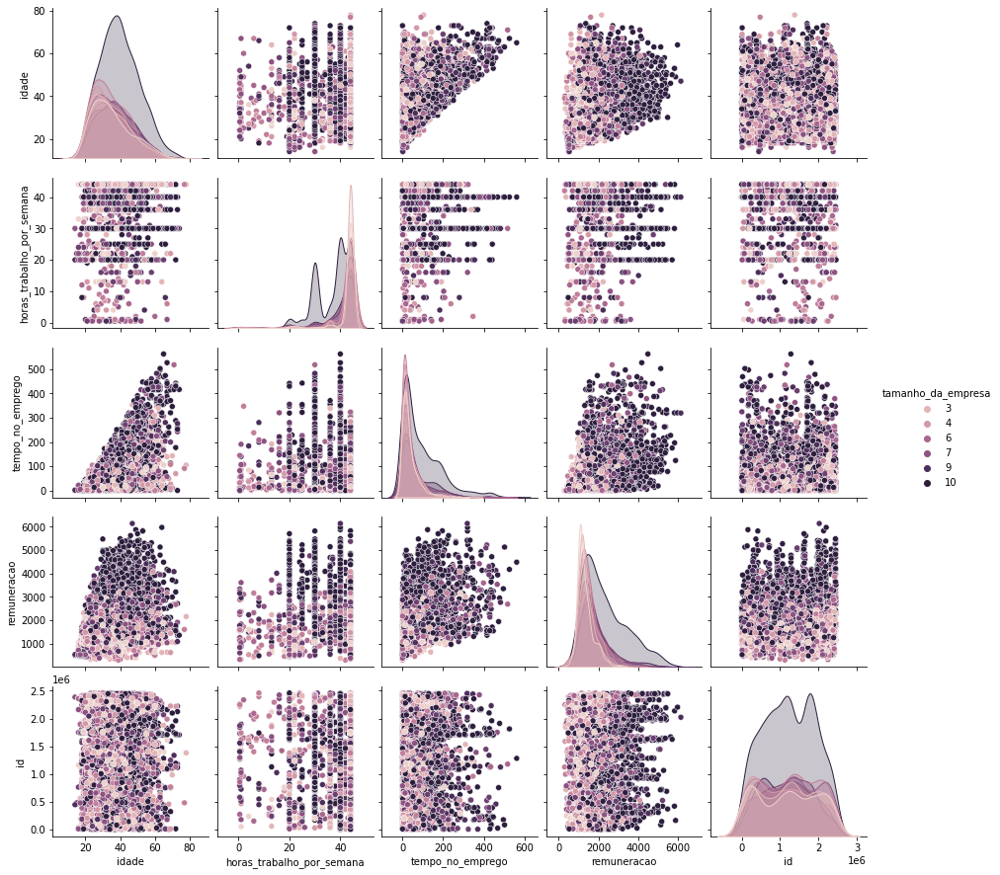

In [ ]:
def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = normais.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = normais.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([normais[i].value_counts(), normais[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(normais, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()
  

================sexo=============


,sexo,sexo
1,1750,0.568736
2,1327,0.431264


Grafico de distribuição de idade com relação a sexo


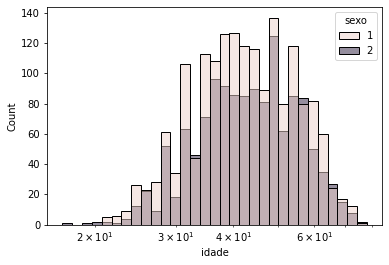

==================Categoria 1


count    1750.000000
mean       43.596571
std        10.906096
min        21.000000
25%        35.000000
50%        42.500000
75%        51.000000
max        76.000000
Name: idade, dtype: float64

==================Categoria 2


count    1327.000000
mean       44.222306
std        10.750405
min        17.000000
25%        36.000000
50%        44.000000
75%        52.000000
max        78.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


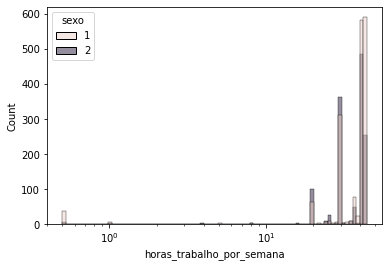

==================Categoria 1


count    1750.000000
mean       37.157143
std         8.856934
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    1327.000000
mean       35.320271
std         8.070737
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


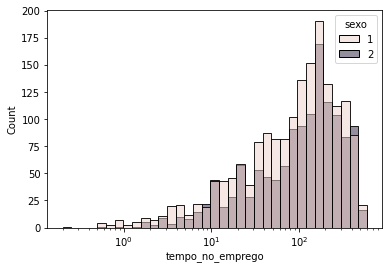

==================Categoria 1


count    1750.000000
mean      138.400514
std       122.582962
min         0.200000
25%        36.800000
50%       108.050000
75%       200.575000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    1327.000000
mean      153.278523
std       126.070523
min         0.500000
25%        43.400000
50%       128.500000
75%       221.650000
max       556.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a sexo


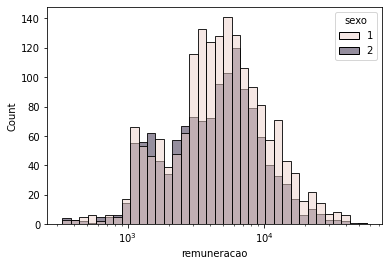

==================Categoria 1


count     1750.00000
mean      6368.36544
std       5751.11495
min        330.73000
25%       2916.87750
50%       4774.12500
75%       7791.12500
max      55122.47000
Name: remuneracao, dtype: float64

==================Categoria 2


count     1327.000000
mean      5658.272389
std       5105.770604
min        331.300000
25%       2378.015000
50%       4529.900000
75%       7117.280000
max      56849.230000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a sexo


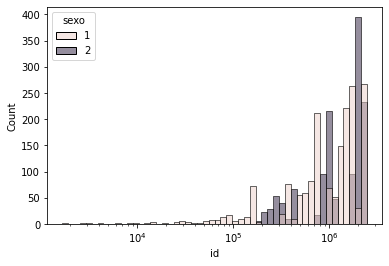

==================Categoria 1


count    1.750000e+03
mean     1.197808e+06
std      6.891838e+05
min      1.671000e+03
25%      6.507225e+05
50%      1.296702e+06
75%      1.652370e+06
max      2.351370e+06
Name: id, dtype: float64

==================Categoria 2


count    1.327000e+03
mean     1.459306e+06
std      7.325271e+05
min      1.754180e+05
25%      9.171470e+05
50%      1.803262e+06
75%      2.054215e+06
max      2.459844e+06
Name: id, dtype: float64

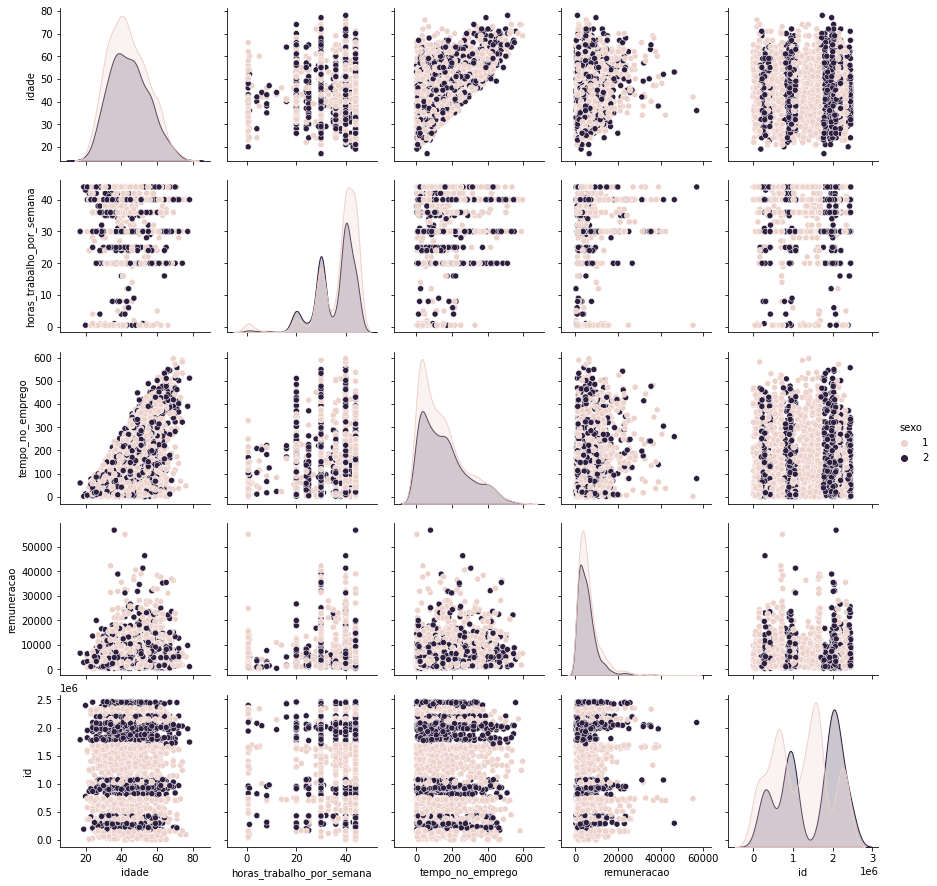

================faixa_etaria=============


,faixa_etaria,faixa_etaria
6,969,0.314917
5,917,0.298018
7,821,0.266818
4,214,0.069548
8,106,0.034449
3,49,0.015925
2,1,0.000325


Grafico de distribuição de idade com relação a faixa_etaria


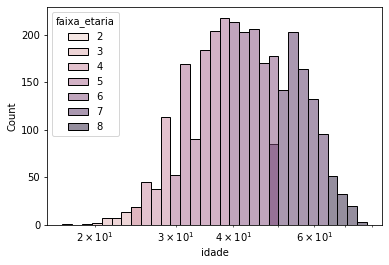

==================Categoria 7


count    821.000000
mean      55.694275
std        4.083617
min       50.000000
25%       52.000000
50%       55.000000
75%       59.000000
max       64.000000
Name: idade, dtype: float64

==================Categoria 6


count    969.000000
mean      44.310630
std        2.866431
min       40.000000
25%       42.000000
50%       44.000000
75%       47.000000
max       49.000000
Name: idade, dtype: float64

==================Categoria 5


count    917.000000
mean      34.962923
std        2.783047
min       30.000000
25%       33.000000
50%       35.000000
75%       37.000000
max       39.000000
Name: idade, dtype: float64

==================Categoria 4


count    214.000000
mean      27.462617
std        1.362132
min       25.000000
25%       26.000000
50%       28.000000
75%       29.000000
max       29.000000
Name: idade, dtype: float64

==================Categoria 8


count    106.000000
mean      68.349057
std        3.008060
min       65.000000
25%       66.000000
50%       68.000000
75%       70.000000
max       78.000000
Name: idade, dtype: float64

==================Categoria 3


count    49.000000
mean     22.755102
std       1.331206
min      19.000000
25%      22.000000
50%      23.000000
75%      24.000000
max      24.000000
Name: idade, dtype: float64

==================Categoria 2


count     1.0
mean     17.0
std       NaN
min      17.0
25%      17.0
50%      17.0
75%      17.0
max      17.0
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


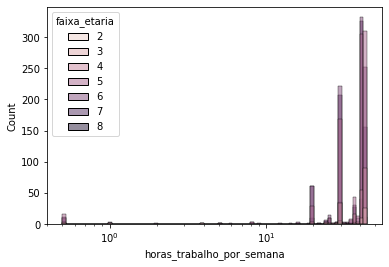

==================Categoria 7


count    821.000000
mean      35.404994
std        8.583172
min        0.500000
25%       30.000000
50%       40.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    969.000000
mean      35.987100
std        8.569061
min        0.500000
25%       30.000000
50%       40.000000
75%       42.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    917.000000
mean      37.413304
std        8.354480
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    214.000000
mean      38.100467
std        8.263441
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    106.000000
mean      34.551887
std        7.713911
min        0.500000
25%       30.000000
50%       38.500000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    49.000000
mean     36.775510
std      12.039891
min       0.500000
25%      36.000000
50%      42.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count     1.0
mean     30.0
std       NaN
min      30.0
25%      30.0
50%      30.0
75%      30.0
max      30.0
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


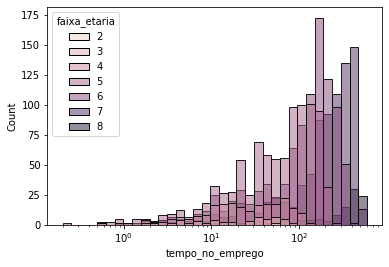

==================Categoria 7


count    821.000000
mean     235.498904
std      136.736309
min        0.500000
25%      129.300000
50%      237.900000
75%      350.600000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    969.000000
mean     140.676574
std       90.893575
min        0.500000
25%       64.900000
50%      140.900000
75%      201.700000
max      448.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    917.000000
mean      77.473937
std       58.348498
min        0.200000
25%       24.600000
50%       67.700000
75%      119.300000
max      251.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    214.000000
mean      35.693925
std       29.282901
min        0.900000
25%       11.550000
50%       25.350000
75%       54.975000
max      121.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    106.00000
mean     337.30000
std      163.46121
min        2.10000
25%      208.30000
50%      381.90000
75%      468.52500
max      596.50000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    49.000000
mean     29.500000
std      23.880405
min       0.600000
25%       7.300000
50%      25.400000
75%      47.900000
max      76.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     1.0
mean     59.9
std       NaN
min      59.9
25%      59.9
50%      59.9
75%      59.9
max      59.9
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a faixa_etaria


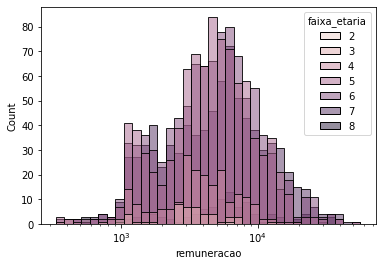

==================Categoria 7


count      821.000000
mean      6882.907527
std       6366.705445
min        363.330000
25%       2430.700000
50%       5201.690000
75%       8762.730000
max      46377.980000
Name: remuneracao, dtype: float64

==================Categoria 6


count      969.000000
mean      6147.144118
std       5550.454006
min        331.300000
25%       2685.670000
50%       4833.990000
75%       7615.300000
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 5


count      917.000000
mean      5598.145267
std       4664.075386
min        330.730000
25%       2761.850000
50%       4585.640000
75%       7166.750000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 4


count      214.000000
mean      4381.848925
std       2905.060870
min        427.960000
25%       2686.710000
50%       3711.960000
75%       5412.697500
max      19944.510000
Name: remuneracao, dtype: float64

==================Categoria 8


count      106.000000
mean      7495.280849
std       7479.251535
min        519.360000
25%       3046.565000
50%       5597.745000
75%       8314.212500
max      36859.680000
Name: remuneracao, dtype: float64

==================Categoria 3


count       49.000000
mean      3540.296939
std       2270.916868
min        342.950000
25%       2513.070000
50%       3175.670000
75%       4281.630000
max      13553.440000
Name: remuneracao, dtype: float64

==================Categoria 2


count       1.00
mean     6528.05
std          NaN
min      6528.05
25%      6528.05
50%      6528.05
75%      6528.05
max      6528.05
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a faixa_etaria


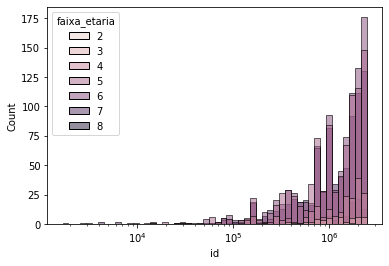

==================Categoria 7


count    8.210000e+02
mean     1.289048e+06
std      7.210979e+05
min      2.640000e+03
25%      7.142970e+05
50%      1.293919e+06
75%      2.008897e+06
max      2.459161e+06
Name: id, dtype: float64

==================Categoria 6


count    9.690000e+02
mean     1.340095e+06
std      7.254404e+05
min      1.671000e+03
25%      7.224690e+05
50%      1.435308e+06
75%      2.031772e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 5


count    9.170000e+02
mean     1.293773e+06
std      7.207028e+05
min      1.484800e+04
25%      7.022160e+05
50%      1.309476e+06
75%      2.001052e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 4


count    2.140000e+02
mean     1.315918e+06
std      7.010480e+05
min      4.765900e+04
25%      7.021032e+05
50%      1.457025e+06
75%      2.015185e+06
max      2.378674e+06
Name: id, dtype: float64

==================Categoria 8


count    1.060000e+02
mean     1.369539e+06
std      7.053183e+05
min      9.681000e+03
25%      8.209198e+05
50%      1.617570e+06
75%      1.997225e+06
max      2.450172e+06
Name: id, dtype: float64

==================Categoria 3


count    4.900000e+01
mean     1.241865e+06
std      6.928579e+05
min      1.514800e+04
25%      7.090100e+05
50%      1.229839e+06
75%      1.818737e+06
max      2.451626e+06
Name: id, dtype: float64

==================Categoria 2


count          1.0
mean     1783800.0
std            NaN
min      1783800.0
25%      1783800.0
50%      1783800.0
75%      1783800.0
max      1783800.0
Name: id, dtype: float64

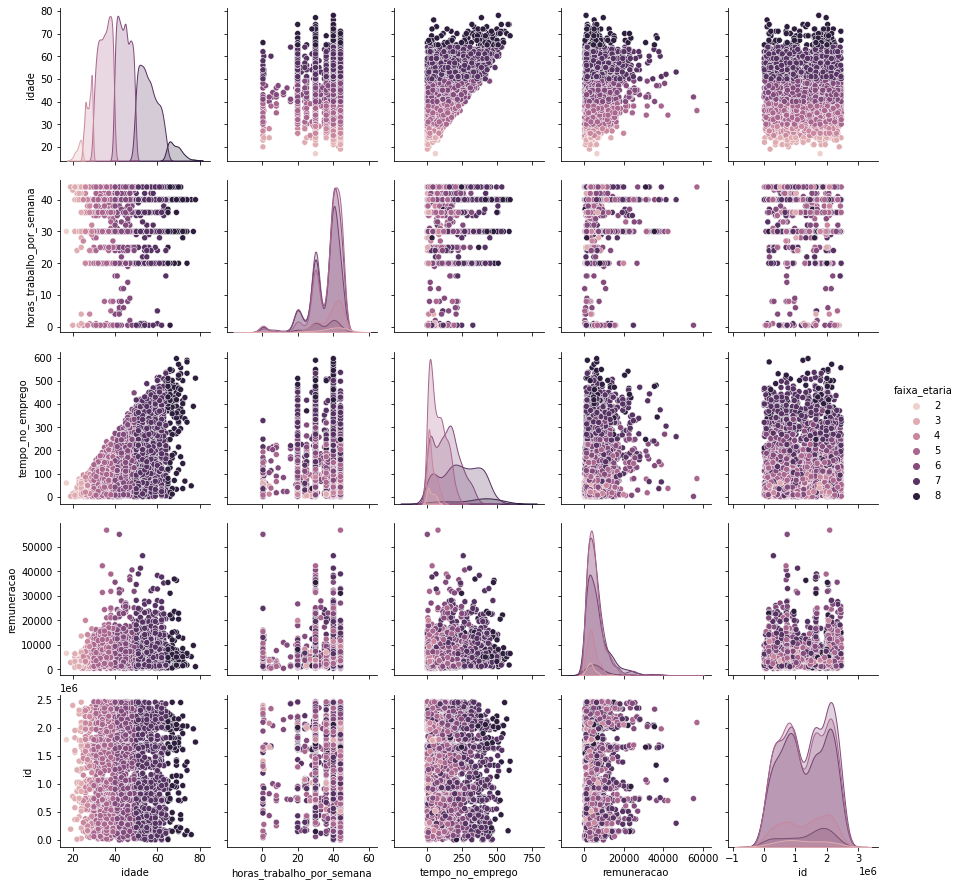

================cor_raca=============


,cor_raca,cor_raca
99,1886,0.612935
8,738,0.239844
2,277,0.090023
9,136,0.044199
4,25,0.008125
6,11,0.003575
1,4,0.001300


Grafico de distribuição de idade com relação a cor_raca


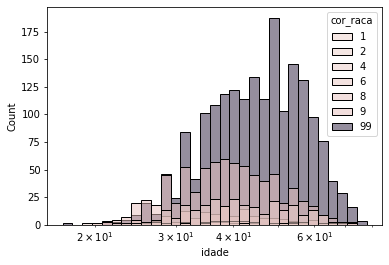

==================Categoria 99


count    1886.000000
mean       46.066808
std        10.715308
min        17.000000
25%        38.000000
50%        46.000000
75%        54.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 8


count    738.000000
mean      39.798103
std        9.902984
min       20.000000
25%       32.000000
50%       39.000000
75%       46.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 4


count    25.000000
mean     42.440000
std      10.312129
min      27.000000
25%      37.000000
50%      41.000000
75%      45.000000
max      67.000000
Name: idade, dtype: float64

==================Categoria 2


count    277.000000
mean      42.433213
std       10.698099
min       19.000000
25%       34.000000
50%       41.000000
75%       50.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 9


count    136.000000
mean      39.117647
std        9.506379
min       21.000000
25%       32.750000
50%       38.000000
75%       44.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 6


count    11.000000
mean     40.000000
std       8.461678
min      28.000000
25%      35.000000
50%      39.000000
75%      42.000000
max      55.000000
Name: idade, dtype: float64

==================Categoria 1


count     4.000000
mean     37.250000
std      12.065792
min      24.000000
25%      29.250000
50%      37.000000
75%      45.000000
max      51.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


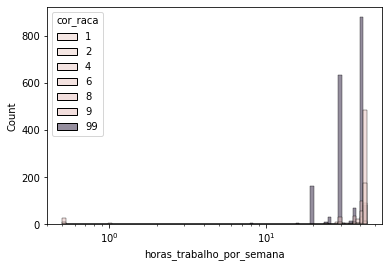

==================Categoria 99


count    1886.000000
mean       34.469777
std         6.866664
min         4.000000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    738.000000
mean      39.206640
std       10.297688
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    25.000000
mean     39.500000
std       8.904587
min       0.500000
25%      38.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    277.000000
mean      39.416968
std        9.996664
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    136.000000
mean      40.669118
std        7.842718
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    11.000000
mean     37.318182
std      13.134445
min       0.500000
25%      36.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     4.000000
mean     25.750000
std      18.553975
min       1.000000
25%      16.750000
50%      31.000000
75%      40.000000
max      40.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


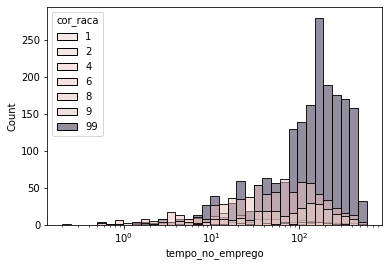

==================Categoria 99


count    1886.000000
mean      179.140403
std       127.538714
min         0.200000
25%        77.500000
50%       160.900000
75%       261.550000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    738.000000
mean      85.135908
std       90.400972
min        0.500000
25%       20.500000
50%       55.900000
75%      119.875000
max      508.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count     25.000000
mean      94.132000
std       75.965385
min        1.800000
25%       22.900000
50%       89.900000
75%      145.900000
max      248.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    277.000000
mean     120.049458
std      109.796254
min        0.700000
25%       35.600000
50%       94.900000
75%      173.300000
max      545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    136.000000
mean      55.491912
std       89.385046
min        0.500000
25%        9.075000
50%       20.300000
75%       53.025000
max      556.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     11.000000
mean     115.690909
std       66.627043
min        1.900000
25%       65.300000
50%      122.400000
75%      152.900000
max      247.100000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      4.000000
mean     121.475000
std      151.648088
min        6.400000
25%       41.050000
50%       67.750000
75%      148.175000
max      344.000000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a cor_raca


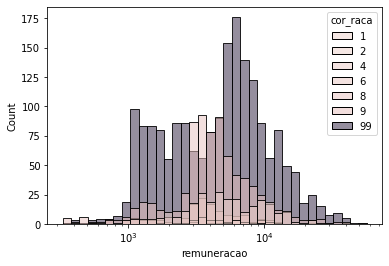

==================Categoria 99


count     1886.00000
mean      6407.89720
std       5838.55777
min        331.30000
25%       2226.27000
50%       5197.95500
75%       8074.93750
max      46377.98000
Name: remuneracao, dtype: float64

==================Categoria 8


count      738.000000
mean      5238.101098
std       4494.756309
min        330.730000
25%       3070.787500
50%       4115.960000
75%       5962.835000
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 4


count       25.000000
mean      5484.040400
std       3249.575134
min        519.360000
25%       3514.800000
50%       3943.280000
75%       8838.230000
max      11999.580000
Name: remuneracao, dtype: float64

==================Categoria 2


count      277.000000
mean      6717.066282
std       6033.285806
min        430.870000
25%       3278.680000
50%       4959.330000
75%       8875.310000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 9


count      136.000000
mean      4586.136985
std       3955.932003
min        342.950000
25%       2881.982500
50%       3675.825000
75%       5197.120000
max      27909.880000
Name: remuneracao, dtype: float64

==================Categoria 6


count      11.000000
mean     4752.158182
std      2274.259956
min      1661.220000
25%      3056.550000
50%      4362.460000
75%      6124.135000
max      8963.400000
Name: remuneracao, dtype: float64

==================Categoria 1


count        4.00000
mean      7109.37750
std       2012.95505
min       5880.50000
25%       5933.09000
50%       6228.80500
75%       7405.09250
max      10099.40000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a cor_raca


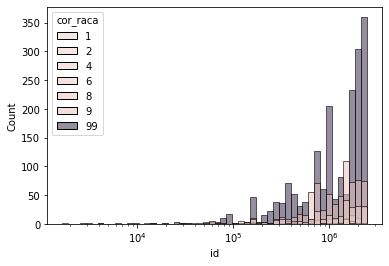

==================Categoria 99


count    1.886000e+03
mean     1.351509e+06
std      7.432216e+05
min      2.640000e+03
25%      7.184860e+05
50%      1.413450e+06
75%      2.047676e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 8


count    7.380000e+02
mean     1.240664e+06
std      6.409419e+05
min      4.272000e+03
25%      7.051878e+05
50%      1.262708e+06
75%      1.674808e+06
max      2.458009e+06
Name: id, dtype: float64

==================Categoria 4


count    2.500000e+01
mean     1.330054e+06
std      6.839118e+05
min      7.632800e+04
25%      1.085615e+06
50%      1.513152e+06
75%      1.675787e+06
max      2.347672e+06
Name: id, dtype: float64

==================Categoria 2


count    2.770000e+02
mean     1.239332e+06
std      7.096255e+05
min      1.514800e+04
25%      6.708990e+05
50%      1.369015e+06
75%      1.690543e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 9


count    1.360000e+02
mean     1.283487e+06
std      7.846810e+05
min      1.671000e+03
25%      6.169438e+05
50%      1.365816e+06
75%      2.022000e+06
max      2.447959e+06
Name: id, dtype: float64

==================Categoria 6


count    1.100000e+01
mean     1.179445e+06
std      8.040358e+05
min      1.632910e+05
25%      5.610100e+05
50%      9.217830e+05
75%      1.851581e+06
max      2.296833e+06
Name: id, dtype: float64

==================Categoria 1


count    4.000000e+00
mean     1.008239e+06
std      6.406954e+05
min      1.723560e+05
25%      7.261320e+05
50%      1.088161e+06
75%      1.370268e+06
max      1.684278e+06
Name: id, dtype: float64

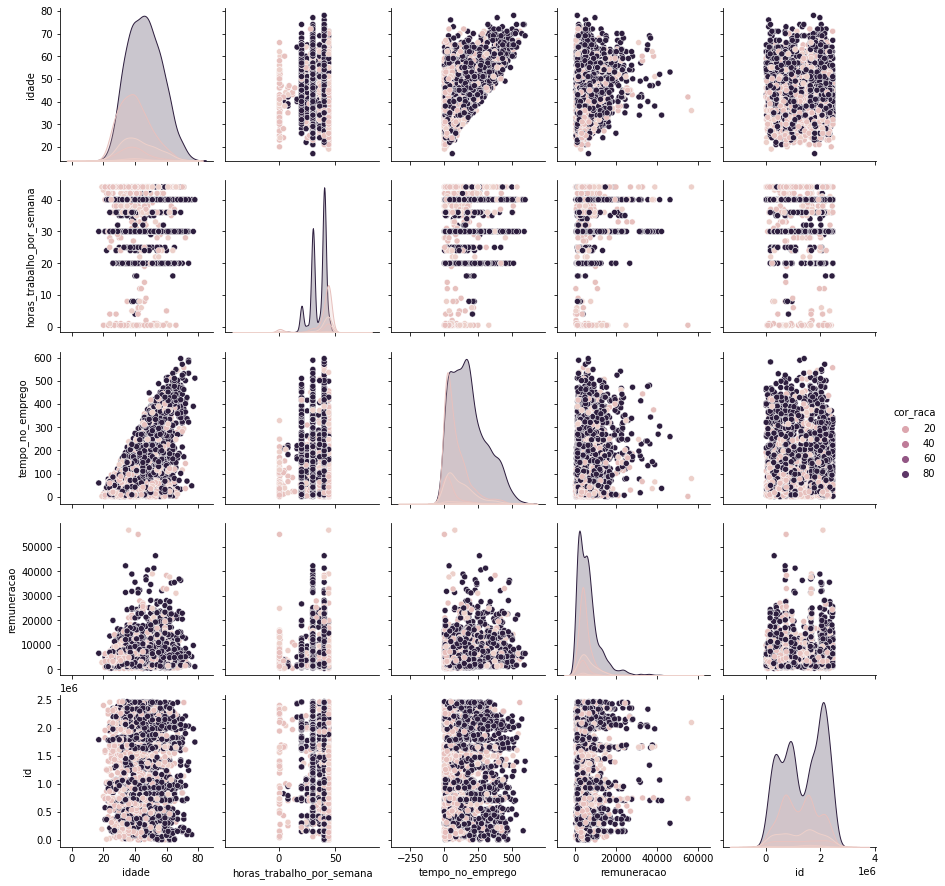

================escolaridade=============


,escolaridade,escolaridade
9,1732,0.562886
7,960,0.311992
8,96,0.031199
5,71,0.023074
10,67,0.021774
...,...,...
4,38,0.012350
11,38,0.012350
3,16,0.005200
2,16,0.005200


Grafico de distribuição de idade com relação a escolaridade


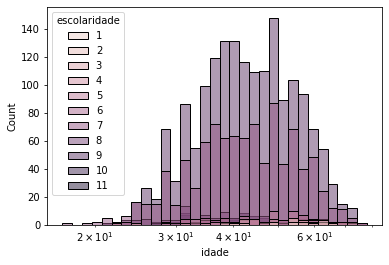

==================Categoria 9


count    1732.000000
mean       43.976328
std        10.521910
min        21.000000
25%        36.000000
50%        43.000000
75%        51.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 7


count    960.000000
mean      43.367708
std       10.947652
min       17.000000
25%       35.000000
50%       42.500000
75%       51.000000
max       76.000000
Name: idade, dtype: float64

==================Categoria 4


count    38.000000
mean     50.973684
std      12.491049
min      22.000000
25%      44.000000
50%      51.500000
75%      60.750000
max      71.000000
Name: idade, dtype: float64

==================Categoria 10


count    67.000000
mean     42.492537
std       9.130988
min      27.000000
25%      35.000000
50%      42.000000
75%      47.500000
max      68.000000
Name: idade, dtype: float64

==================Categoria 11


count    38.000000
mean     41.526316
std      10.263388
min      27.000000
25%      32.500000
50%      39.500000
75%      48.250000
max      62.000000
Name: idade, dtype: float64

==================Categoria 8


count    96.000000
mean     40.708333
std      12.186202
min      21.000000
25%      31.750000
50%      38.500000
75%      48.250000
max      68.000000
Name: idade, dtype: float64

==================Categoria 5


count    71.000000
mean     47.253521
std      10.614974
min      24.000000
25%      39.000000
50%      49.000000
75%      54.000000
max      70.000000
Name: idade, dtype: float64

==================Categoria 6


count    41.000000
mean     42.878049
std      14.522732
min      22.000000
25%      32.000000
50%      40.000000
75%      54.000000
max      78.000000
Name: idade, dtype: float64

==================Categoria 3


count    16.000000
mean     50.687500
std       9.924507
min      39.000000
25%      42.750000
50%      48.000000
75%      58.250000
max      65.000000
Name: idade, dtype: float64

==================Categoria 2


count    16.000000
mean     54.750000
std       7.132087
min      40.000000
25%      52.750000
50%      54.500000
75%      59.750000
max      66.000000
Name: idade, dtype: float64

==================Categoria 1


count     2.000000
mean     53.500000
std       0.707107
min      53.000000
25%      53.250000
50%      53.500000
75%      53.750000
max      54.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


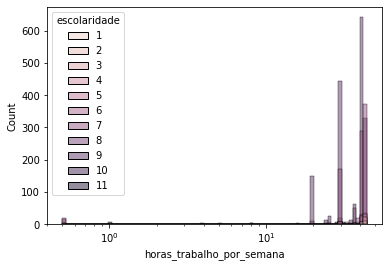

==================Categoria 9


count    1732.000000
mean       35.135970
std         8.533372
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    960.000000
mean      37.984375
std        8.351491
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    38.000000
mean     40.526316
std       5.129337
min      30.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    67.000000
mean     36.410448
std       9.196477
min       0.500000
25%      31.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count    38.000000
mean     34.500000
std       7.766004
min       8.000000
25%      30.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    96.000000
mean     37.442708
std       7.983163
min       0.500000
25%      30.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    71.000000
mean     38.887324
std       8.213750
min       0.500000
25%      40.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    41.000000
mean     37.597561
std      11.800540
min       0.500000
25%      36.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    16.000000
mean     39.937500
std       5.297405
min      25.000000
25%      40.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    16.000000
mean     41.500000
std       5.033223
min      24.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     2.000000
mean     42.000000
std       2.828427
min      40.000000
25%      41.000000
50%      42.000000
75%      43.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


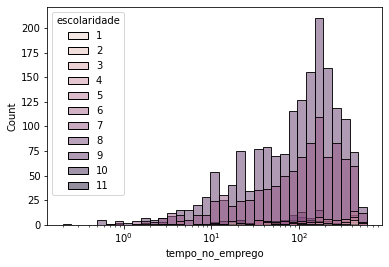

==================Categoria 9


count    1732.000000
mean      140.371247
std       117.513956
min         0.200000
25%        40.200000
50%       116.700000
75%       203.500000
max       581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    960.000000
mean     150.081771
std      127.355452
min        0.700000
25%       40.425000
50%      121.650000
75%      224.375000
max      596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count     38.000000
mean     221.281579
std      174.858741
min        1.900000
25%       46.025000
50%      171.850000
75%      375.825000
max      530.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count     67.000000
mean     116.788060
std      107.625906
min        0.900000
25%       43.000000
50%       82.900000
75%      140.500000
max      472.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count     38.000000
mean      77.668421
std       92.965806
min        0.900000
25%       21.425000
50%       46.100000
75%       95.150000
max      429.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     96.000000
mean     139.280208
std      134.464863
min        1.800000
25%       32.600000
50%      105.600000
75%      177.100000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count     71.000000
mean     185.749296
std      151.746073
min        2.900000
25%       40.350000
50%      171.600000
75%      330.650000
max      469.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     41.000000
mean     151.246341
std      163.422760
min        2.300000
25%       35.400000
50%       76.900000
75%      201.500000
max      589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count     16.000000
mean     164.950000
std      137.789821
min        1.400000
25%       27.650000
50%      166.950000
75%      273.425000
max      411.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     16.000000
mean     211.550000
std      170.510477
min        7.600000
25%       17.900000
50%      200.400000
75%      380.550000
max      461.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      2.000000
mean     215.450000
std      111.227897
min      136.800000
25%      176.125000
50%      215.450000
75%      254.775000
max      294.100000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a escolaridade


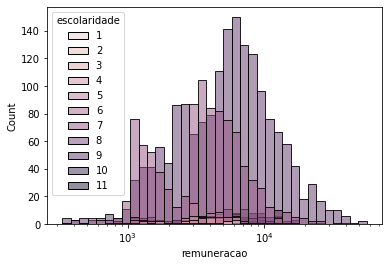

==================Categoria 9


count     1732.000000
mean      7131.483262
std       6295.148047
min        331.300000
25%       2864.802500
50%       5585.725000
75%       8855.807500
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 7


count      960.000000
mean      4282.737740
std       3408.585435
min        330.730000
25%       1731.587500
50%       3650.370000
75%       5426.862500
max      36324.990000
Name: remuneracao, dtype: float64

==================Categoria 4


count       38.000000
mean      4342.964474
std       2290.433876
min       1360.920000
25%       2862.345000
50%       3731.245000
75%       5340.395000
max      11977.240000
Name: remuneracao, dtype: float64

==================Categoria 10


count       67.00000
mean      9241.78194
std       5995.18079
min        488.87000
25%       5949.89500
50%       8134.06000
75%      12288.03500
max      37750.08000
Name: remuneracao, dtype: float64

==================Categoria 11


count       38.000000
mean      8146.468421
std       7035.827356
min       1312.340000
25%       2922.827500
50%       6750.585000
75%      11027.977500
max      38359.080000
Name: remuneracao, dtype: float64

==================Categoria 8


count       96.000000
mean      4972.760104
std       3150.965975
min        369.780000
25%       2375.865000
50%       4584.510000
75%       7033.912500
max      13535.030000
Name: remuneracao, dtype: float64

==================Categoria 5


count       71.000000
mean      4522.869577
std       3210.491493
min        700.540000
25%       2894.530000
50%       3807.850000
75%       5190.765000
max      16538.670000
Name: remuneracao, dtype: float64

==================Categoria 6


count       41.000000
mean      3896.653171
std       2374.445094
min        363.330000
25%       2497.310000
50%       3595.590000
75%       4999.460000
max      12776.410000
Name: remuneracao, dtype: float64

==================Categoria 3


count      16.000000
mean     2942.113750
std      1510.217085
min       507.100000
25%      1451.200000
50%      3042.820000
75%      3984.255000
max      6332.600000
Name: remuneracao, dtype: float64

==================Categoria 2


count      16.000000
mean     4930.076250
std      2380.546457
min      1720.990000
25%      3002.317500
50%      4725.090000
75%      6406.162500
max      9746.980000
Name: remuneracao, dtype: float64

==================Categoria 1


count       2.000000
mean     5992.685000
std      4895.689155
min      2530.910000
25%      4261.797500
50%      5992.685000
75%      7723.572500
max      9454.460000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a escolaridade


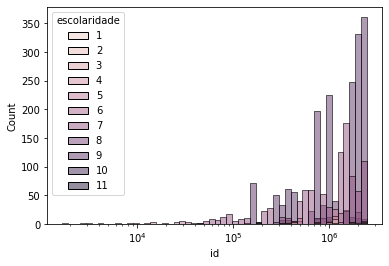

==================Categoria 9


count    1.732000e+03
mean     1.421617e+06
std      7.285091e+05
min      1.482400e+05
25%      7.388342e+05
50%      1.637619e+06
75%      2.060506e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 7


count    9.600000e+02
mean     1.199966e+06
std      6.881848e+05
min      4.765900e+04
25%      5.731742e+05
50%      1.329650e+06
75%      1.773410e+06
max      2.413953e+06
Name: id, dtype: float64

==================Categoria 4


count    3.800000e+01
mean     8.681577e+05
std      6.379326e+05
min      1.278000e+04
25%      3.539100e+05
50%      1.074746e+06
75%      1.145040e+06
max      2.225701e+06
Name: id, dtype: float64

==================Categoria 10


count    6.700000e+01
mean     1.241476e+06
std      7.754050e+05
min      1.719370e+05
25%      4.377790e+05
50%      9.812170e+05
75%      2.092288e+06
max      2.459292e+06
Name: id, dtype: float64

==================Categoria 11


count    3.800000e+01
mean     1.249127e+06
std      5.480048e+05
min      3.178220e+05
25%      9.820718e+05
50%      1.053084e+06
75%      1.692278e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 8


count    9.600000e+01
mean     1.170813e+06
std      6.152948e+05
min      1.440670e+05
25%      6.907312e+05
50%      9.057660e+05
75%      1.604285e+06
max      2.323741e+06
Name: id, dtype: float64

==================Categoria 5


count    7.100000e+01
mean     1.030200e+06
std      6.178434e+05
min      2.525300e+04
25%      4.716870e+05
50%      1.164873e+06
75%      1.210884e+06
max      2.233861e+06
Name: id, dtype: float64

==================Categoria 6


count    4.100000e+01
mean     1.045049e+06
std      6.251375e+05
min      3.386700e+04
25%      4.804870e+05
50%      1.234404e+06
75%      1.260214e+06
max      2.241858e+06
Name: id, dtype: float64

==================Categoria 3


count    1.600000e+01
mean     7.441552e+05
std      7.379775e+05
min      6.730000e+03
25%      1.339838e+05
50%      4.433095e+05
75%      1.258438e+06
max      2.219198e+06
Name: id, dtype: float64

==================Categoria 2


count    1.600000e+01
mean     6.931917e+05
std      5.738111e+05
min      1.671000e+03
25%      4.389750e+03
50%      1.087279e+06
75%      1.092677e+06
max      1.694549e+06
Name: id, dtype: float64

==================Categoria 1


count    2.000000e+00
mean     1.716250e+06
std      8.993210e+05
min      1.080334e+06
25%      1.398292e+06
50%      1.716250e+06
75%      2.034208e+06
max      2.352166e+06
Name: id, dtype: float64

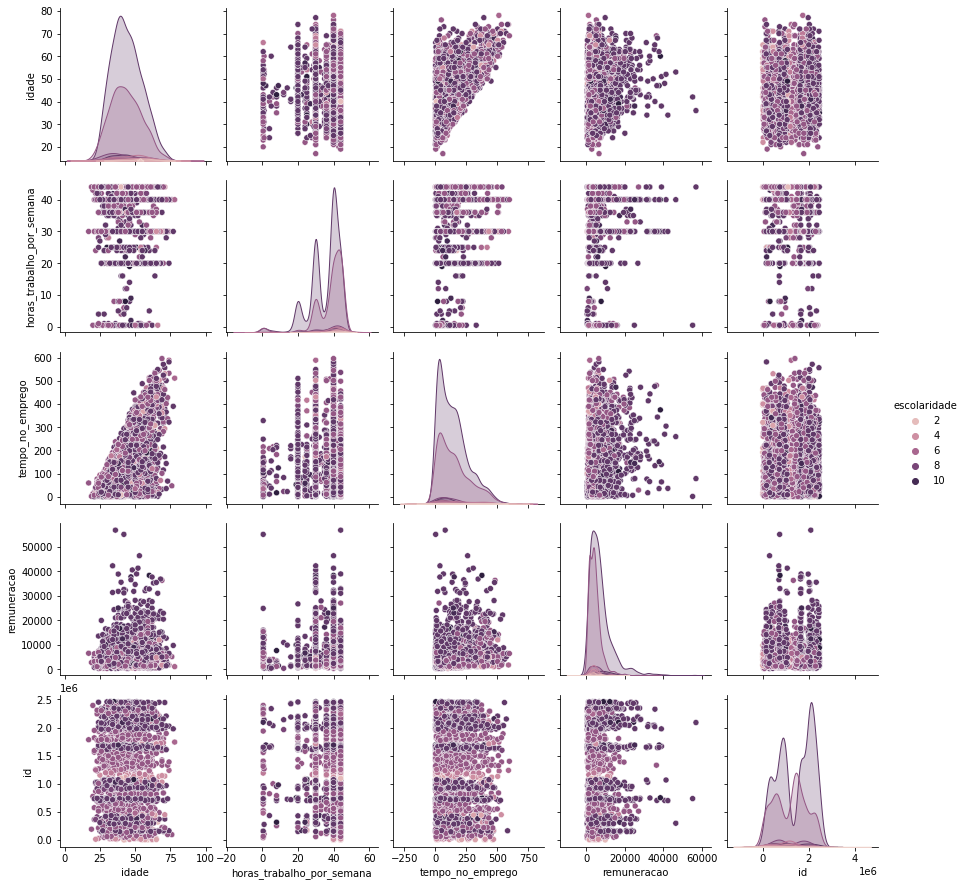

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,3057,0.9935
1,20,0.0065


Grafico de distribuição de idade com relação a portador_de_deficiencia


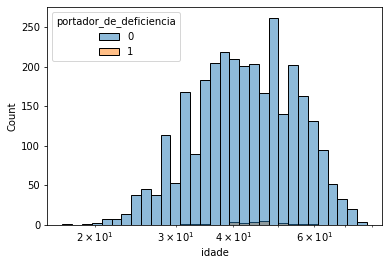

==================Categoria 0


count    3057.000000
mean       43.859012
std        10.861248
min        17.000000
25%        36.000000
50%        43.000000
75%        52.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 1


count    20.000000
mean     45.000000
std       7.405546
min      32.000000
25%      40.000000
50%      45.000000
75%      48.000000
max      60.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


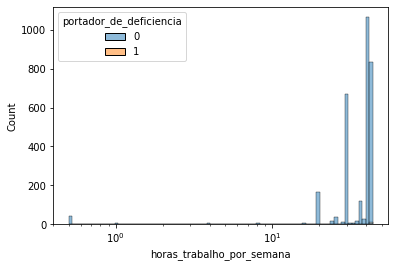

==================Categoria 0


count    3057.000000
mean       36.351652
std         8.584285
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    20.000000
mean     38.400000
std       6.644349
min      24.000000
25%      35.750000
50%      41.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


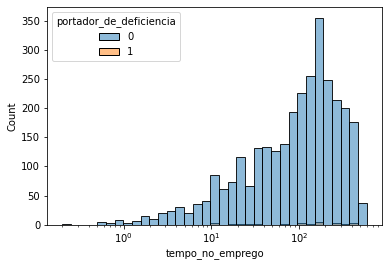

==================Categoria 0


count    3057.000000
mean      144.772522
std       124.272541
min         0.200000
25%        39.300000
50%       115.200000
75%       212.100000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     20.000000
mean     151.595000
std      131.176267
min        9.800000
25%       32.950000
50%      133.600000
75%      197.125000
max      456.800000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a portador_de_deficiencia


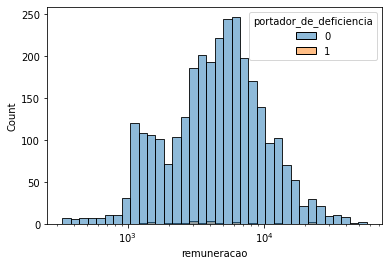

==================Categoria 0


count     3057.000000
mean      6063.987242
std       5490.862423
min        330.730000
25%       2649.650000
50%       4695.990000
75%       7563.900000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 1


count       20.000000
mean      5777.899000
std       5884.549525
min       1318.580000
25%       2578.350000
50%       3661.425000
75%       6053.982500
max      21293.160000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a portador_de_deficiencia


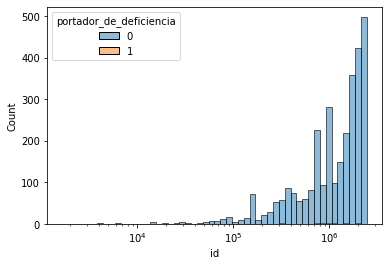

==================Categoria 0


count    3.057000e+03
mean     1.311968e+06
std      7.201783e+05
min      1.671000e+03
25%      7.128930e+05
50%      1.361017e+06
75%      2.014420e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 1


count    2.000000e+01
mean     1.098808e+06
std      6.467016e+05
min      5.513700e+04
25%      7.056152e+05
50%      1.003396e+06
75%      1.511548e+06
max      2.458375e+06
Name: id, dtype: float64

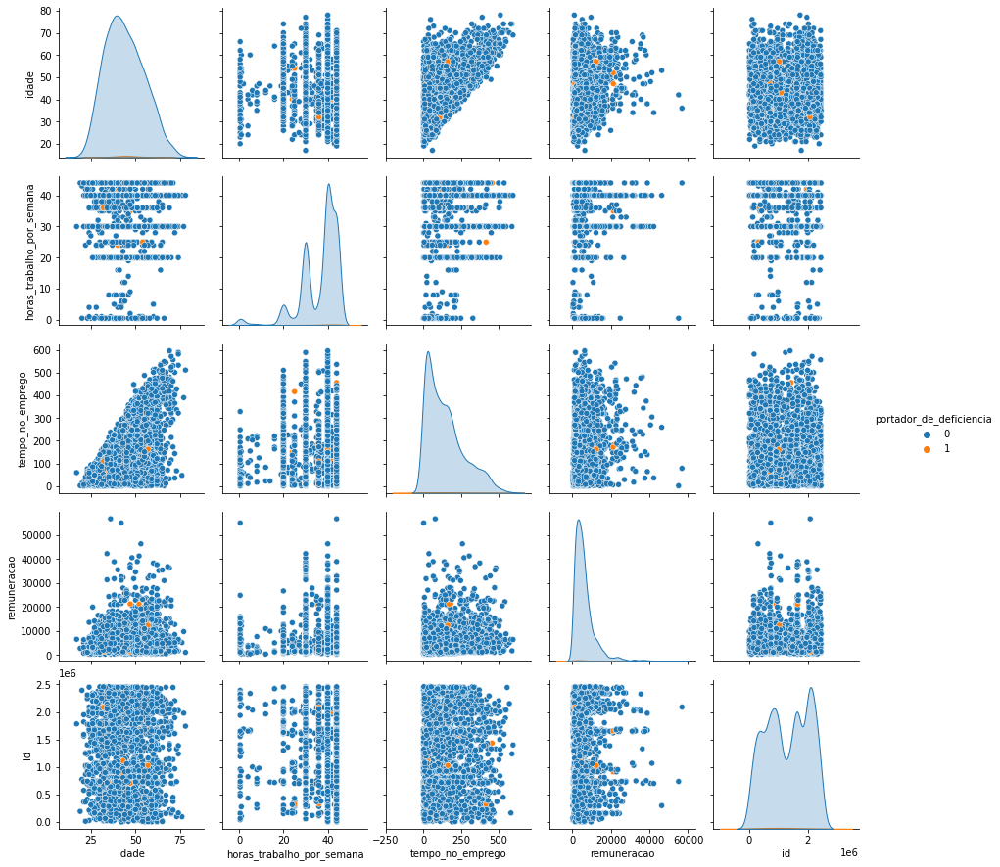

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,1610,0.523237
9,398,0.129347
7,266,0.086448
8,261,0.084823
5,186,0.060448
6,150,0.048749
4,103,0.033474
3,64,0.020799
2,39,0.012675


Grafico de distribuição de idade com relação a tamanho_da_empresa


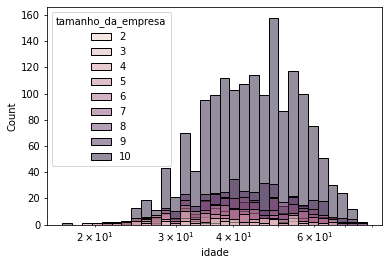

==================Categoria 7


count    266.000000
mean      42.721805
std       10.760763
min       21.000000
25%       34.000000
50%       42.000000
75%       51.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 4


count    103.000000
mean      38.621359
std       10.967972
min       19.000000
25%       29.500000
50%       37.000000
75%       45.500000
max       67.000000
Name: idade, dtype: float64

==================Categoria 10


count    1610.000000
mean       45.260248
std        10.597969
min        17.000000
25%        37.000000
50%        45.000000
75%        53.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 8


count    261.000000
mean      43.547893
std       10.470958
min       22.000000
25%       36.000000
50%       42.000000
75%       51.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 6


count    150.000000
mean      43.040000
std       11.503066
min       22.000000
25%       34.000000
50%       41.000000
75%       50.750000
max       72.000000
Name: idade, dtype: float64

==================Categoria 9


count    398.000000
mean      43.550251
std       10.699525
min       21.000000
25%       35.000000
50%       42.000000
75%       50.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 3


count    64.000000
mean     41.046875
std      11.498005
min      22.000000
25%      32.000000
50%      40.000000
75%      49.250000
max      65.000000
Name: idade, dtype: float64

==================Categoria 5


count    186.000000
mean      39.564516
std       10.829321
min       20.000000
25%       32.000000
50%       38.000000
75%       45.000000
max       70.000000
Name: idade, dtype: float64

==================Categoria 2


count    39.000000
mean     41.666667
std       9.715244
min      26.000000
25%      35.000000
50%      40.000000
75%      49.500000
max      63.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


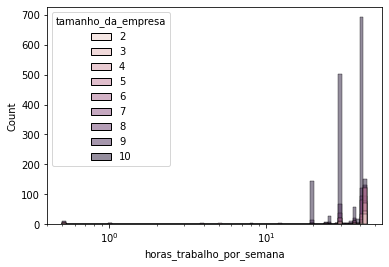

==================Categoria 7


count    266.000000
mean      38.067669
std        9.991087
min        0.500000
25%       40.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    103.000000
mean      40.150485
std        8.893938
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    1610.000000
mean       34.815839
std         7.142740
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    261.000000
mean      38.231801
std        7.918752
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    150.000000
mean      37.143333
std       11.094520
min        0.500000
25%       35.250000
50%       43.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    398.000000
mean      36.428392
std        9.579471
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    64.000000
mean     39.601562
std       9.797627
min       0.500000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    186.000000
mean      39.454301
std       10.263386
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    39.000000
mean     42.525641
std       6.995251
min       0.500000
25%      44.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


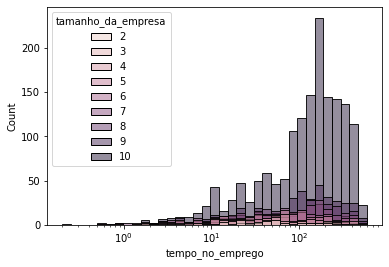

==================Categoria 7


count    266.000000
mean     114.277444
std      113.065333
min        0.500000
25%       23.000000
50%       74.050000
75%      166.575000
max      545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    103.000000
mean      87.084466
std      104.672862
min        0.900000
25%       18.100000
50%       46.900000
75%      113.600000
max      414.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count    1610.000000
mean      168.076273
std       125.760885
min         0.900000
25%        65.900000
50%       149.850000
75%       245.850000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    261.000000
mean     139.130651
std      123.963437
min        0.500000
25%       36.500000
50%      112.400000
75%      202.900000
max      581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    150.000000
mean     111.403333
std      105.643688
min        0.900000
25%       36.075000
50%       80.650000
75%      151.900000
max      507.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    398.000000
mean     144.935678
std      126.669700
min        0.200000
25%       34.975000
50%      111.700000
75%      212.675000
max      549.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count     64.000000
mean      78.134375
std       91.619320
min        0.700000
25%       14.875000
50%       50.400000
75%       97.650000
max      460.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    186.000000
mean      91.605376
std      107.511447
min        0.500000
25%       18.150000
50%       58.150000
75%      113.725000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     39.000000
mean      73.948718
std       77.788779
min        4.600000
25%       22.450000
50%       46.900000
75%      102.400000
max      342.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a tamanho_da_empresa


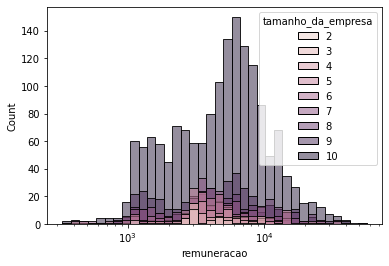

==================Categoria 7


count      266.000000
mean      5254.596692
std       4683.137807
min        369.780000
25%       2423.557500
50%       3977.480000
75%       6427.675000
max      38359.080000
Name: remuneracao, dtype: float64

==================Categoria 4


count      103.000000
mean      5568.206019
std       5310.217281
min        342.950000
25%       3076.635000
50%       3961.230000
75%       5938.350000
max      38947.500000
Name: remuneracao, dtype: float64

==================Categoria 10


count     1610.000000
mean      6354.955789
std       5428.233314
min        331.300000
25%       2570.572500
50%       5302.815000
75%       7996.125000
max      46377.980000
Name: remuneracao, dtype: float64

==================Categoria 8


count      261.000000
mean      6963.745364
std       6628.040146
min        433.760000
25%       2929.950000
50%       5132.230000
75%       9361.480000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 6


count      150.000000
mean      5348.909267
std       4979.579460
min        330.730000
25%       2933.845000
50%       3951.415000
75%       5720.550000
max      31046.630000
Name: remuneracao, dtype: float64

==================Categoria 9


count      398.000000
mean      6042.761080
std       6275.924449
min        458.990000
25%       2005.172500
50%       4457.360000
75%       7291.812500
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 3


count       64.000000
mean      4903.335937
std       3151.311266
min       1378.040000
25%       3044.250000
50%       3904.990000
75%       5792.367500
max      22445.450000
Name: remuneracao, dtype: float64

==================Categoria 5


count      186.000000
mean      5162.557258
std       4678.226633
min        350.840000
25%       2907.267500
50%       3837.230000
75%       5374.080000
max      32972.390000
Name: remuneracao, dtype: float64

==================Categoria 2


count       39.000000
mean      3884.570000
std       2425.640659
min        375.510000
25%       2783.770000
50%       3210.520000
75%       4828.045000
max      13012.240000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a tamanho_da_empresa


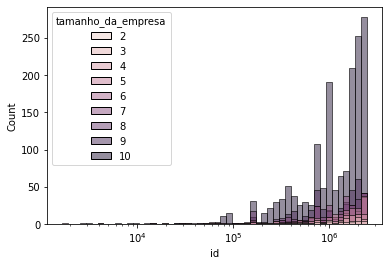

==================Categoria 7


count    2.660000e+02
mean     1.265485e+06
std      6.899749e+05
min      1.981500e+04
25%      7.305090e+05
50%      1.262708e+06
75%      1.697406e+06
max      2.458009e+06
Name: id, dtype: float64

==================Categoria 4


count    1.030000e+02
mean     1.216783e+06
std      7.525254e+05
min      4.272000e+03
25%      5.374195e+05
50%      1.378031e+06
75%      1.885182e+06
max      2.440796e+06
Name: id, dtype: float64

==================Categoria 10


count    1.610000e+03
mean     1.344044e+06
std      7.189656e+05
min      2.947000e+03
25%      7.246808e+05
50%      1.448932e+06
75%      2.030326e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 8


count    2.610000e+02
mean     1.283921e+06
std      7.293830e+05
min      1.278000e+04
25%      6.968970e+05
50%      1.386109e+06
75%      2.015771e+06
max      2.456726e+06
Name: id, dtype: float64

==================Categoria 6


count    1.500000e+02
mean     1.375186e+06
std      7.379732e+05
min      1.671000e+03
25%      7.320585e+05
50%      1.408190e+06
75%      2.084738e+06
max      2.451607e+06
Name: id, dtype: float64

==================Categoria 9


count    3.980000e+02
mean     1.223734e+06
std      7.061422e+05
min      2.640000e+03
25%      6.651462e+05
50%      1.217586e+06
75%      1.875522e+06
max      2.445609e+06
Name: id, dtype: float64

==================Categoria 3


count    6.400000e+01
mean     1.222010e+06
std      7.298724e+05
min      2.029000e+04
25%      6.120202e+05
50%      1.279054e+06
75%      1.952434e+06
max      2.394393e+06
Name: id, dtype: float64

==================Categoria 5


count    1.860000e+02
mean     1.358818e+06
std      7.463992e+05
min      1.484800e+04
25%      7.091432e+05
50%      1.520632e+06
75%      2.029292e+06
max      2.457951e+06
Name: id, dtype: float64

==================Categoria 2


count    3.900000e+01
mean     1.216124e+06
std      6.455643e+05
min      2.487130e+05
25%      6.742625e+05
50%      1.028482e+06
75%      1.711349e+06
max      2.337113e+06
Name: id, dtype: float64

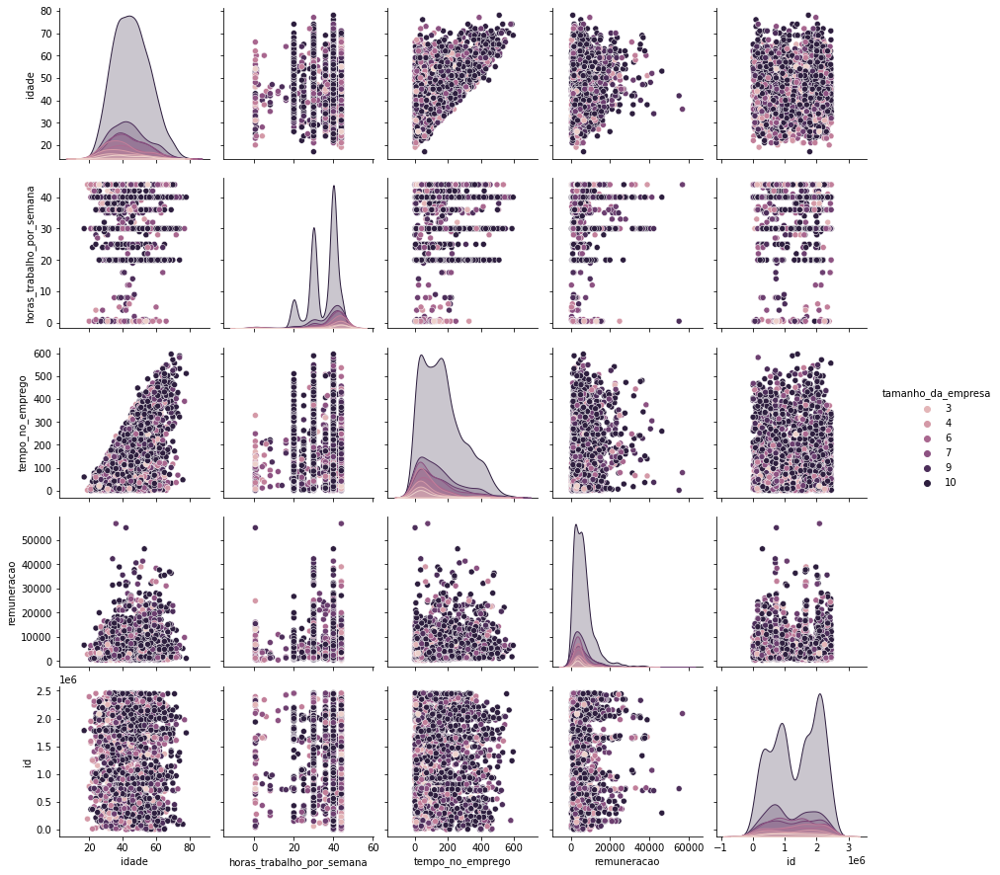

In [ ]:
def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = out.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = out.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([out[i].value_counts(), out[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(out, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()
  

In [ ]:
baixa_renda = dados[dados['remuneracao']<2500]
renda_alta = dados[dados['remuneracao']>=2500]
print(len(baixa_renda))
print(len(renda_alta))

9985
5015


In [ ]:
a = index_normais
b = index_outliers
c = baixa_renda.index
d = renda_alta.index
print(f'Renda Baixa e Indices Normais {len(list(set(a) & set(c)))}')
print(f'Renda Baixa e Indices Outliers {len(list(set(a) & set(d)))}')
print(f'Renda Alta e Indices Normais {len(list(set(b) & set(c)))}')
print(f'Renda Alta e Indices Outliers {len(list(set(b) & set(d)))}')

Renda Baixa e Indices Normais 6290
Renda Baixa e Indices Outliers 1133
Renda Alta e Indices Normais 713
Renda Alta e Indices Outliers 2364


================sexo=============


,sexo,sexo
1,2791,0.55653
2,2224,0.44347


Grafico de distribuição de idade com relação a sexo


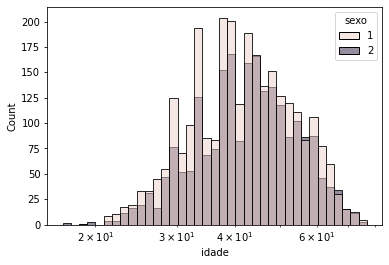

==================Categoria 1


count    2791.000000
mean       42.771050
std        10.793246
min        19.000000
25%        34.000000
50%        41.000000
75%        50.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 2


count    2224.000000
mean       43.566547
std        10.536788
min        17.000000
25%        36.000000
50%        43.000000
75%        51.000000
max        77.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


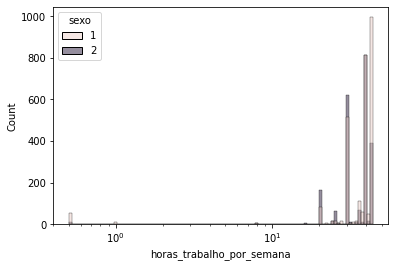

==================Categoria 1


count    2791.000000
mean       37.340917
std         8.747193
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    2224.000000
mean       35.249550
std         7.846079
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


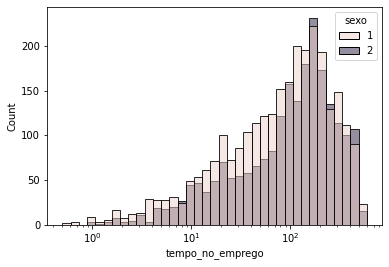

==================Categoria 1


count    2791.000000
mean      130.606342
std       119.882501
min         0.500000
25%        33.600000
50%        96.000000
75%       188.850000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    2224.000000
mean      147.345998
std       122.870612
min         0.900000
25%        43.450000
50%       118.900000
75%       208.625000
max       560.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a sexo


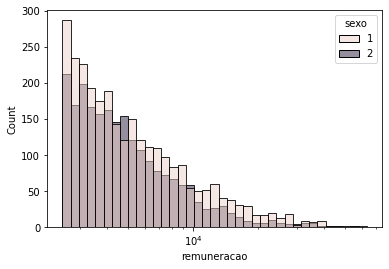

==================Categoria 1


count     2791.000000
mean      6494.661759
std       5647.141925
min       2501.120000
25%       3182.950000
50%       4453.910000
75%       7378.130000
max      63218.070000
Name: remuneracao, dtype: float64

==================Categoria 2


count     2224.000000
mean      5789.501641
std       4705.530348
min       2501.340000
25%       3228.375000
50%       4345.450000
75%       6412.637500
max      56849.230000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a sexo


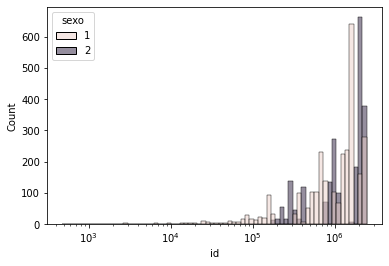

==================Categoria 1


count    2.791000e+03
mean     1.188320e+06
std      6.794162e+05
min      4.770000e+02
25%      6.341620e+05
50%      1.292086e+06
75%      1.640146e+06
max      2.351370e+06
Name: id, dtype: float64

==================Categoria 2


count    2.224000e+03
mean     1.464001e+06
std      7.488918e+05
min      1.738290e+05
25%      9.117105e+05
50%      1.833946e+06
75%      2.057414e+06
max      2.459844e+06
Name: id, dtype: float64

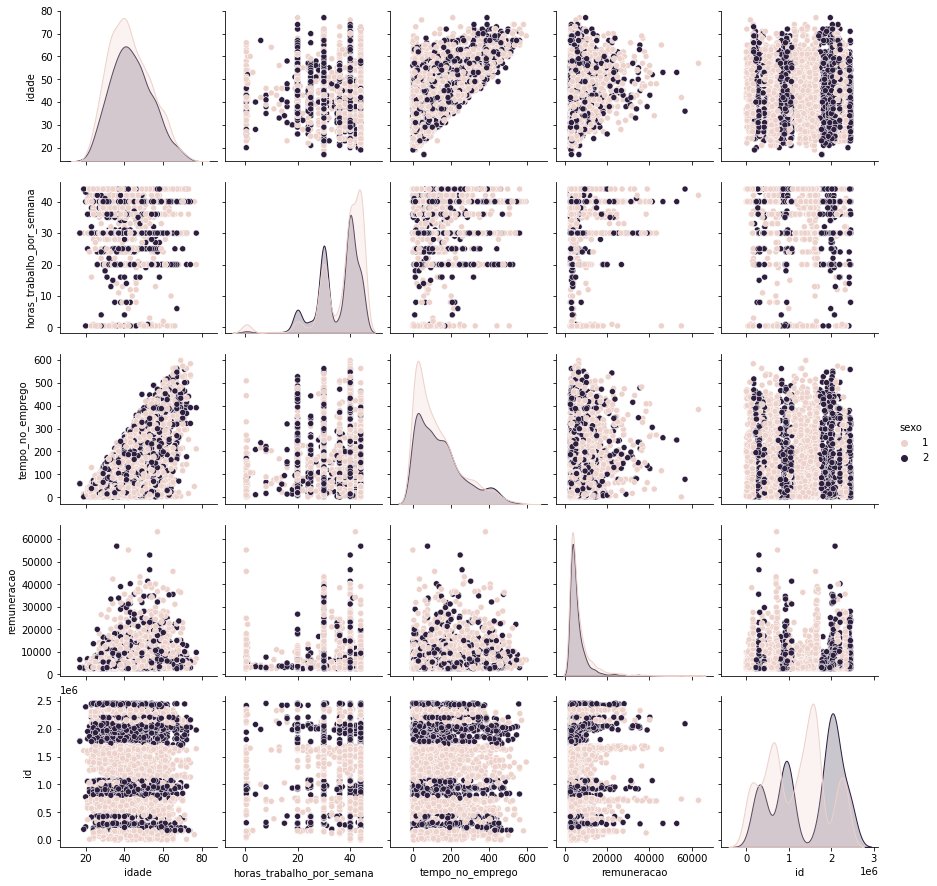

================faixa_etaria=============


,faixa_etaria,faixa_etaria
6,1610,0.321037
5,1553,0.309671
7,1214,0.242074
4,385,0.076770
8,157,0.031306
3,94,0.018744
2,2,0.000399


Grafico de distribuição de idade com relação a faixa_etaria


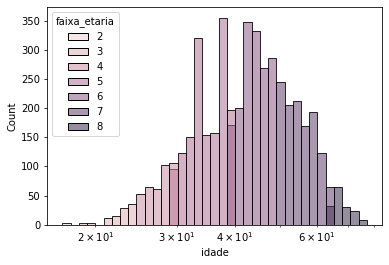

==================Categoria 5


count    1553.000000
mean       34.961365
std         2.790319
min        30.000000
25%        33.000000
50%        35.000000
75%        37.000000
max        39.000000
Name: idade, dtype: float64

==================Categoria 7


count    1214.000000
mean       55.518122
std         4.022720
min        50.000000
25%        52.000000
50%        55.000000
75%        59.000000
max        64.000000
Name: idade, dtype: float64

==================Categoria 6


count    1610.000000
mean       44.198758
std         2.863195
min        40.000000
25%        42.000000
50%        44.000000
75%        47.000000
max        49.000000
Name: idade, dtype: float64

==================Categoria 4


count    385.000000
mean      27.379221
std        1.390662
min       25.000000
25%       26.000000
50%       28.000000
75%       29.000000
max       29.000000
Name: idade, dtype: float64

==================Categoria 3


count    94.000000
mean     22.787234
std       1.277366
min      19.000000
25%      22.000000
50%      23.000000
75%      24.000000
max      24.000000
Name: idade, dtype: float64

==================Categoria 8


count    157.000000
mean      68.121019
std        2.778928
min       65.000000
25%       66.000000
50%       67.000000
75%       70.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 2


count     2.0
mean     17.0
std       0.0
min      17.0
25%      17.0
50%      17.0
75%      17.0
max      17.0
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


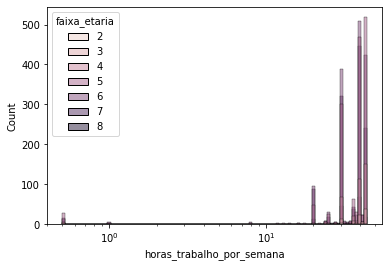

==================Categoria 5


count    1553.000000
mean       37.186413
std         8.438444
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    1214.000000
mean       35.403213
std         8.464337
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    1610.000000
mean       36.047826
std         8.430088
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    385.000000
mean      38.336364
std        7.458338
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    94.000000
mean     37.893617
std       8.939724
min       0.500000
25%      36.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    157.000000
mean      34.808917
std        8.274059
min        0.500000
25%       30.000000
50%       40.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count     2.0
mean     30.0
std       0.0
min      30.0
25%      30.0
50%      30.0
75%      30.0
max      30.0
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


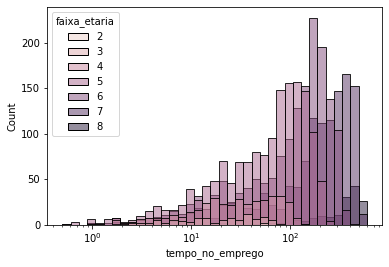

==================Categoria 5


count    1553.000000
mean       76.551835
std        55.773044
min         0.700000
25%        25.800000
50%        70.900000
75%       114.500000
max       244.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    1214.000000
mean      231.094481
std       139.110018
min         0.500000
25%       119.675000
50%       225.900000
75%       345.100000
max       525.700000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    1610.000000
mean      136.942422
std        90.902511
min         0.500000
25%        57.975000
50%       135.550000
75%       197.900000
max       448.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    385.000000
mean      38.383896
std       30.170269
min        0.900000
25%       13.900000
50%       29.100000
75%       59.500000
max      133.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count     94.000000
mean      26.895745
std       22.730406
min        0.900000
25%        7.900000
50%       21.250000
75%       40.000000
max      130.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    157.000000
mean     349.573248
std      151.974826
min        2.100000
25%      237.900000
50%      386.800000
75%      462.900000
max      596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     2.0
mean     59.9
std       0.0
min      59.9
25%      59.9
50%      59.9
75%      59.9
max      59.9
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a faixa_etaria


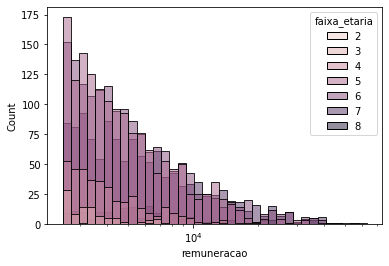

==================Categoria 5


count     1553.000000
mean      5604.511384
std       4174.137403
min       2503.310000
25%       3154.880000
50%       4220.660000
75%       6430.320000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 7


count     1214.000000
mean      7336.995939
std       6457.138265
min       2502.030000
25%       3401.605000
50%       5095.510000
75%       8409.697500
max      63218.070000
Name: remuneracao, dtype: float64

==================Categoria 6


count     1610.000000
mean      6291.240925
std       5377.109376
min       2501.120000
25%       3245.985000
50%       4461.205000
75%       7070.042500
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 4


count      385.000000
mean      4498.648909
std       2635.917580
min       2501.490000
25%       2969.320000
50%       3628.590000
75%       5057.110000
max      26432.260000
Name: remuneracao, dtype: float64

==================Categoria 3


count       94.000000
mean      3651.206915
std       1564.645684
min       2513.070000
25%       2673.787500
50%       3185.325000
75%       3791.145000
max      13553.440000
Name: remuneracao, dtype: float64

==================Categoria 8


count      157.000000
mean      7502.642611
std       6999.609850
min       2513.720000
25%       3660.290000
50%       5102.670000
75%       8094.550000
max      45649.020000
Name: remuneracao, dtype: float64

==================Categoria 2


count       2.000000
mean     4763.655000
std      2495.231338
min      2999.260000
25%      3881.457500
50%      4763.655000
75%      5645.852500
max      6528.050000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a faixa_etaria


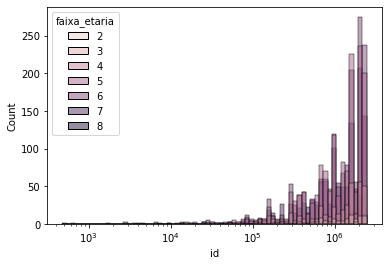

==================Categoria 5


count    1.553000e+03
mean     1.301305e+06
std      7.146009e+05
min      4.770000e+02
25%      6.961060e+05
50%      1.336511e+06
75%      1.994693e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 7


count    1.214000e+03
mean     1.278107e+06
std      7.272361e+05
min      2.640000e+03
25%      6.944055e+05
50%      1.276352e+06
75%      2.004466e+06
max      2.459357e+06
Name: id, dtype: float64

==================Categoria 6


count    1.610000e+03
mean     1.344478e+06
std      7.328607e+05
min      1.671000e+03
25%      7.173060e+05
50%      1.455997e+06
75%      2.020495e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 4


count    3.850000e+02
mean     1.296962e+06
std      7.177431e+05
min      1.681100e+04
25%      6.877880e+05
50%      1.397626e+06
75%      1.968248e+06
max      2.457188e+06
Name: id, dtype: float64

==================Categoria 3


count    9.400000e+01
mean     1.281908e+06
std      6.850358e+05
min      1.514800e+04
25%      6.985588e+05
50%      1.309002e+06
75%      1.834186e+06
max      2.456794e+06
Name: id, dtype: float64

==================Categoria 8


count    1.570000e+02
mean     1.350282e+06
std      7.377415e+05
min      9.681000e+03
25%      7.392150e+05
50%      1.620339e+06
75%      2.015997e+06
max      2.450172e+06
Name: id, dtype: float64

==================Categoria 2


count    2.000000e+00
mean     1.779124e+06
std      6.612863e+03
min      1.774448e+06
25%      1.776786e+06
50%      1.779124e+06
75%      1.781462e+06
max      1.783800e+06
Name: id, dtype: float64

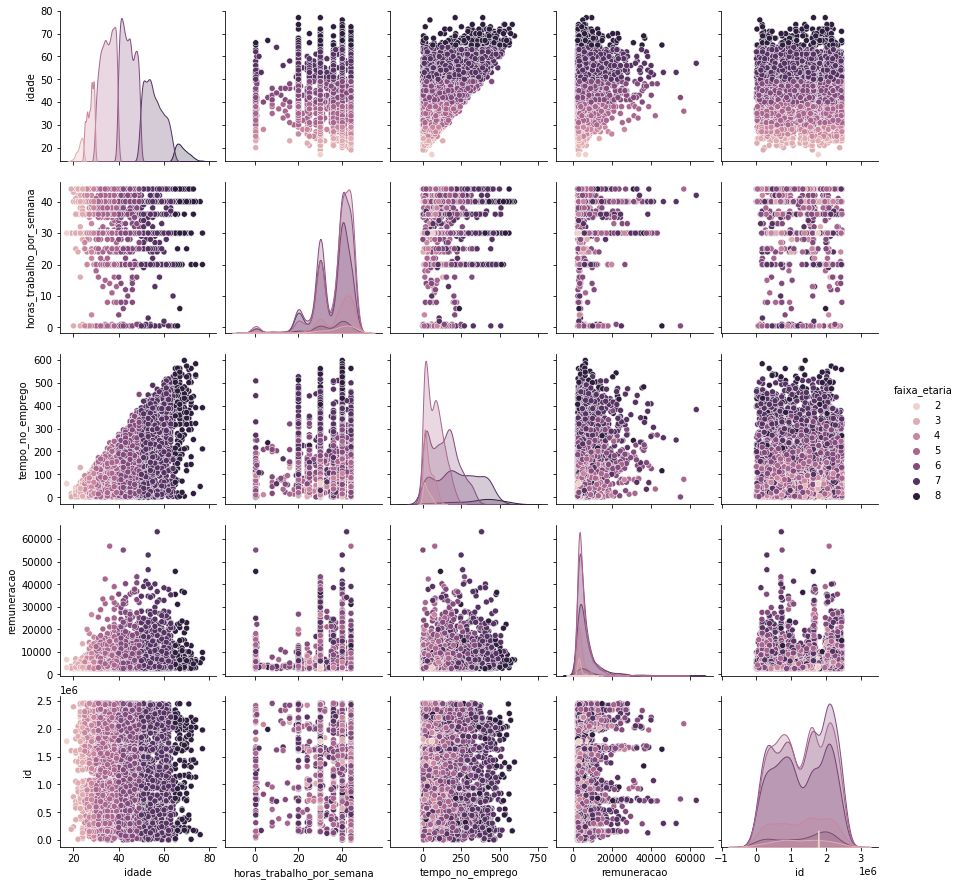

================cor_raca=============


,cor_raca,cor_raca
99,2964,0.591027
8,1314,0.262014
2,437,0.087139
9,221,0.044068
4,54,0.010768
6,18,0.003589
1,7,0.001396


Grafico de distribuição de idade com relação a cor_raca


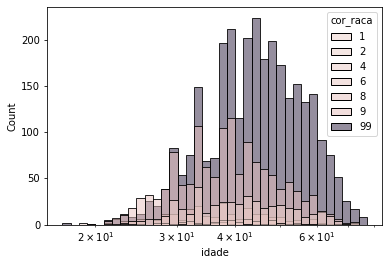

==================Categoria 8


count    1314.000000
mean       39.500761
std         9.746853
min        20.000000
25%        32.000000
50%        38.000000
75%        45.750000
max        72.000000
Name: idade, dtype: float64

==================Categoria 99


count    2964.000000
mean       45.340081
std        10.578782
min        17.000000
25%        38.000000
50%        45.000000
75%        53.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 2


count    437.000000
mean      41.805492
std       10.779745
min       19.000000
25%       33.000000
50%       41.000000
75%       49.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 9


count    221.000000
mean      38.493213
std        9.634512
min       21.000000
25%       32.000000
50%       37.000000
75%       44.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 4


count    54.000000
mean     39.851852
std       9.562915
min      23.000000
25%      32.000000
50%      40.000000
75%      44.750000
max      67.000000
Name: idade, dtype: float64

==================Categoria 6


count    18.000000
mean     40.555556
std       8.603845
min      28.000000
25%      35.250000
50%      37.500000
75%      47.000000
max      55.000000
Name: idade, dtype: float64

==================Categoria 1


count     7.000000
mean     45.142857
std      13.284434
min      24.000000
25%      37.000000
50%      51.000000
75%      53.500000
max      60.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


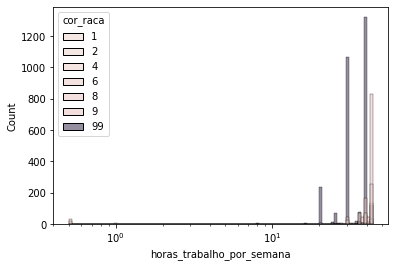

==================Categoria 8


count    1314.000000
mean       39.919711
std         8.948668
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 99


count    2964.000000
mean       34.193995
std         6.850938
min         1.000000
25%        30.000000
50%        36.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    437.000000
mean      38.629291
std       10.761269
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    221.000000
mean      40.300905
std        8.445208
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    54.000000
mean     39.444444
std       8.885894
min       0.500000
25%      38.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    18.000000
mean     39.527778
std      10.429698
min       0.500000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     7.000000
mean     25.571429
std      16.195237
min       1.000000
25%      16.000000
50%      22.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


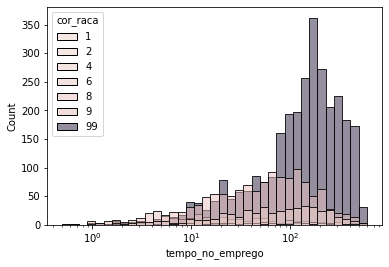

==================Categoria 8


count    1314.000000
mean       82.750381
std        87.054263
min         0.500000
25%        19.850000
50%        56.750000
75%       114.900000
max       561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 99


count    2964.000000
mean      174.405162
std       126.146348
min         0.700000
25%        77.000000
50%       154.000000
75%       248.000000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    437.000000
mean     107.250572
std      101.506649
min        0.700000
25%       30.900000
50%       75.900000
75%      153.900000
max      545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    221.000000
mean      51.589140
std       86.585675
min        0.500000
25%        7.600000
50%       18.000000
75%       49.900000
max      556.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count     54.000000
mean      93.912963
std       83.176829
min        1.800000
25%       29.625000
50%       74.300000
75%      125.125000
max      472.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     18.000000
mean     112.316667
std       82.196431
min        1.900000
25%       64.725000
50%       98.850000
75%      148.900000
max      265.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      7.000000
mean     169.457143
std      160.794940
min        6.400000
25%       67.750000
50%       95.600000
75%      255.950000
max      436.800000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a cor_raca


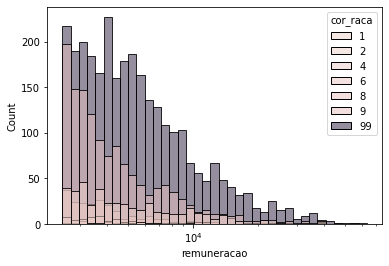

==================Categoria 8


count     1314.000000
mean      5110.143950
std       4426.607386
min       2501.490000
25%       2948.830000
50%       3695.030000
75%       5499.770000
max      63218.070000
Name: remuneracao, dtype: float64

==================Categoria 99


count     2964.000000
mean      6748.073586
std       5524.959943
min       2501.120000
25%       3485.592500
50%       4954.420000
75%       7674.280000
max      52916.240000
Name: remuneracao, dtype: float64

==================Categoria 2


count      437.000000
mean      6605.710481
std       5956.539505
min       2504.070000
25%       3212.070000
50%       4467.640000
75%       7751.720000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 9


count      221.000000
mean      4504.207376
std       3205.392895
min       2510.390000
25%       2934.390000
50%       3584.710000
75%       4566.330000
max      27909.880000
Name: remuneracao, dtype: float64

==================Categoria 4


count       54.000000
mean      4423.696667
std       2441.903507
min       2520.960000
25%       3082.687500
50%       3589.865000
75%       4460.287500
max      11999.580000
Name: remuneracao, dtype: float64

==================Categoria 6


count       18.000000
mean      6829.031111
std       8495.878323
min       2640.650000
25%       3176.445000
50%       4688.775000
75%       6586.567500
max      40019.740000
Name: remuneracao, dtype: float64

==================Categoria 1


count        7.000000
mean      6072.267143
std       2206.975341
min       3493.540000
25%       4802.590000
50%       5950.620000
75%       6678.565000
max      10099.400000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a cor_raca


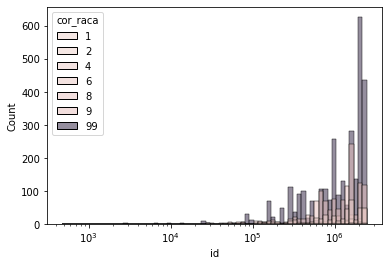

==================Categoria 8


count    1.314000e+03
mean     1.224796e+06
std      6.455763e+05
min      4.770000e+02
25%      6.774048e+05
50%      1.262646e+06
75%      1.655292e+06
max      2.459818e+06
Name: id, dtype: float64

==================Categoria 99


count    2.964000e+03
mean     1.361955e+06
std      7.502065e+05
min      2.640000e+03
25%      7.173960e+05
50%      1.492454e+06
75%      2.044452e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 2


count    4.370000e+02
mean     1.243565e+06
std      7.178441e+05
min      6.480000e+02
25%      6.695490e+05
50%      1.398309e+06
75%      1.692887e+06
max      2.458375e+06
Name: id, dtype: float64

==================Categoria 9


count    2.210000e+02
mean     1.273709e+06
std      7.753313e+05
min      1.671000e+03
25%      6.293740e+05
50%      1.071751e+06
75%      1.967591e+06
max      2.456162e+06
Name: id, dtype: float64

==================Categoria 4


count    5.400000e+01
mean     1.320154e+06
std      6.804819e+05
min      5.400000e+04
25%      1.026389e+06
50%      1.512378e+06
75%      1.669846e+06
max      2.426413e+06
Name: id, dtype: float64

==================Categoria 6


count    1.800000e+01
mean     1.161256e+06
std      7.641979e+05
min      1.678230e+05
25%      6.669380e+05
50%      9.423110e+05
75%      1.924964e+06
max      2.296833e+06
Name: id, dtype: float64

==================Categoria 1


count    7.000000e+00
mean     1.315162e+06
std      6.214539e+05
min      1.723560e+05
25%      1.088161e+06
50%      1.432158e+06
75%      1.678375e+06
max      2.068549e+06
Name: id, dtype: float64

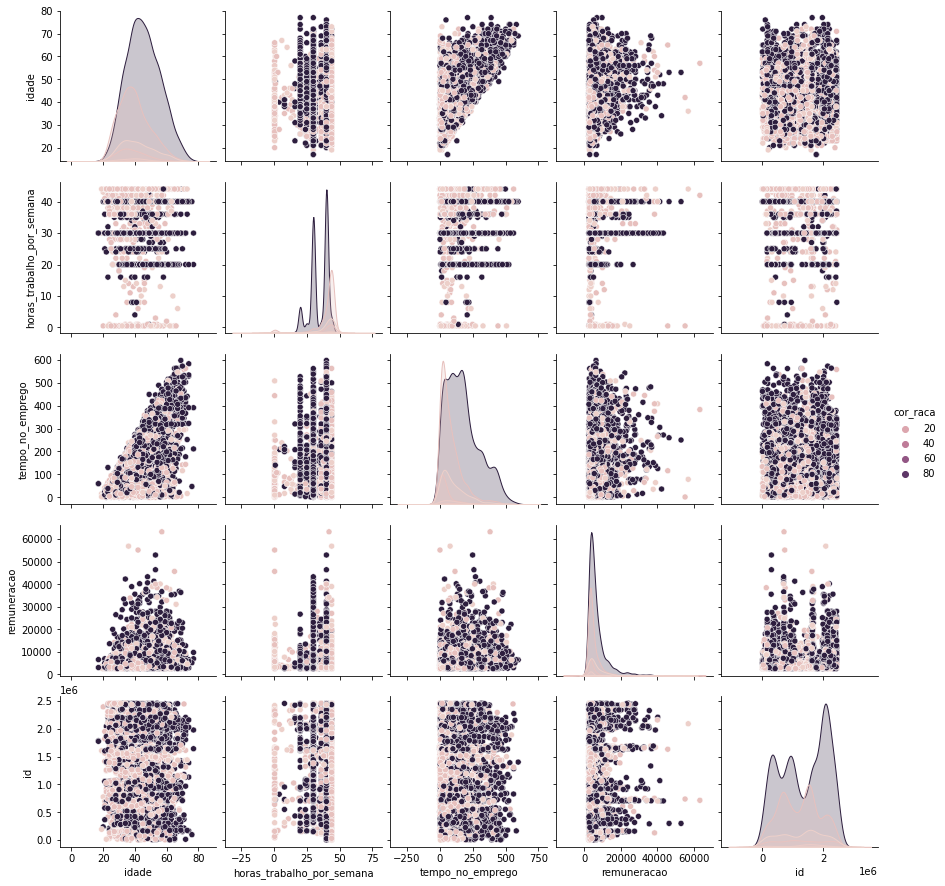

================escolaridade=============


,escolaridade,escolaridade
9,2663,0.531007
7,1704,0.339781
8,151,0.030110
5,146,0.029113
10,81,0.016152
...,...,...
4,73,0.014556
11,58,0.011565
2,33,0.006580
3,27,0.005384


Grafico de distribuição de idade com relação a escolaridade


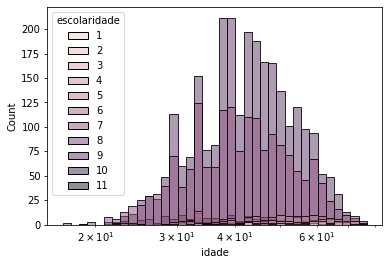

==================Categoria 7


count    1704.000000
mean       42.074531
std        10.837819
min        17.000000
25%        34.000000
50%        41.000000
75%        49.000000
max        76.000000
Name: idade, dtype: float64

==================Categoria 9


count    2663.000000
mean       43.342095
std        10.093540
min        21.000000
25%        36.000000
50%        42.000000
75%        50.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 8


count    151.000000
mean      38.503311
std       11.808965
min       19.000000
25%       30.000000
50%       36.000000
75%       45.500000
max       72.000000
Name: idade, dtype: float64

==================Categoria 10


count    81.000000
mean     43.074074
std       9.273319
min      27.000000
25%      35.000000
50%      43.000000
75%      51.000000
max      68.000000
Name: idade, dtype: float64

==================Categoria 4


count    73.000000
mean     53.410959
std      11.734133
min      22.000000
25%      45.000000
50%      54.000000
75%      63.000000
max      74.000000
Name: idade, dtype: float64

==================Categoria 5


count    146.000000
mean      48.431507
std       11.788310
min       24.000000
25%       39.000000
50%       49.000000
75%       57.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 6


count    74.000000
mean     42.135135
std      11.317733
min      22.000000
25%      33.250000
50%      41.500000
75%      50.750000
max      63.000000
Name: idade, dtype: float64

==================Categoria 2


count    33.000000
mean     53.060606
std      11.064977
min      25.000000
25%      45.000000
50%      54.000000
75%      62.000000
max      73.000000
Name: idade, dtype: float64

==================Categoria 3


count    27.000000
mean     49.851852
std       8.160428
min      39.000000
25%      42.500000
50%      51.000000
75%      55.000000
max      65.000000
Name: idade, dtype: float64

==================Categoria 11


count    58.000000
mean     41.827586
std      10.692083
min      24.000000
25%      33.250000
50%      39.000000
75%      51.750000
max      65.000000
Name: idade, dtype: float64

==================Categoria 1


count     5.0000
mean     47.4000
std       6.8775
min      37.0000
25%      45.0000
50%      48.0000
75%      53.0000
max      54.0000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


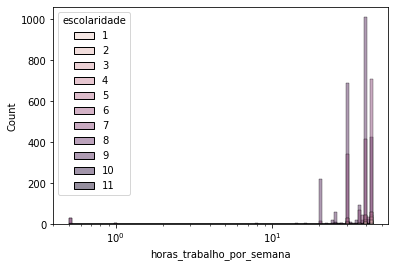

==================Categoria 7


count    1704.000000
mean       38.163732
std         8.023172
min         0.500000
25%        33.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    2663.000000
mean       34.885843
std         8.489670
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    151.000000
mean      37.672185
std        8.452819
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    81.000000
mean     36.629630
std       7.299734
min       3.000000
25%      30.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    73.000000
mean     38.808219
std       8.150337
min       0.500000
25%      36.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    146.000000
mean      38.910959
std        6.980437
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    74.000000
mean     39.310811
std       8.842109
min       0.500000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    33.000000
mean     41.333333
std       4.734624
min      24.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    27.000000
mean     40.703704
std       6.100535
min      20.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count    58.000000
mean     33.310345
std       8.746341
min       8.000000
25%      30.000000
50%      38.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     5.000000
mean     41.600000
std       3.577709
min      36.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


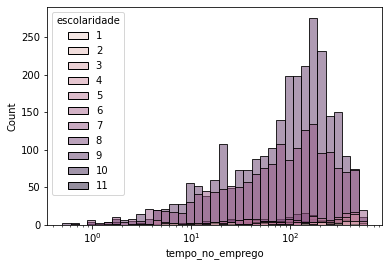

==================Categoria 7


count    1704.000000
mean      133.245246
std       125.014056
min         0.700000
25%        32.550000
50%        93.900000
75%       189.900000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    2663.000000
mean      136.437101
std       112.483666
min         0.500000
25%        40.950000
50%       112.900000
75%       195.400000
max       581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    151.000000
mean     131.298013
std      123.566238
min        1.800000
25%       34.550000
50%      105.500000
75%      176.650000
max      561.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count     81.000000
mean     134.466667
std      114.372998
min        0.900000
25%       52.000000
50%      100.900000
75%      183.800000
max      472.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count     73.000000
mean     249.302740
std      176.338333
min        2.700000
25%       61.800000
50%      272.200000
75%      417.900000
max      530.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    146.000000
mean     181.454795
std      156.255256
min        1.800000
25%       40.000000
50%      142.300000
75%      314.400000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     74.000000
mean     142.787838
std      134.073792
min        3.700000
25%       38.425000
50%       82.850000
75%      208.750000
max      465.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     33.000000
mean     175.009091
std      173.348910
min        1.900000
25%       16.500000
50%      135.900000
75%      378.100000
max      461.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count     27.000000
mean     130.511111
std      117.011355
min        1.400000
25%       26.400000
50%       90.600000
75%      211.350000
max      446.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count     58.000000
mean      97.710345
std       96.094330
min        0.900000
25%       23.100000
50%       79.800000
75%      132.800000
max      429.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      5.00000
mean     179.20000
std      114.83314
min       32.70000
25%      133.90000
50%      136.80000
75%      294.10000
max      298.50000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a escolaridade


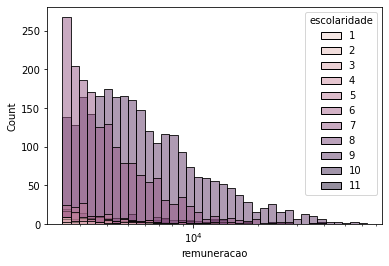

==================Categoria 7


count     1704.000000
mean      4588.629818
std       2981.313616
min       2501.120000
25%       2933.612500
50%       3600.770000
75%       5076.280000
max      38414.330000
Name: remuneracao, dtype: float64

==================Categoria 9


count     2663.000000
mean      7362.272764
std       6197.791772
min       2501.490000
25%       3708.225000
50%       5272.430000
75%       8412.055000
max      63218.070000
Name: remuneracao, dtype: float64

==================Categoria 8


count      151.000000
mean      5148.327086
std       2845.846387
min       2517.710000
25%       3048.680000
50%       4124.860000
75%       6396.735000
max      18078.820000
Name: remuneracao, dtype: float64

==================Categoria 10


count       81.000000
mean      9875.251852
std       6682.356145
min       2712.660000
25%       5773.560000
50%       7903.350000
75%      12295.010000
max      37750.080000
Name: remuneracao, dtype: float64

==================Categoria 4


count       73.000000
mean      4409.410685
std       2911.918813
min       2515.380000
25%       2792.010000
50%       3353.380000
75%       5012.890000
max      23001.940000
Name: remuneracao, dtype: float64

==================Categoria 5


count      146.000000
mean      4214.631301
std       2565.528815
min       2501.340000
25%       2880.262500
50%       3240.925000
75%       4318.882500
max      16538.670000
Name: remuneracao, dtype: float64

==================Categoria 6


count       74.000000
mean      4086.167703
std       1957.966552
min       2531.950000
25%       2804.537500
50%       3522.325000
75%       4642.860000
max      12776.410000
Name: remuneracao, dtype: float64

==================Categoria 2


count      33.000000
mean     4069.787879
std      1882.749354
min      2528.730000
25%      2719.200000
50%      3168.380000
75%      5005.760000
max      9746.980000
Name: remuneracao, dtype: float64

==================Categoria 3


count      27.000000
mean     3428.540741
std      1045.740393
min      2511.720000
25%      2738.560000
50%      3115.990000
75%      3874.060000
max      6784.720000
Name: remuneracao, dtype: float64

==================Categoria 11


count       58.000000
mean      8833.002759
std       7737.074593
min       2718.210000
25%       3752.925000
50%       6606.845000
75%      11451.410000
max      40019.740000
Name: remuneracao, dtype: float64

==================Categoria 1


count       5.000000
mean     4322.986000
std      2980.255824
min      2530.910000
25%      2558.100000
50%      2633.020000
75%      4438.440000
max      9454.460000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a escolaridade


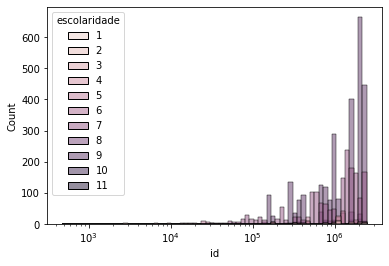

==================Categoria 7


count    1.704000e+03
mean     1.197546e+06
std      6.756349e+05
min      5.063300e+04
25%      6.006808e+05
50%      1.314678e+06
75%      1.587753e+06
max      2.416308e+06
Name: id, dtype: float64

==================Categoria 9


count    2.663000e+03
mean     1.434672e+06
std      7.396130e+05
min      1.482400e+05
25%      7.409495e+05
50%      1.643793e+06
75%      2.063486e+06
max      2.458758e+06
Name: id, dtype: float64

==================Categoria 8


count    1.510000e+02
mean     1.219221e+06
std      6.567810e+05
min      1.437320e+05
25%      6.910990e+05
50%      1.594917e+06
75%      1.781670e+06
max      2.418709e+06
Name: id, dtype: float64

==================Categoria 10


count    8.100000e+01
mean     1.282570e+06
std      7.780495e+05
min      1.719370e+05
25%      4.379030e+05
50%      1.029945e+06
75%      2.092682e+06
max      2.459357e+06
Name: id, dtype: float64

==================Categoria 4


count    7.300000e+01
mean     8.898822e+05
std      6.752112e+05
min      1.278000e+04
25%      3.220350e+05
50%      1.117435e+06
75%      1.141892e+06
max      2.225701e+06
Name: id, dtype: float64

==================Categoria 5


count    1.460000e+02
mean     1.002413e+06
std      6.265002e+05
min      2.390300e+04
25%      4.644485e+05
50%      1.168430e+06
75%      1.213736e+06
max      2.359030e+06
Name: id, dtype: float64

==================Categoria 6


count    7.400000e+01
mean     1.047065e+06
std      6.622665e+05
min      3.386700e+04
25%      4.797838e+05
50%      1.245918e+06
75%      1.262450e+06
max      2.241858e+06
Name: id, dtype: float64

==================Categoria 2


count    3.300000e+01
mean     8.640178e+05
std      7.293320e+05
min      6.480000e+02
25%      1.738820e+05
50%      9.839600e+05
75%      1.097076e+06
max      2.216158e+06
Name: id, dtype: float64

==================Categoria 3


count    2.700000e+01
mean     9.595406e+05
std      6.809420e+05
min      6.725000e+03
25%      4.436395e+05
50%      1.109187e+06
75%      1.407271e+06
max      2.219198e+06
Name: id, dtype: float64

==================Categoria 11


count    5.800000e+01
mean     1.245509e+06
std      5.969846e+05
min      1.725650e+05
25%      7.523910e+05
50%      1.030852e+06
75%      1.692552e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 1


count    5.000000e+00
mean     1.588482e+06
std      1.033186e+06
min      4.770000e+02
25%      1.080334e+06
50%      2.157335e+06
75%      2.352100e+06
max      2.352166e+06
Name: id, dtype: float64

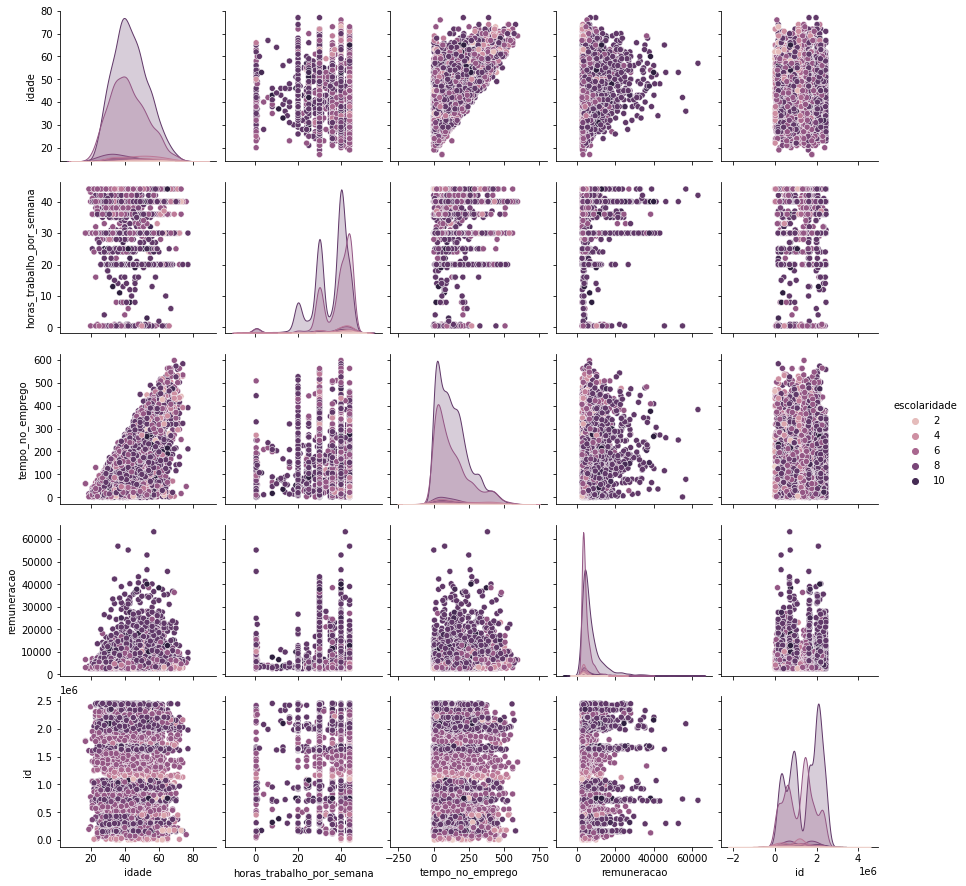

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,4984,0.993819
1,31,0.006181


Grafico de distribuição de idade com relação a portador_de_deficiencia


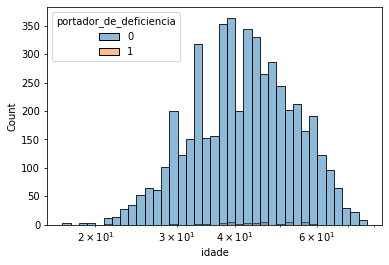

==================Categoria 0


count    4984.000000
mean       43.113363
std        10.697086
min        17.000000
25%        35.000000
50%        42.000000
75%        50.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 1


count    31.000000
mean     44.806452
std       8.806889
min      21.000000
25%      40.000000
50%      44.000000
75%      52.000000
max      60.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


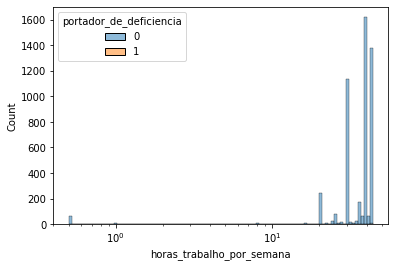

==================Categoria 0


count    4984.000000
mean       36.396770
std         8.434025
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    31.000000
mean     39.096774
std       5.934952
min      24.000000
25%      36.000000
50%      42.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


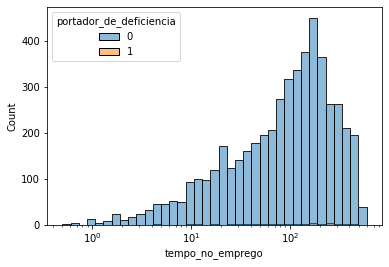

==================Categoria 0


count    4984.000000
mean      137.921730
std       121.431155
min         0.500000
25%        36.900000
50%       106.300000
75%       197.925000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     31.000000
mean     155.416129
std      131.511272
min        4.900000
25%       38.200000
50%      149.900000
75%      243.050000
max      456.800000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a portador_de_deficiencia


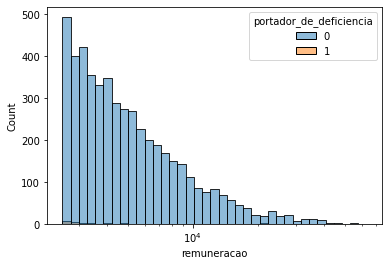

==================Categoria 0


count     4984.000000
mean      6186.793565
std       5264.672256
min       2501.120000
25%       3210.715000
50%       4405.145000
75%       6904.880000
max      63218.070000
Name: remuneracao, dtype: float64

==================Categoria 1


count       31.000000
mean      5402.370645
std       4758.185749
min       2556.480000
25%       2794.875000
50%       3534.930000
75%       5439.095000
max      21293.160000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a portador_de_deficiencia


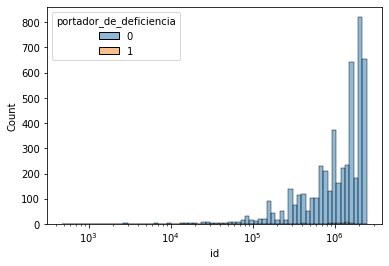

==================Categoria 0


count    4.984000e+03
mean     1.311683e+06
std      7.248037e+05
min      4.770000e+02
25%      7.003118e+05
50%      1.388428e+06
75%      2.008112e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 1


count    3.100000e+01
mean     1.132588e+06
std      5.754313e+05
min      1.044670e+05
25%      7.949825e+05
50%      1.111281e+06
75%      1.489606e+06
max      2.458375e+06
Name: id, dtype: float64

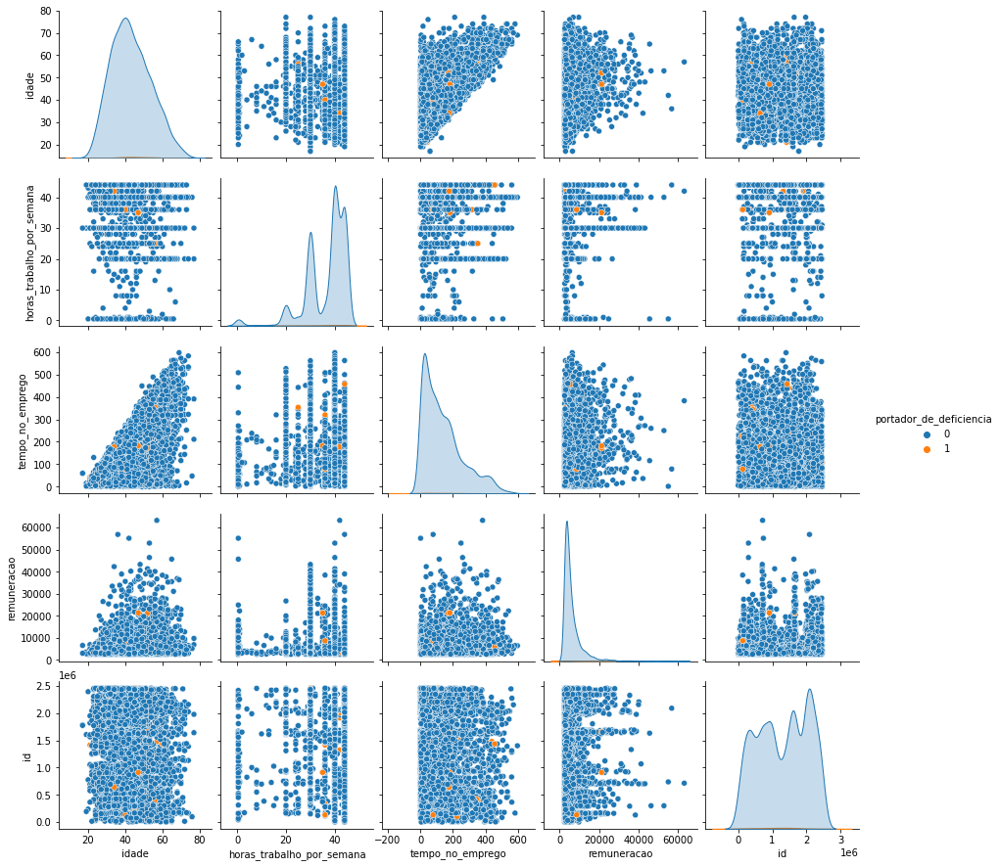

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,2649,0.528215
9,553,0.110269
7,461,0.091924
8,449,0.089531
5,298,0.059422
6,257,0.051246
4,173,0.034497
3,114,0.022732
2,61,0.012164


Grafico de distribuição de idade com relação a tamanho_da_empresa


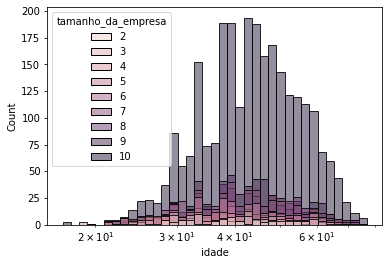

==================Categoria 10


count    2649.000000
mean       44.438279
std        10.499499
min        17.000000
25%        37.000000
50%        44.000000
75%        52.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 3


count    114.000000
mean      39.631579
std       11.199133
min       22.000000
25%       31.000000
50%       38.000000
75%       47.750000
max       70.000000
Name: idade, dtype: float64

==================Categoria 9


count    553.000000
mean      43.327306
std       10.271298
min       22.000000
25%       36.000000
50%       42.000000
75%       50.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 8


count    449.000000
mean      42.881960
std       10.742807
min       22.000000
25%       35.000000
50%       41.000000
75%       51.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 7


count    461.000000
mean      41.713666
std       10.298818
min       21.000000
25%       34.000000
50%       40.000000
75%       49.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 5


count    298.000000
mean      39.567114
std       10.448391
min       20.000000
25%       32.000000
50%       38.000000
75%       46.000000
max       70.000000
Name: idade, dtype: float64

==================Categoria 2


count    61.000000
mean     41.229508
std      10.157745
min      24.000000
25%      32.000000
50%      40.000000
75%      48.000000
max      73.000000
Name: idade, dtype: float64

==================Categoria 6


count    257.000000
mean      41.307393
std       11.595513
min       21.000000
25%       32.000000
50%       40.000000
75%       50.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 4


count    173.000000
mean      38.526012
std       10.601430
min       19.000000
25%       30.000000
50%       37.000000
75%       46.000000
max       66.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


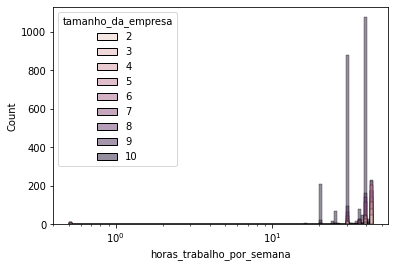

==================Categoria 10


count    2649.000000
mean       34.692525
std         7.033834
min         0.500000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    114.000000
mean      39.434211
std        9.829411
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    553.000000
mean      36.743219
std        9.075622
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    449.000000
mean      38.077951
std        8.571687
min        0.500000
25%       36.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    461.000000
mean      38.193059
std        9.490020
min        0.500000
25%       38.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    298.000000
mean      39.788591
std       10.019960
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    61.000000
mean     40.778689
std       9.619219
min       0.500000
25%      44.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    257.000000
mean      38.297665
std       10.317514
min        0.500000
25%       37.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    173.000000
mean      40.505780
std        8.126898
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


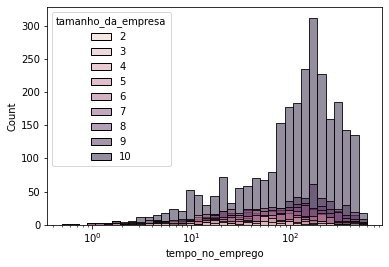

==================Categoria 10


count    2649.000000
mean      161.712193
std       123.338584
min         0.700000
25%        65.700000
50%       142.500000
75%       225.900000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    114.000000
mean      72.654386
std       79.548707
min        0.700000
25%       18.825000
50%       50.900000
75%       90.025000
max      460.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    553.000000
mean     142.128571
std      123.181825
min        0.900000
25%       36.000000
50%      111.500000
75%      199.900000
max      561.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    449.000000
mean     128.055457
std      122.332902
min        0.500000
25%       32.800000
50%       90.400000
75%      188.500000
max      581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    461.000000
mean     102.985249
std      110.381767
min        0.900000
25%       22.900000
50%       59.900000
75%      143.900000
max      561.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    298.000000
mean      86.093624
std       94.137802
min        0.500000
25%       19.325000
50%       55.850000
75%      112.150000
max      507.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     61.000000
mean      85.355738
std      100.706123
min        2.200000
25%       16.900000
50%       54.900000
75%      100.900000
max      442.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    257.000000
mean     102.193774
std      109.499763
min        0.900000
25%       25.900000
50%       62.800000
75%      131.100000
max      517.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    173.000000
mean      85.924855
std       97.848847
min        0.900000
25%       18.500000
50%       57.900000
75%      115.300000
max      447.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a tamanho_da_empresa


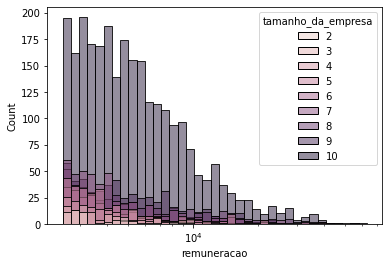

==================Categoria 10


count     2649.000000
mean      6515.547758
std       5278.068709
min       2501.120000
25%       3452.290000
50%       4882.170000
75%       7468.670000
max      63218.070000
Name: remuneracao, dtype: float64

==================Categoria 3


count      114.000000
mean      4618.570614
std       2900.175324
min       2513.470000
25%       2957.427500
50%       3469.480000
75%       5330.492500
max      22445.450000
Name: remuneracao, dtype: float64

==================Categoria 9


count      553.000000
mean      6454.707758
std       5647.292449
min       2506.900000
25%       3234.820000
50%       4521.040000
75%       7254.860000
max      55122.470000
Name: remuneracao, dtype: float64

==================Categoria 8


count      449.000000
mean      6883.537617
std       6529.440840
min       2504.070000
25%       3061.580000
50%       4430.620000
75%       8058.660000
max      56849.230000
Name: remuneracao, dtype: float64

==================Categoria 7


count      461.000000
mean      5415.274100
std       4507.998215
min       2501.340000
25%       3066.850000
50%       3826.010000
75%       5633.910000
max      40067.810000
Name: remuneracao, dtype: float64

==================Categoria 5


count      298.000000
mean      4939.872148
std       3885.447721
min       2510.390000
25%       2964.937500
50%       3626.360000
75%       5034.927500
max      32972.390000
Name: remuneracao, dtype: float64

==================Categoria 2


count       61.000000
mean      4274.522951
std       2404.509114
min       2503.850000
25%       2806.570000
50%       3149.050000
75%       4790.810000
max      13582.690000
Name: remuneracao, dtype: float64

==================Categoria 6


count      257.000000
mean      5577.585759
std       5501.187288
min       2502.520000
25%       2963.150000
50%       3652.970000
75%       5374.660000
max      40019.740000
Name: remuneracao, dtype: float64

==================Categoria 4


count      173.000000
mean      5164.040925
std       4446.548067
min       2525.690000
25%       2942.830000
50%       3756.240000
75%       5464.720000
max      38947.500000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a tamanho_da_empresa


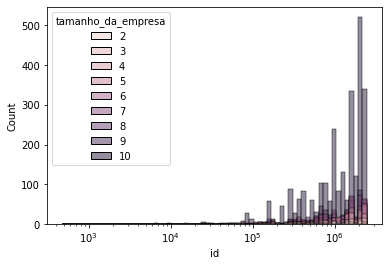

==================Categoria 10


count    2.649000e+03
mean     1.350821e+06
std      7.211680e+05
min      2.947000e+03
25%      7.264270e+05
50%      1.496413e+06
75%      2.021331e+06
max      2.459844e+06
Name: id, dtype: float64

==================Categoria 3


count    1.140000e+02
mean     1.199621e+06
std      7.702651e+05
min      2.029000e+04
25%      4.763425e+05
50%      1.273812e+06
75%      1.936849e+06
max      2.427336e+06
Name: id, dtype: float64

==================Categoria 9


count    5.530000e+02
mean     1.260905e+06
std      7.001859e+05
min      4.770000e+02
25%      6.764570e+05
50%      1.299257e+06
75%      1.975413e+06
max      2.456732e+06
Name: id, dtype: float64

==================Categoria 8


count    4.490000e+02
mean     1.281308e+06
std      7.116561e+05
min      1.278000e+04
25%      6.937710e+05
50%      1.328643e+06
75%      1.986638e+06
max      2.457533e+06
Name: id, dtype: float64

==================Categoria 7


count    4.610000e+02
mean     1.269779e+06
std      7.114440e+05
min      1.649100e+04
25%      6.828180e+05
50%      1.287612e+06
75%      1.833449e+06
max      2.459357e+06
Name: id, dtype: float64

==================Categoria 5


count    2.980000e+02
mean     1.287273e+06
std      7.635352e+05
min      6.480000e+02
25%      6.310142e+05
50%      1.387888e+06
75%      1.983788e+06
max      2.458064e+06
Name: id, dtype: float64

==================Categoria 2


count    6.100000e+01
mean     1.166797e+06
std      6.825525e+05
min      7.520400e+04
25%      5.568120e+05
50%      1.028482e+06
75%      1.749117e+06
max      2.337113e+06
Name: id, dtype: float64

==================Categoria 6


count    2.570000e+02
mean     1.307211e+06
std      7.420494e+05
min      1.671000e+03
25%      6.521950e+05
50%      1.369015e+06
75%      2.027723e+06
max      2.457687e+06
Name: id, dtype: float64

==================Categoria 4


count    1.730000e+02
mean     1.206752e+06
std      7.646244e+05
min      4.272000e+03
25%      5.288130e+05
50%      1.259530e+06
75%      1.845224e+06
max      2.456208e+06
Name: id, dtype: float64

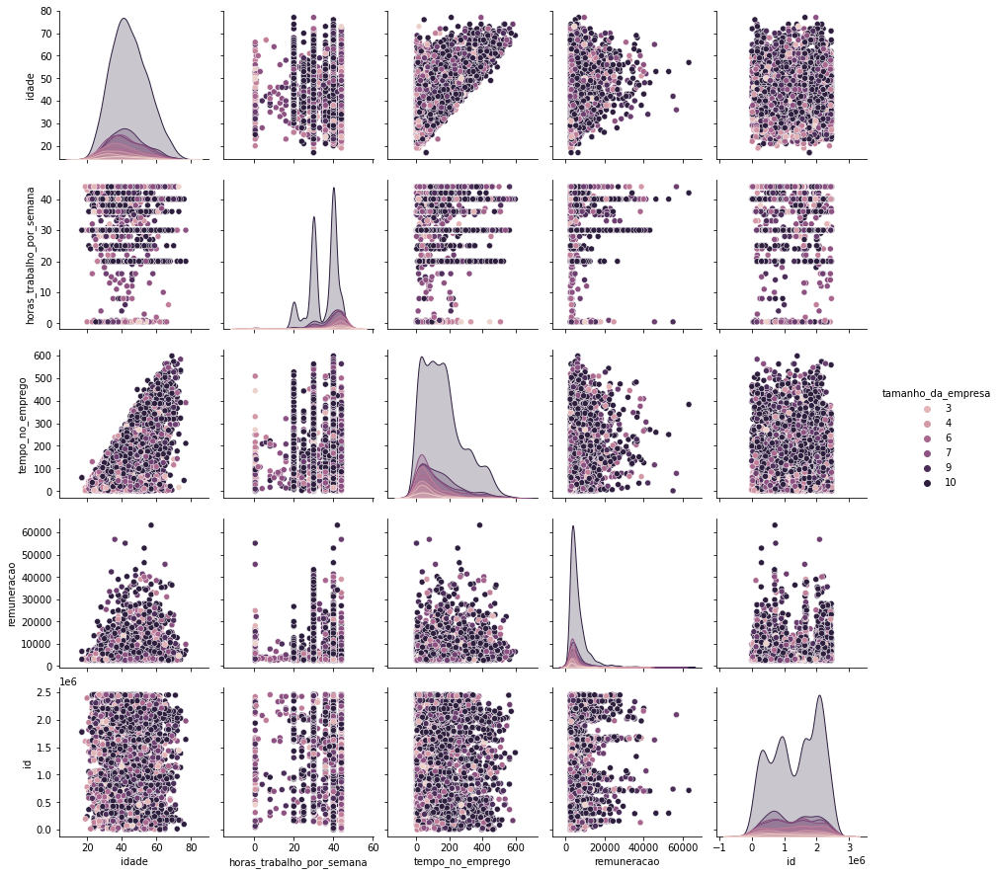

In [ ]:
def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = renda_alta.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = renda_alta.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([renda_alta[i].value_counts(), renda_alta[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(dad, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()
  

================sexo=============


,sexo,sexo
1,5932,0.594091
2,4053,0.405909


Grafico de distribuição de idade com relação a sexo


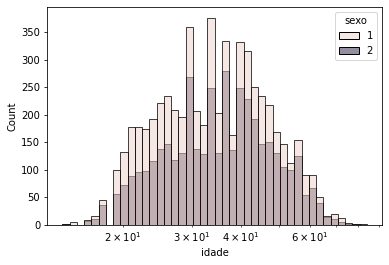

==================Categoria 2


count    4053.000000
mean       36.663706
std        11.238778
min        14.000000
25%        28.000000
50%        36.000000
75%        44.000000
max        84.000000
Name: idade, dtype: float64

==================Categoria 1


count    5932.000000
mean       35.775792
std        11.376808
min        14.000000
25%        26.000000
50%        34.000000
75%        43.000000
max        80.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


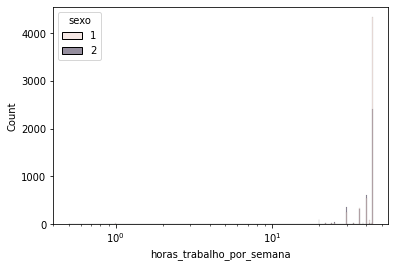

==================Categoria 2


count    4053.000000
mean       39.572662
std         7.561591
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    5932.000000
mean       41.236851
std         6.530039
min         0.500000
25%        41.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


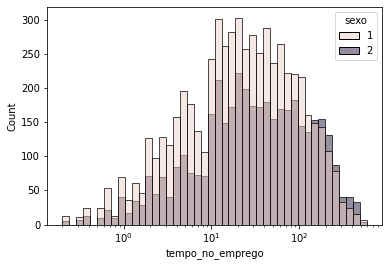

==================Categoria 2


count    4053.000000
mean       65.407895
std        83.339030
min         0.200000
25%        10.900000
50%        29.900000
75%        88.700000
max       532.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count    5932.000000
mean       49.003962
std        67.250998
min         0.200000
25%         7.500000
50%        22.100000
75%        61.700000
max       589.300000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a sexo


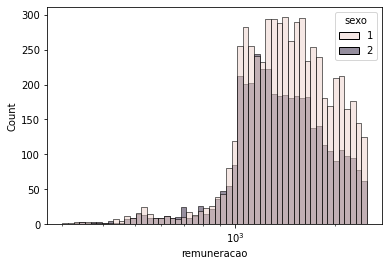

==================Categoria 2


count    4053.000000
mean     1434.105505
std       424.525316
min       331.300000
25%      1133.330000
50%      1360.970000
75%      1698.360000
max      2499.930000
Name: remuneracao, dtype: float64

==================Categoria 1


count    5932.000000
mean     1502.034107
std       436.577092
min       301.430000
25%      1170.557500
50%      1442.710000
75%      1798.487500
max      2499.350000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a sexo


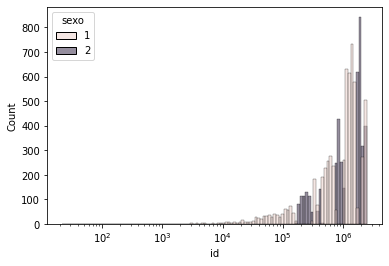

==================Categoria 2


count    4.053000e+03
mean     1.350561e+06
std      7.297650e+05
min      1.728660e+05
25%      7.951380e+05
50%      1.719542e+06
75%      1.923951e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 1


count    5.932000e+03
mean     1.080394e+06
std      6.505780e+05
min      2.200000e+01
25%      5.441532e+05
50%      1.166607e+06
75%      1.463001e+06
max      2.350277e+06
Name: id, dtype: float64

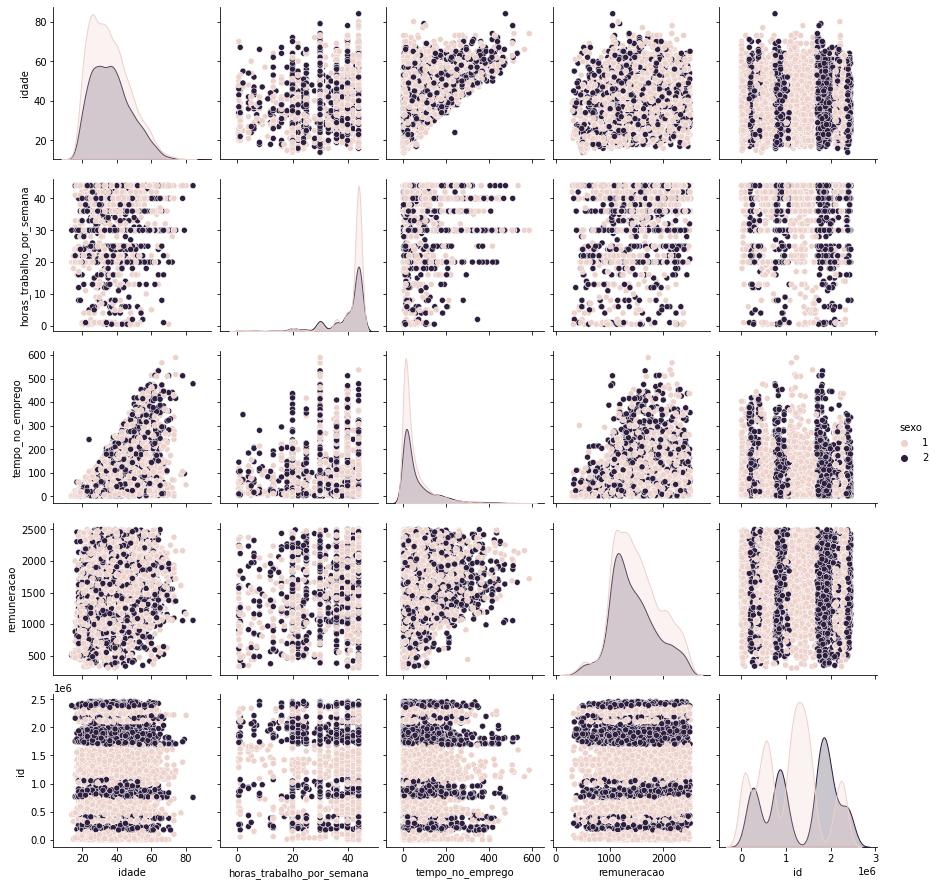

================faixa_etaria=============


,faixa_etaria,faixa_etaria
5,3159,0.316375
6,2184,0.218728
4,1674,0.167651
3,1556,0.155834
7,1253,0.125488
8,112,0.011217
2,45,0.004507
1,2,0.000200


Grafico de distribuição de idade com relação a faixa_etaria


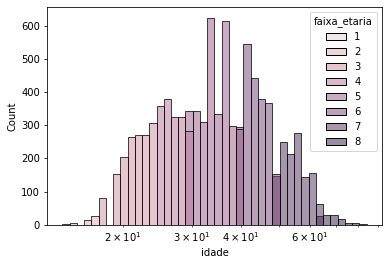

==================Categoria 7


count    1253.000000
mean       55.263368
std         3.957551
min        50.000000
25%        52.000000
50%        55.000000
75%        58.000000
max        64.000000
Name: idade, dtype: float64

==================Categoria 4


count    1674.000000
mean       26.878734
std         1.393860
min        25.000000
25%        26.000000
50%        27.000000
75%        28.000000
max        29.000000
Name: idade, dtype: float64

==================Categoria 6


count    2184.000000
mean       43.918498
std         2.863316
min        40.000000
25%        41.000000
50%        44.000000
75%        46.000000
max        49.000000
Name: idade, dtype: float64

==================Categoria 5


count    3159.000000
mean       34.359924
std         2.868766
min        30.000000
25%        32.000000
50%        34.000000
75%        37.000000
max        39.000000
Name: idade, dtype: float64

==================Categoria 3


count    1556.000000
mean       21.633033
std         1.801297
min        18.000000
25%        20.000000
50%        22.000000
75%        23.000000
max        24.000000
Name: idade, dtype: float64

==================Categoria 8


count    112.000000
mean      68.633929
std        3.746459
min       65.000000
25%       66.000000
50%       67.500000
75%       70.000000
max       84.000000
Name: idade, dtype: float64

==================Categoria 2


count    45.000000
mean     16.511111
std       0.661342
min      15.000000
25%      16.000000
50%      17.000000
75%      17.000000
max      17.000000
Name: idade, dtype: float64

==================Categoria 1


count     2.0
mean     14.0
std       0.0
min      14.0
25%      14.0
50%      14.0
75%      14.0
max      14.0
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


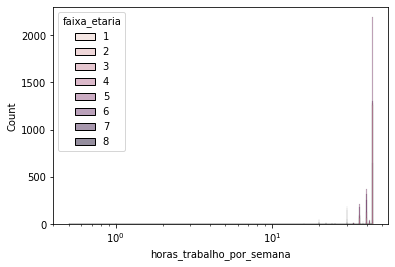

==================Categoria 7


count    1253.000000
mean       39.374302
std         6.964822
min         0.500000
25%        36.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    1674.000000
mean       41.511649
std         6.505091
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    2184.000000
mean       39.849817
std         7.216143
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    3159.000000
mean       40.961538
std         6.644401
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    1556.000000
mean       41.428342
std         7.005843
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    112.000000
mean      36.174107
std        8.929077
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    45.000000
mean     26.333333
std       9.052875
min      16.000000
25%      20.000000
50%      22.000000
75%      30.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     2.000000
mean     25.000000
std       7.071068
min      20.000000
25%      22.500000
50%      25.000000
75%      27.500000
max      30.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


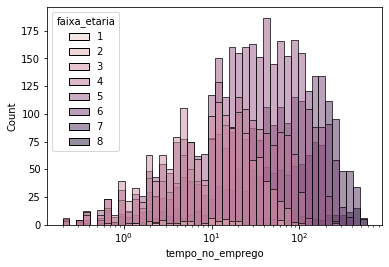

==================Categoria 7


count    1253.000000
mean      127.298883
std       117.980594
min         0.300000
25%        28.200000
50%        92.900000
75%       202.900000
max       536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    1674.000000
mean       26.949761
std        26.161169
min         0.200000
25%         6.900000
50%        17.900000
75%        38.650000
max       130.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    2184.000000
mean       73.625504
std        73.871174
min         0.200000
25%        14.600000
50%        45.550000
75%       118.050000
max       358.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    3159.000000
mean       45.234315
std        47.295895
min         0.200000
25%        10.350000
50%        27.600000
75%        65.900000
max       256.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    1556.000000
mean       14.140167
std        15.673357
min         0.200000
25%         3.700000
50%         9.800000
75%        19.600000
max       240.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    112.000000
mean     222.150893
std      162.747413
min        0.500000
25%       69.325000
50%      217.550000
75%      361.925000
max      589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    45.000000
mean     13.120000
std      15.904039
min       0.600000
25%       2.900000
50%       9.400000
75%      15.400000
max      59.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count    2.000000
mean     1.800000
std      0.565685
min      1.400000
25%      1.600000
50%      1.800000
75%      2.000000
max      2.200000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a faixa_etaria


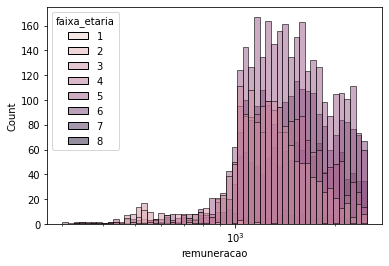

==================Categoria 7


count    1253.000000
mean     1557.136049
std       436.242626
min       343.830000
25%      1219.370000
50%      1528.030000
75%      1863.410000
max      2494.080000
Name: remuneracao, dtype: float64

==================Categoria 4


count    1674.000000
mean     1426.992527
std       399.468141
min       348.260000
25%      1131.290000
50%      1358.485000
75%      1670.725000
max      2499.350000
Name: remuneracao, dtype: float64

==================Categoria 6


count    2184.000000
mean     1563.762088
std       437.825332
min       327.040000
25%      1211.722500
50%      1514.005000
75%      1872.467500
max      2497.680000
Name: remuneracao, dtype: float64

==================Categoria 5


count    3159.000000
mean     1507.918474
std       429.611730
min       301.430000
25%      1177.535000
50%      1439.630000
75%      1801.010000
max      2499.930000
Name: remuneracao, dtype: float64

==================Categoria 3


count    1556.000000
mean     1281.889569
std       377.487027
min       320.270000
25%      1055.962500
50%      1242.065000
75%      1474.350000
max      2497.310000
Name: remuneracao, dtype: float64

==================Categoria 8


count     112.000000
mean     1538.777946
std       415.452320
min       519.360000
25%      1246.665000
50%      1497.865000
75%      1888.522500
max      2497.780000
Name: remuneracao, dtype: float64

==================Categoria 2


count      45.000000
mean      796.552222
std       489.922626
min       466.530000
25%       516.500000
50%       536.290000
75%       889.530000
max      2458.510000
Name: remuneracao, dtype: float64

==================Categoria 1


count      2.00000
mean     519.98000
std       24.56489
min      502.61000
25%      511.29500
50%      519.98000
75%      528.66500
max      537.35000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a faixa_etaria


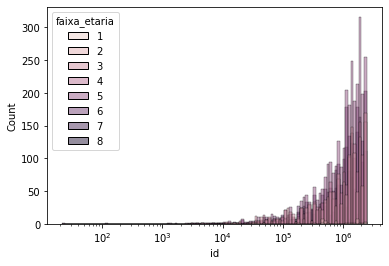

==================Categoria 7


count    1.253000e+03
mean     1.221875e+06
std      6.860477e+05
min      1.150000e+02
25%      6.838470e+05
50%      1.199153e+06
75%      1.759097e+06
max      2.455200e+06
Name: id, dtype: float64

==================Categoria 4


count    1.674000e+03
mean     1.195684e+06
std      7.040777e+05
min      3.195000e+03
25%      5.908678e+05
50%      1.232432e+06
75%      1.809716e+06
max      2.457833e+06
Name: id, dtype: float64

==================Categoria 6


count    2.184000e+03
mean     1.185227e+06
std      6.907333e+05
min      1.397000e+03
25%      6.022498e+05
50%      1.157581e+06
75%      1.762650e+06
max      2.458471e+06
Name: id, dtype: float64

==================Categoria 5


count    3.159000e+03
mean     1.205058e+06
std      6.879116e+05
min      2.200000e+01
25%      6.073480e+05
50%      1.221399e+06
75%      1.797150e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 3


count    1.556000e+03
mean     1.143083e+06
std      7.236136e+05
min      4.815000e+03
25%      5.074305e+05
50%      1.187510e+06
75%      1.751836e+06
max      2.451626e+06
Name: id, dtype: float64

==================Categoria 8


count    1.120000e+02
mean     1.170357e+06
std      6.047889e+05
min      6.847000e+03
25%      7.556680e+05
50%      1.144710e+06
75%      1.706184e+06
max      2.224773e+06
Name: id, dtype: float64

==================Categoria 2


count    4.500000e+01
mean     9.394341e+05
std      7.415481e+05
min      1.371800e+04
25%      4.763600e+05
50%      5.626280e+05
75%      1.744202e+06
max      2.362464e+06
Name: id, dtype: float64

==================Categoria 1


count    2.000000e+00
mean     1.416436e+06
std      1.369908e+06
min      4.477640e+05
25%      9.320998e+05
50%      1.416436e+06
75%      1.900771e+06
max      2.385107e+06
Name: id, dtype: float64

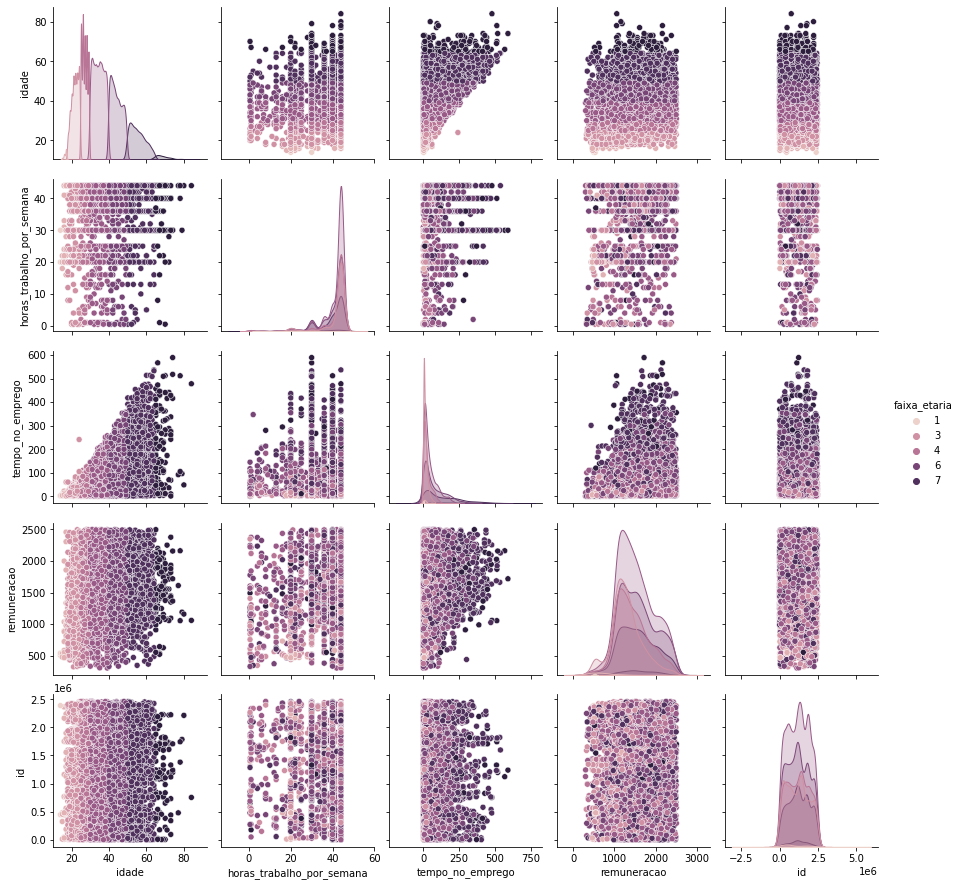

================cor_raca=============


,cor_raca,cor_raca
8,5304,0.531197
99,1956,0.195894
9,1397,0.139910
2,1005,0.100651
4,253,0.025338
6,56,0.005608
1,14,0.001402


Grafico de distribuição de idade com relação a cor_raca


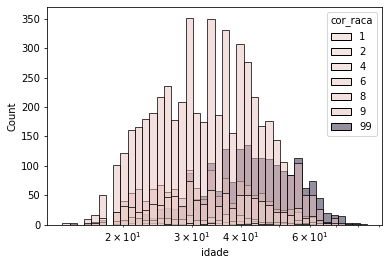

==================Categoria 99


count    1956.000000
mean       43.336912
std        11.503563
min        17.000000
25%        35.000000
50%        42.000000
75%        51.250000
max        84.000000
Name: idade, dtype: float64

==================Categoria 8


count    5304.000000
mean       34.429487
std        10.512222
min        14.000000
25%        26.000000
50%        33.000000
75%        41.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 9


count    1397.000000
mean       33.746600
std        10.259048
min        15.000000
25%        25.000000
50%        32.000000
75%        40.000000
max        66.000000
Name: idade, dtype: float64

==================Categoria 2


count    1005.000000
mean       34.969154
std        10.995021
min        17.000000
25%        26.000000
50%        33.000000
75%        42.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 4


count    253.000000
mean      33.494071
std       11.203606
min       16.000000
25%       25.000000
50%       31.000000
75%       40.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 6


count    56.000000
mean     37.803571
std      11.283809
min      19.000000
25%      28.750000
50%      37.500000
75%      44.000000
max      64.000000
Name: idade, dtype: float64

==================Categoria 1


count    14.000000
mean     40.000000
std      10.228166
min      26.000000
25%      32.250000
50%      40.500000
75%      45.250000
max      59.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


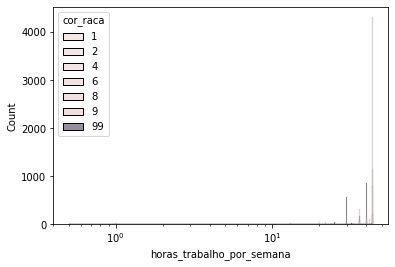

==================Categoria 99


count    1956.000000
mean       35.847137
std         6.619482
min         1.000000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    5304.000000
mean       41.686652
std         6.685441
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    1397.000000
mean       42.017180
std         5.992897
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    1005.000000
mean       41.334328
std         7.219466
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    253.000000
mean      42.181818
std        5.277098
min        5.000000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    56.000000
mean     41.482143
std       7.368214
min       1.000000
25%      44.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    14.000000
mean     39.142857
std      11.162142
min       5.000000
25%      42.500000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


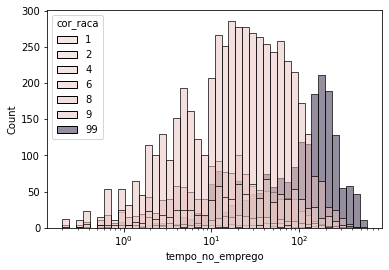

==================Categoria 99


count    1956.000000
mean      133.733845
std       109.467625
min         0.200000
25%        37.700000
50%       117.800000
75%       197.900000
max       589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    5304.000000
mean       37.576075
std        46.121162
min         0.200000
25%         6.900000
50%        20.600000
75%        50.900000
max       417.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    1397.000000
mean       25.623980
std        35.030786
min         0.200000
25%         4.900000
50%        13.800000
75%        30.500000
max       436.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    1005.000000
mean       45.988060
std        57.005233
min         0.200000
25%         9.900000
50%        24.900000
75%        61.900000
max       536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    253.000000
mean      36.385771
std       47.273481
min        0.300000
25%        7.800000
50%       19.900000
75%       44.900000
max      376.700000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     56.000000
mean      51.471429
std       62.286516
min        0.300000
25%       11.900000
50%       28.850000
75%       58.900000
max      263.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     14.00000
mean      57.15000
std       60.99745
min        4.60000
25%       15.10000
50%       34.10000
75%       73.40000
max      230.70000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a cor_raca


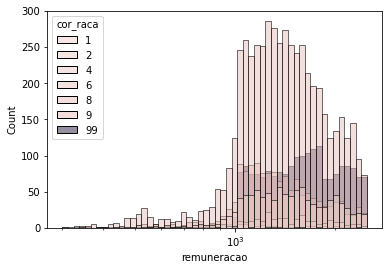

==================Categoria 99


count    1956.000000
mean     1621.479734
std       430.809484
min       331.300000
25%      1260.022500
50%      1591.985000
75%      1950.030000
max      2499.930000
Name: remuneracao, dtype: float64

==================Categoria 8


count    5304.000000
mean     1442.813009
std       427.258927
min       304.290000
25%      1138.737500
50%      1383.380000
75%      1709.425000
max      2499.350000
Name: remuneracao, dtype: float64

==================Categoria 9


count    1397.000000
mean     1388.037810
std       415.307012
min       320.270000
25%      1102.470000
50%      1305.560000
75%      1620.690000
max      2497.680000
Name: remuneracao, dtype: float64

==================Categoria 2


count    1005.000000
mean     1484.028438
std       427.641343
min       301.430000
25%      1161.370000
50%      1426.500000
75%      1783.000000
max      2497.310000
Name: remuneracao, dtype: float64

==================Categoria 4


count     253.000000
mean     1460.420751
std       423.416932
min       488.960000
25%      1160.500000
50%      1395.790000
75%      1709.750000
max      2493.150000
Name: remuneracao, dtype: float64

==================Categoria 6


count      56.000000
mean     1417.700179
std       442.133311
min       549.390000
25%      1081.432500
50%      1294.035000
75%      1764.585000
max      2403.760000
Name: remuneracao, dtype: float64

==================Categoria 1


count      14.000000
mean     1341.879286
std       391.790691
min       873.230000
25%      1038.597500
50%      1294.920000
75%      1501.180000
max      2373.890000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a cor_raca


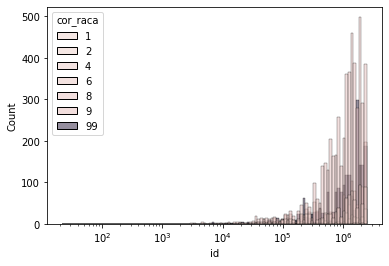

==================Categoria 99


count    1.956000e+03
mean     1.243599e+06
std      7.045174e+05
min      1.187000e+03
25%      6.687952e+05
50%      1.226514e+06
75%      1.798626e+06
max      2.455774e+06
Name: id, dtype: float64

==================Categoria 8


count    5.304000e+03
mean     1.198646e+06
std      6.514689e+05
min      1.150000e+02
25%      6.500655e+05
50%      1.209756e+06
75%      1.740876e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 9


count    1.397000e+03
mean     1.144637e+06
std      7.904255e+05
min      3.360000e+03
25%      3.533750e+05
50%      1.128392e+06
75%      1.870602e+06
max      2.457804e+06
Name: id, dtype: float64

==================Categoria 2


count    1.005000e+03
mean     1.119095e+06
std      7.301104e+05
min      2.200000e+01
25%      4.609230e+05
50%      1.171771e+06
75%      1.758117e+06
max      2.458733e+06
Name: id, dtype: float64

==================Categoria 4


count    2.530000e+02
mean     1.154914e+06
std      7.909837e+05
min      3.660000e+03
25%      3.199200e+05
50%      1.188293e+06
75%      1.794909e+06
max      2.420787e+06
Name: id, dtype: float64

==================Categoria 6


count    5.600000e+01
mean     1.044935e+06
std      8.027067e+05
min      1.761000e+03
25%      3.192402e+05
50%      8.197410e+05
75%      1.797570e+06
max      2.416691e+06
Name: id, dtype: float64

==================Categoria 1


count    1.400000e+01
mean     1.297634e+06
std      7.280808e+05
min      1.201830e+05
25%      7.622352e+05
50%      1.493328e+06
75%      1.791495e+06
max      2.172930e+06
Name: id, dtype: float64

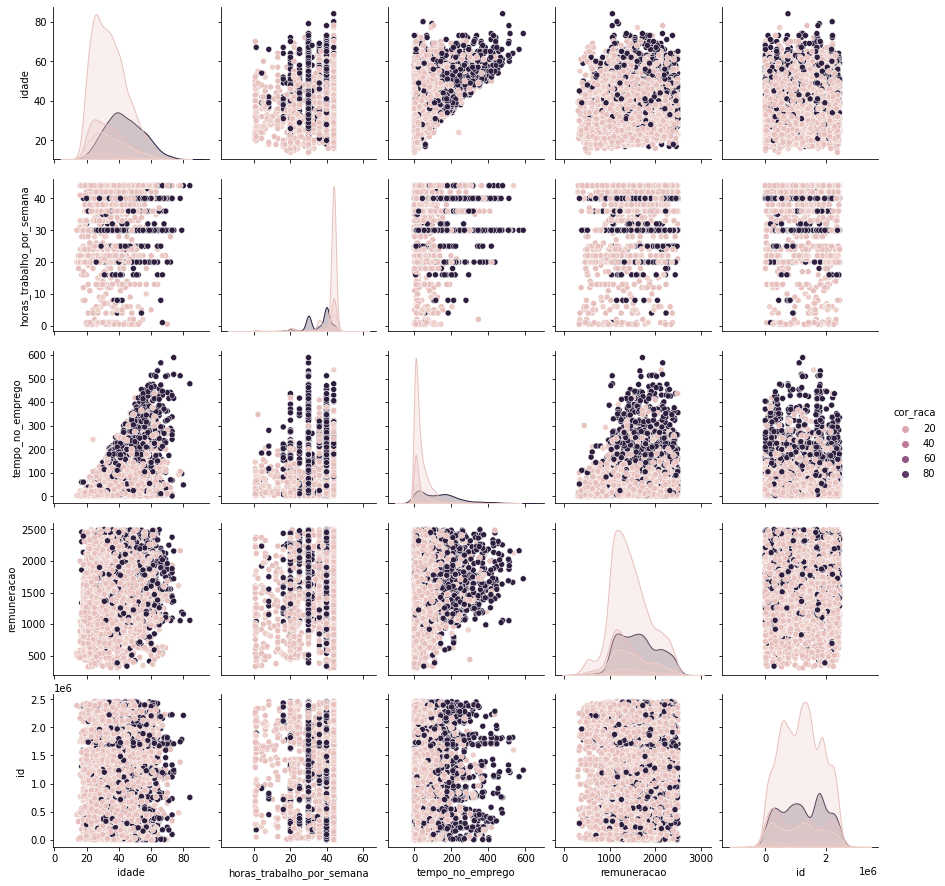

================escolaridade=============


,escolaridade,escolaridade
7,6290,0.629945
9,887,0.088833
5,805,0.080621
6,664,0.066500
4,509,0.050976
...,...,...
2,275,0.027541
3,188,0.018828
1,48,0.004807
10,15,0.001502


Grafico de distribuição de idade com relação a escolaridade


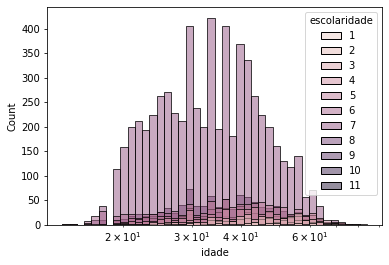

==================Categoria 7


count    6290.000000
mean       34.746105
std        10.578133
min        14.000000
25%        26.000000
50%        33.000000
75%        42.000000
max        79.000000
Name: idade, dtype: float64

==================Categoria 4


count    509.000000
mean      41.595285
std       12.900332
min       14.000000
25%       31.000000
50%       41.000000
75%       50.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 6


count    664.000000
mean      34.527108
std       12.587762
min       15.000000
25%       25.000000
50%       33.000000
75%       43.000000
max       78.000000
Name: idade, dtype: float64

==================Categoria 8


count    295.000000
mean      30.376271
std        9.426990
min       18.000000
25%       23.000000
50%       28.000000
75%       36.000000
max       69.000000
Name: idade, dtype: float64

==================Categoria 2


count    275.000000
mean      43.778182
std       11.316848
min       19.000000
25%       35.000000
50%       43.000000
75%       53.000000
max       70.000000
Name: idade, dtype: float64

==================Categoria 5


count    805.000000
mean      39.668323
std       11.658407
min       15.000000
25%       31.000000
50%       39.000000
75%       48.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 9


count    887.000000
mean      38.259301
std       10.345518
min       20.000000
25%       30.000000
50%       36.000000
75%       45.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 3


count    188.000000
mean      43.319149
std       12.498738
min       20.000000
25%       34.000000
50%       42.000000
75%       51.000000
max       84.000000
Name: idade, dtype: float64

==================Categoria 10


count    15.000000
mean     40.200000
std       9.221094
min      26.000000
25%      32.500000
50%      39.000000
75%      47.500000
max      55.000000
Name: idade, dtype: float64

==================Categoria 11


count     9.000000
mean     44.666667
std      10.931606
min      27.000000
25%      41.000000
50%      45.000000
75%      49.000000
max      61.000000
Name: idade, dtype: float64

==================Categoria 1


count    48.000000
mean     44.812500
std      13.225791
min      19.000000
25%      35.000000
50%      44.000000
75%      54.250000
max      80.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


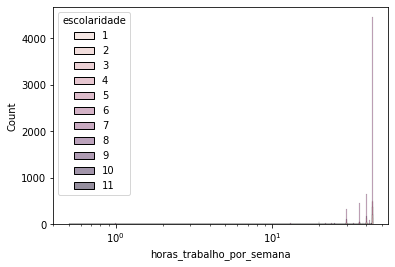

==================Categoria 7


count    6290.000000
mean       41.222099
std         6.072182
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    509.000000
mean      41.130648
std        5.848238
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    664.000000
mean      40.264307
std        7.653198
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    295.000000
mean      40.454237
std        8.038731
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    275.000000
mean      41.785455
std        5.114864
min        8.000000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    805.000000
mean      40.500000
std        6.294493
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    887.000000
mean      35.481398
std       10.788833
min        1.000000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    188.000000
mean      41.904255
std        4.551709
min       20.000000
25%       41.500000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    15.000000
mean     24.766667
std      18.601907
min       0.500000
25%       7.000000
50%      24.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count     9.000000
mean     32.888889
std      11.185308
min       6.000000
25%      30.000000
50%      40.000000
75%      40.000000
max      40.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    48.000000
mean     41.708333
std       5.347333
min      16.000000
25%      43.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


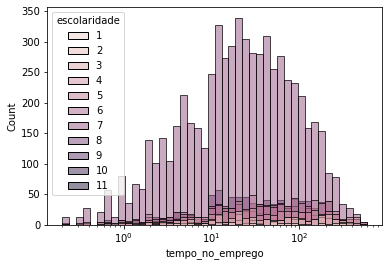

==================Categoria 7


count    6290.000000
mean       47.499793
std        64.889248
min         0.200000
25%         7.600000
50%        21.900000
75%        59.900000
max       532.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    509.000000
mean      87.380550
std      106.794297
min        0.200000
25%       13.300000
50%       39.500000
75%      120.900000
max      566.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    664.000000
mean      58.136446
std       79.199949
min        0.300000
25%       10.050000
50%       28.350000
75%       73.800000
max      589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    295.000000
mean      38.951864
std       58.436628
min        0.200000
25%        8.400000
50%       18.400000
75%       40.600000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    275.000000
mean      75.031273
std       88.662075
min        0.700000
25%       11.300000
50%       30.800000
75%      108.900000
max      403.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    805.000000
mean      77.125963
std       90.645246
min        0.200000
25%       12.200000
50%       37.300000
75%      111.900000
max      517.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    887.000000
mean      63.112965
std       75.034859
min        0.200000
25%       10.900000
50%       30.700000
75%       92.200000
max      453.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    188.000000
mean     100.539894
std      105.506155
min        0.700000
25%       15.275000
50%       65.050000
75%      163.325000
max      477.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count     15.000000
mean      62.493333
std       52.379378
min        3.400000
25%       22.200000
50%       58.900000
75%       97.800000
max      187.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count      9.000000
mean      73.200000
std       51.076438
min       21.200000
25%       23.700000
50%       71.100000
75%      107.000000
max      146.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     48.000000
mean      67.645833
std       87.350719
min        0.500000
25%       11.200000
50%       30.100000
75%       78.750000
max      335.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a escolaridade


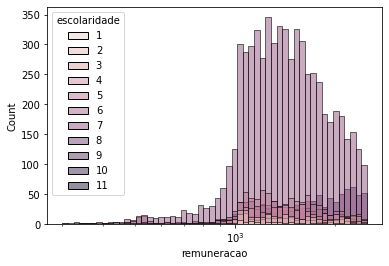

==================Categoria 7


count    6290.000000
mean     1463.518738
std       417.961336
min       320.270000
25%      1154.590000
50%      1399.775000
75%      1731.710000
max      2498.470000
Name: remuneracao, dtype: float64

==================Categoria 4


count     509.000000
mean     1467.522593
std       411.631696
min       301.430000
25%      1161.730000
50%      1413.860000
75%      1694.120000
max      2497.780000
Name: remuneracao, dtype: float64

==================Categoria 6


count     664.000000
mean     1360.282786
std       437.369381
min       304.290000
25%      1079.582500
50%      1315.280000
75%      1650.710000
max      2497.310000
Name: remuneracao, dtype: float64

==================Categoria 8


count     295.000000
mean     1472.856644
std       462.450682
min       369.780000
25%      1146.815000
50%      1446.210000
75%      1780.225000
max      2493.270000
Name: remuneracao, dtype: float64

==================Categoria 2


count     275.000000
mean     1451.199527
std       403.986444
min       490.160000
25%      1101.640000
50%      1364.370000
75%      1722.830000
max      2475.670000
Name: remuneracao, dtype: float64

==================Categoria 5


count     805.000000
mean     1439.544137
std       392.532294
min       348.260000
25%      1152.450000
50%      1371.750000
75%      1672.580000
max      2489.540000
Name: remuneracao, dtype: float64

==================Categoria 9


count     887.000000
mean     1684.715017
std       512.198204
min       331.300000
25%      1276.850000
50%      1731.810000
75%      2134.155000
max      2499.930000
Name: remuneracao, dtype: float64

==================Categoria 3


count     188.000000
mean     1471.947979
std       397.036081
min       507.100000
25%      1133.060000
50%      1390.365000
75%      1726.255000
max      2444.350000
Name: remuneracao, dtype: float64

==================Categoria 10


count      15.000000
mean     1411.902667
std       659.825504
min       343.830000
25%      1013.550000
50%      1455.170000
75%      1917.210000
max      2407.660000
Name: remuneracao, dtype: float64

==================Categoria 11


count       9.000000
mean     2078.377778
std       401.865436
min      1312.340000
25%      1975.810000
50%      2153.340000
75%      2401.520000
max      2485.600000
Name: remuneracao, dtype: float64

==================Categoria 1


count      48.000000
mean     1321.006458
std       334.154023
min       829.590000
25%      1069.760000
50%      1253.780000
75%      1478.812500
max      2231.330000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a escolaridade


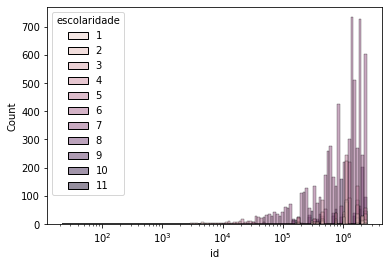

==================Categoria 7


count    6.290000e+03
mean     1.193027e+06
std      7.017460e+05
min      4.760700e+04
25%      5.811442e+05
50%      1.323162e+06
75%      1.812310e+06
max      2.416305e+06
Name: id, dtype: float64

==================Categoria 4


count    5.090000e+02
mean     1.100497e+06
std      6.342617e+05
min      1.064300e+04
25%      7.570310e+05
50%      1.132080e+06
75%      1.703719e+06
max      2.356035e+06
Name: id, dtype: float64

==================Categoria 6


count    6.640000e+02
mean     1.040102e+06
std      6.807575e+05
min      3.236500e+04
25%      4.792590e+05
50%      1.232360e+06
75%      1.262545e+06
max      2.363022e+06
Name: id, dtype: float64

==================Categoria 8


count    2.950000e+02
mean     1.344541e+06
std      7.873307e+05
min      1.438010e+05
25%      6.877800e+05
50%      1.598160e+06
75%      1.966086e+06
max      2.420201e+06
Name: id, dtype: float64

==================Categoria 2


count    2.750000e+02
mean     1.139985e+06
std      6.684039e+05
min      1.187000e+03
25%      9.838725e+05
50%      1.094152e+06
75%      1.695068e+06
max      2.354220e+06
Name: id, dtype: float64

==================Categoria 5


count    8.050000e+02
mean     1.140742e+06
std      5.919270e+05
min      2.041200e+04
25%      7.651730e+05
50%      1.184654e+06
75%      1.716811e+06
max      2.360055e+06
Name: id, dtype: float64

==================Categoria 9


count    8.870000e+02
mean     1.370029e+06
std      7.384758e+05
min      1.482520e+05
25%      7.375050e+05
50%      1.074182e+06
75%      2.064924e+06
max      2.458733e+06
Name: id, dtype: float64

==================Categoria 3


count    1.880000e+02
mean     1.007423e+06
std      6.252556e+05
min      6.384000e+03
25%      4.453385e+05
50%      1.106210e+06
75%      1.116099e+06
max      2.354994e+06
Name: id, dtype: float64

==================Categoria 10


count    1.500000e+01
mean     1.610241e+06
std      6.371572e+05
min      3.171130e+05
25%      1.005152e+06
50%      1.691665e+06
75%      2.093858e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 11


count    9.000000e+00
mean     1.003859e+06
std      1.042091e+05
min      7.514500e+05
25%      9.827190e+05
50%      1.030239e+06
75%      1.076093e+06
max      1.077128e+06
Name: id, dtype: float64

==================Categoria 1


count    4.800000e+01
mean     1.282687e+06
std      6.491997e+05
min      2.200000e+01
25%      1.078217e+06
50%      1.080086e+06
75%      1.794269e+06
max      2.352223e+06
Name: id, dtype: float64

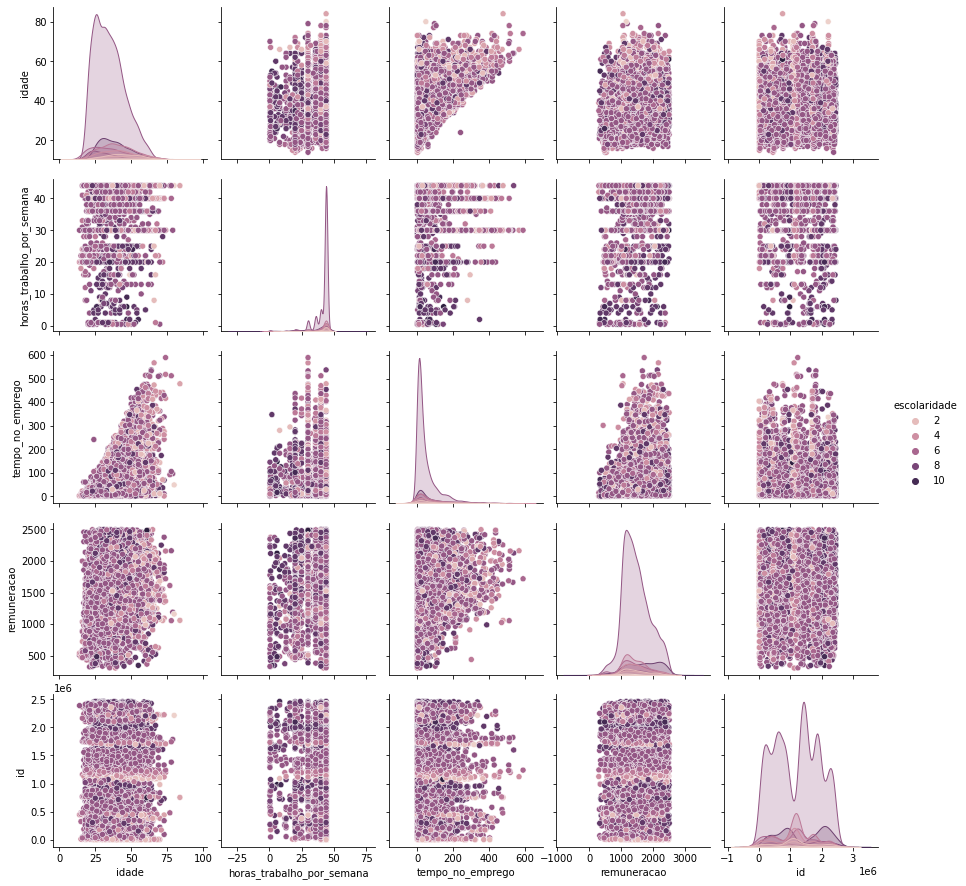

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,9898,0.991287
1,87,0.008713


Grafico de distribuição de idade com relação a portador_de_deficiencia


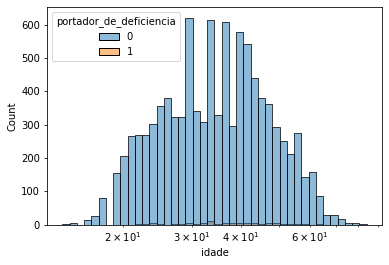

==================Categoria 0


count    9898.000000
mean       36.121136
std        11.333739
min        14.000000
25%        27.000000
50%        35.000000
75%        43.000000
max        84.000000
Name: idade, dtype: float64

==================Categoria 1


count    87.000000
mean     37.850575
std      10.676565
min      22.000000
25%      30.000000
50%      36.000000
75%      44.500000
max      65.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


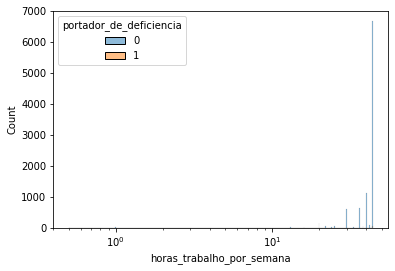

==================Categoria 0


count    9898.000000
mean       40.557082
std         7.017885
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    87.000000
mean     41.045977
std       6.650595
min      12.000000
25%      41.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


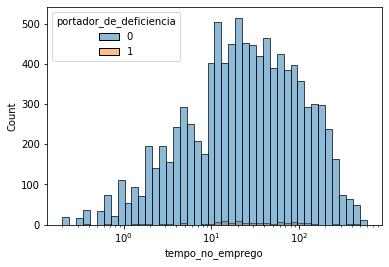

==================Categoria 0


count    9898.000000
mean       55.697141
std        74.673049
min         0.200000
25%         9.700000
50%        24.900000
75%        71.300000
max       589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     87.000000
mean      51.717241
std       70.472075
min        0.400000
25%       12.800000
50%       22.800000
75%       69.400000
max      416.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a portador_de_deficiencia


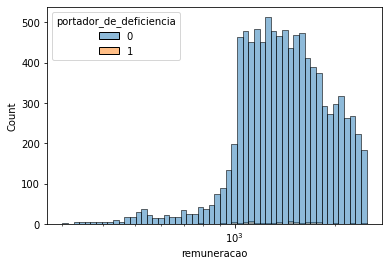

==================Categoria 0


count    9898.000000
mean     1474.860202
std       433.128816
min       301.430000
25%      1153.940000
50%      1410.735000
75%      1761.327500
max      2499.930000
Name: remuneracao, dtype: float64

==================Categoria 1


count      87.000000
mean     1429.076437
std       416.957248
min       535.320000
25%      1103.410000
50%      1420.730000
75%      1687.355000
max      2494.680000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a portador_de_deficiencia


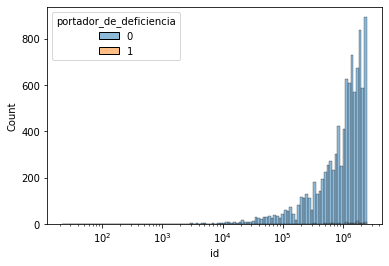

==================Categoria 0


count    9.898000e+03
mean     1.189556e+06
std      6.967063e+05
min      2.200000e+01
25%      5.881282e+05
50%      1.194866e+06
75%      1.774364e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 1


count    8.700000e+01
mean     1.247037e+06
std      6.793442e+05
min      4.692600e+04
25%      6.417700e+05
50%      1.215791e+06
75%      1.753900e+06
max      2.385913e+06
Name: id, dtype: float64

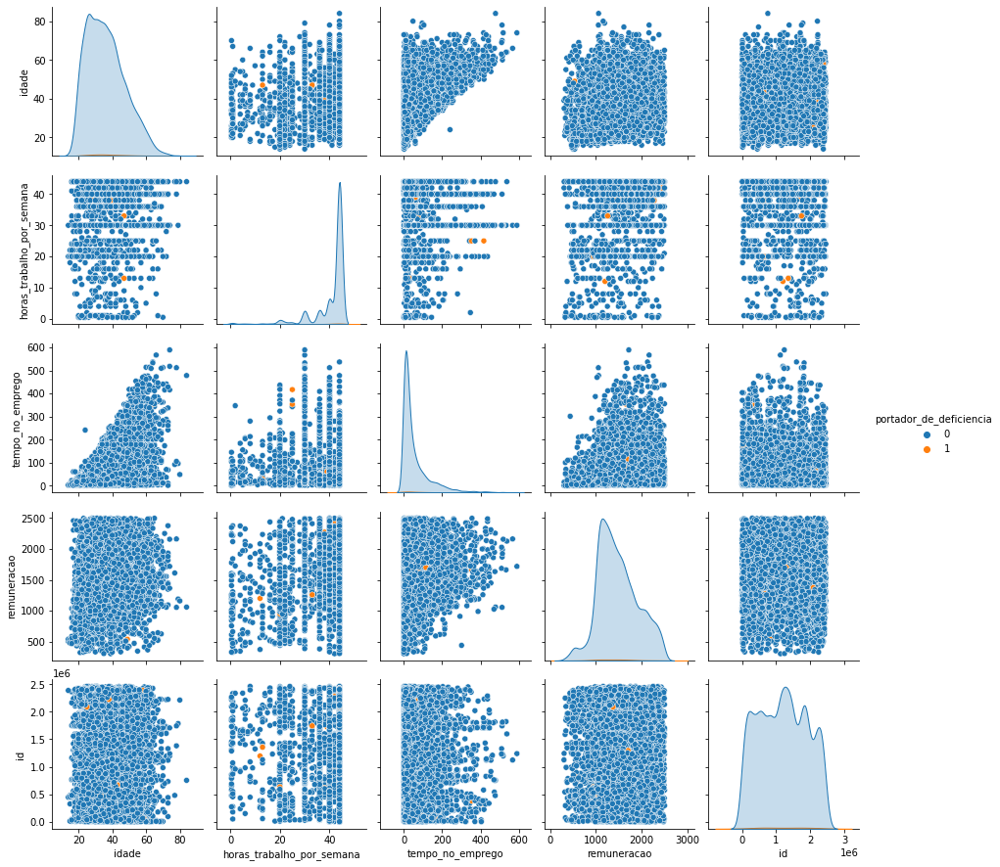

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,2087,0.209014
5,1193,0.119479
7,1111,0.111267
4,1030,0.103155
3,991,0.099249
9,953,0.095443
2,930,0.093140
8,893,0.089434
6,797,0.079820


Grafico de distribuição de idade com relação a tamanho_da_empresa


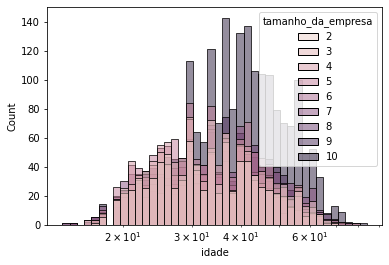

==================Categoria 7


count    1111.000000
mean       35.693069
std        11.644754
min        14.000000
25%        26.000000
50%        34.000000
75%        43.000000
max        80.000000
Name: idade, dtype: float64

==================Categoria 8


count    893.000000
mean      35.941769
std       11.444493
min       15.000000
25%       27.000000
50%       35.000000
75%       43.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 5


count    1193.000000
mean       34.157586
std        10.429307
min        16.000000
25%        26.000000
50%        32.000000
75%        41.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 4


count    1030.000000
mean       33.995146
std        10.689403
min        17.000000
25%        26.000000
50%        32.000000
75%        40.750000
max        73.000000
Name: idade, dtype: float64

==================Categoria 6


count    797.000000
mean      34.712673
std       10.560379
min       15.000000
25%       26.000000
50%       34.000000
75%       41.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 3


count    991.000000
mean      34.518668
std       10.883005
min       17.000000
25%       26.000000
50%       32.000000
75%       42.000000
max       78.000000
Name: idade, dtype: float64

==================Categoria 10


count    2087.000000
mean       39.887398
std        11.692376
min        15.000000
25%        31.000000
50%        39.000000
75%        48.000000
max        84.000000
Name: idade, dtype: float64

==================Categoria 2


count    930.000000
mean      34.997849
std       11.073781
min       16.000000
25%       26.000000
50%       33.000000
75%       41.750000
max       68.000000
Name: idade, dtype: float64

==================Categoria 9


count    953.000000
mean      37.394544
std       11.025450
min       14.000000
25%       29.000000
50%       36.000000
75%       45.000000
max       79.000000
Name: idade, dtype: float64

Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


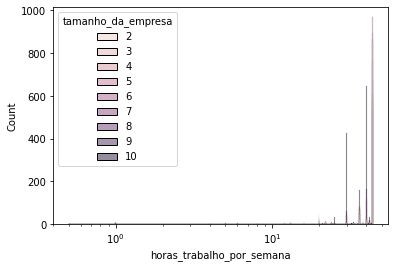

==================Categoria 7


count    1111.000000
mean       40.599910
std         7.358234
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    893.000000
mean      40.286114
std        7.572419
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    1193.000000
mean       41.155071
std         7.931614
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    1030.000000
mean       41.911165
std         6.457164
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    797.000000
mean      40.705772
std        8.076795
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    991.000000
mean      42.950555
std        4.062713
min        1.000000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    2087.000000
mean       37.941064
std         6.409924
min         8.000000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    930.000000
mean      42.682796
std        5.267794
min        1.000000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    953.000000
mean      39.634837
std        7.600166
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


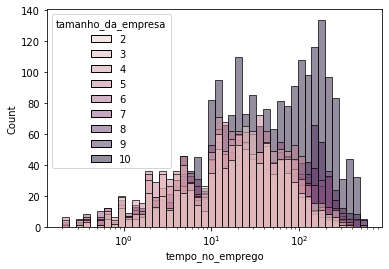

==================Categoria 7


count    1111.000000
mean       51.831593
std        70.902702
min         0.200000
25%         8.100000
50%        22.600000
75%        64.900000
max       469.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    893.000000
mean      61.334043
std       80.046194
min        0.300000
25%        8.500000
50%       27.600000
75%       82.900000
max      566.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    1193.000000
mean       36.560939
std        49.351031
min         0.200000
25%         5.900000
50%        19.900000
75%        45.900000
max       536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    1030.000000
mean       33.167670
std        41.506335
min         0.200000
25%         5.900000
50%        17.900000
75%        44.425000
max       364.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    797.000000
mean      39.984818
std       53.263014
min        0.200000
25%        6.900000
50%       19.400000
75%       51.900000
max      359.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    991.000000
mean      38.347730
std       49.871869
min        0.200000
25%        6.500000
50%       19.900000
75%       49.250000
max      352.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count    2087.000000
mean       90.811356
std       100.973537
min         0.200000
25%        14.900000
50%        47.600000
75%       142.550000
max       589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    930.000000
mean      37.048495
std       44.297774
min        0.300000
25%        8.900000
50%       22.250000
75%       47.900000
max      290.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    953.000000
mean      75.345960
std       86.160695
min        0.200000
25%       11.500000
50%       38.900000
75%      118.900000
max      513.900000
Name: tempo_no_emprego, dtype: float64

Grafico de distribuição de remuneracao com relação a tamanho_da_empresa


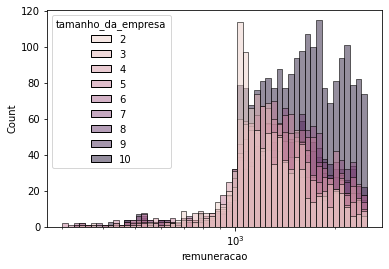

==================Categoria 7


count    1111.000000
mean     1486.911332
std       435.910096
min       343.830000
25%      1178.590000
50%      1438.360000
75%      1773.325000
max      2497.680000
Name: remuneracao, dtype: float64

==================Categoria 8


count     893.000000
mean     1540.068914
std       425.800646
min       410.210000
25%      1240.930000
50%      1511.540000
75%      1816.010000
max      2488.590000
Name: remuneracao, dtype: float64

==================Categoria 5


count    1193.000000
mean     1429.356530
std       424.010022
min       301.430000
25%      1141.670000
50%      1371.750000
75%      1690.020000
max      2497.310000
Name: remuneracao, dtype: float64

==================Categoria 4


count    1030.000000
mean     1407.734680
std       405.324651
min       326.150000
25%      1124.842500
50%      1339.615000
75%      1634.020000
max      2499.350000
Name: remuneracao, dtype: float64

==================Categoria 6


count     797.000000
mean     1454.994818
std       430.678329
min       327.040000
25%      1152.720000
50%      1384.690000
75%      1733.760000
max      2498.470000
Name: remuneracao, dtype: float64

==================Categoria 3


count     991.000000
mean     1363.942603
std       387.601442
min       343.840000
25%      1105.545000
50%      1278.220000
75%      1579.675000
max      2457.900000
Name: remuneracao, dtype: float64

==================Categoria 10


count    2087.000000
mean     1606.736670
std       453.495643
min       331.300000
25%      1241.985000
50%      1577.850000
75%      1965.400000
max      2499.930000
Name: remuneracao, dtype: float64

==================Categoria 2


count     930.000000
mean     1300.138753
std       368.967592
min       375.510000
25%      1053.757500
50%      1191.925000
75%      1484.685000
max      2494.750000
Name: remuneracao, dtype: float64

==================Categoria 9


count     953.000000
mean     1538.699244
std       424.830061
min       414.680000
25%      1218.980000
50%      1503.010000
75%      1835.410000
max      2489.540000
Name: remuneracao, dtype: float64

Grafico de distribuição de id com relação a tamanho_da_empresa


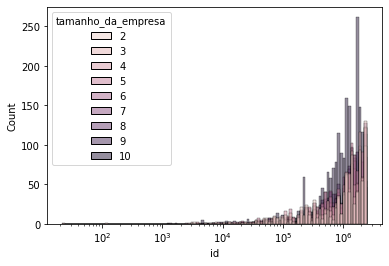

==================Categoria 7


count    1.111000e+03
mean     1.234023e+06
std      7.024034e+05
min      4.953000e+03
25%      6.169540e+05
50%      1.239087e+06
75%      1.835260e+06
max      2.457007e+06
Name: id, dtype: float64

==================Categoria 8


count    8.930000e+02
mean     1.193749e+06
std      6.577587e+05
min      1.397000e+03
25%      6.592900e+05
50%      1.213783e+06
75%      1.740878e+06
max      2.455774e+06
Name: id, dtype: float64

==================Categoria 5


count    1.193000e+03
mean     1.227227e+06
std      7.149310e+05
min      2.499000e+03
25%      5.776340e+05
50%      1.262540e+06
75%      1.845832e+06
max      2.459462e+06
Name: id, dtype: float64

==================Categoria 4


count    1.030000e+03
mean     1.170553e+06
std      7.483635e+05
min      3.660000e+03
25%      4.714490e+05
50%      1.153718e+06
75%      1.845843e+06
max      2.458733e+06
Name: id, dtype: float64

==================Categoria 6


count    7.970000e+02
mean     1.185516e+06
std      6.997587e+05
min      7.083000e+03
25%      5.904100e+05
50%      1.179030e+06
75%      1.732911e+06
max      2.451607e+06
Name: id, dtype: float64

==================Categoria 3


count    9.910000e+02
mean     1.180308e+06
std      7.367758e+05
min      2.200000e+01
25%      5.052000e+05
50%      1.224902e+06
75%      1.844476e+06
max      2.431983e+06
Name: id, dtype: float64

==================Categoria 10


count    2.087000e+03
mean     1.177463e+06
std      6.448502e+05
min      1.187000e+03
25%      6.676275e+05
50%      1.157756e+06
75%      1.730122e+06
max      2.454433e+06
Name: id, dtype: float64

==================Categoria 2


count    9.300000e+02
mean     1.206233e+06
std      7.676965e+05
min      3.185000e+03
25%      4.135535e+05
50%      1.219112e+06
75%      1.867760e+06
max      2.448509e+06
Name: id, dtype: float64

==================Categoria 9


count    9.530000e+02
mean     1.135624e+06
std      6.276486e+05
min      5.215000e+03
25%      6.053830e+05
50%      1.149370e+06
75%      1.696228e+06
max      2.445609e+06
Name: id, dtype: float64

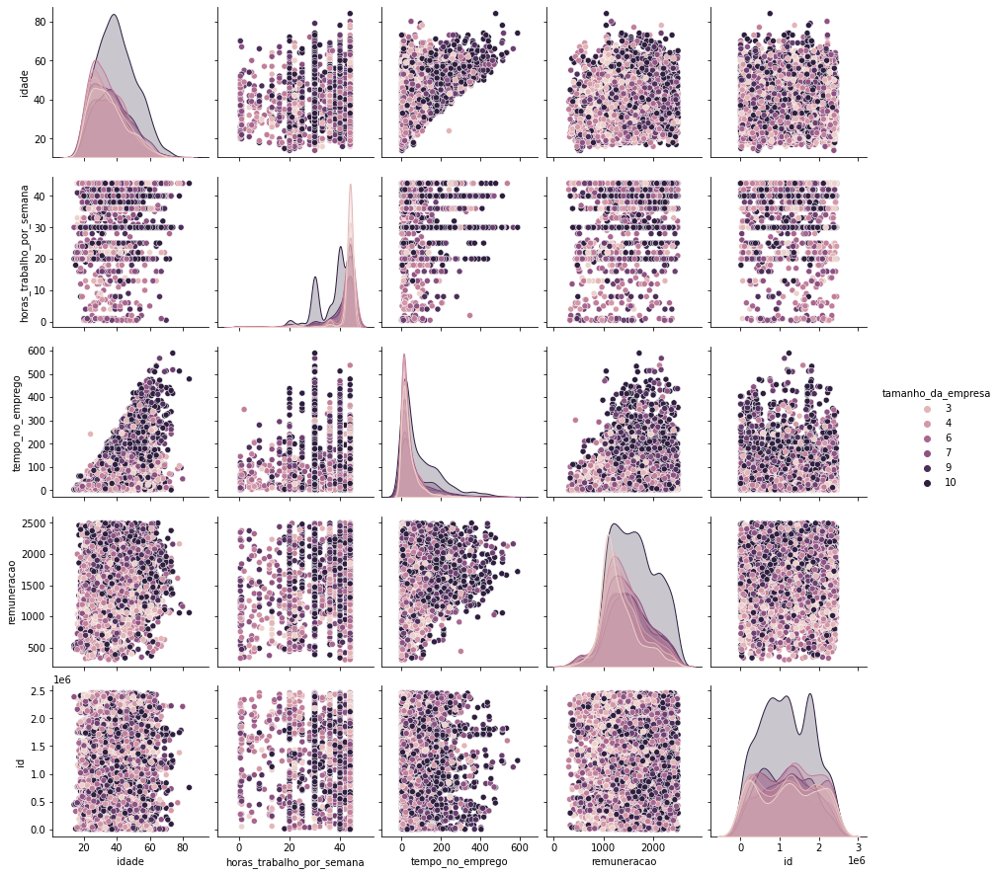

In [ ]:
def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = baixa_renda.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = baixa_renda.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([baixa_renda[i].value_counts(), baixa_renda[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(dad, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()
  

In [ ]:
#treino['idade_raiz'] = np.sqrt(treino['idade'])
#treino['idade_transf'] = np.log(treino['idade']) # melhor
treino['idade'] = np.exp(treino['idade_transf'])
#treino['horas_trabalho_por_semana_transf'] = np.log(treino['horas_trabalho_por_semana'].replace(0,1))
#treino['horas_trabalho_por_semana_raiz'] = np.sqrt(treino['horas_trabalho_por_semana'].replace(0,1))
#treino['tempo_no_emprego_transf'] = np.log(treino['tempo_no_emprego'].replace(0,1))
#treino['tempo_no_emprego_raiz'] = treino['tempo_no_emprego']**(1/3) #melhor
treino['tempo_no_emprego'] = treino['tempo_no_emprego_raiz']**3
#treino[['tempo_no_emprego_raiz', 'tempo_no_emprego', 'tempo_no_emprego_transf']].hist()
#treino[['idade', 'remuneracao', 'remuneracao_log']].corr()

treino.head(1)

,sexo,faixa_etaria,cor_raca,escolaridade,horas_trabalho_por_semana,portador_de_deficiencia,tamanho_da_empresa,id,remuneracao_log,idade_transf,tempo_no_emprego_raiz,idade,tempo_no_emprego
11797,1,6,8,7,36,0,2,337673,7.330969,3.850148,4.065585,47.0,67.2


### Tentativa de Gerar datasets diferentes para modelar diferente o que meu modelo está errando bastante

In [ ]:

mask_1 = ((treino['cor_raca']==99)&(treino['tamanho_da_empresa']>8)&(treino['escolaridade']>7))
mask_2 = ((treino['horas_trabalho_por_semana']<40.5)&(treino['tamanho_da_empresa']>8)&(treino['cor_raca']==99)&(treino['escolaridade']>6)&(treino['idade']>50))
mask_3 = ((treino['escolaridade']>7)&(treino['tamanho_da_empresa']==10)&(dados['horas_trabalho_por_semana']<40.5))
mask_4 = ((treino['cor_raca']==99)&(treino['idade']>50)&(treino['tamanho_da_empresa']==10))
mask_5 = ((treino['cor_raca']==99)&(treino['idade']>50)&(treino['tamanho_da_empresa']>8)&(treino['horas_trabalho_por_semana']<40.1))
mask_6 = ((treino['cor_raca']==99)&(treino['idade']>50)&(treino['escolaridade']>7)&(treino['tempo_no_emprego']>100))
mask_7 = ((treino['cor_raca']==99)&(treino['idade']>60)&(treino['escolaridade']>5)&(treino['tempo_no_emprego']>100))
mask_8 = ((treino['horas_trabalho_por_semana']<40.1)&(treino['tamanho_da_empresa']>8)&(treino['escolaridade']>8)&(treino['tempo_no_emprego']>100))
mask_9 = ((treino['horas_trabalho_por_semana']<40.1)&(treino['tamanho_da_empresa']>8)&(treino['escolaridade']>5)&(treino['tempo_no_emprego']>200))
mask_10 = ((treino['tempo_no_emprego']>300))
mask_11 = ((treino['cor_raca']==99)&(treino['tamanho_da_empresa']>9)&(treino['tempo_no_emprego']>100))
mask_12 = ((treino['tempo_no_emprego']>200)&(treino['horas_trabalho_por_semana']<40.1)&(treino['escolaridade']>5))

mask_13 = ((treino['tamanho_da_empresa']==10)&(treino['cor_raca']==99)&(treino['escolaridade']>8))
mask_14 = ((treino['tempo_no_emprego']>300)&(treino['tamanho_da_empresa']>8)&(treino['escolaridade']>6))
mask_15 = ((treino['cor_raca']==99)&(treino['escolaridade']==10))
mask_16 = ((treino['escolaridade']==10))
mask_17 = ((treino['escolaridade']==9)&(treino['tamanho_da_empresa']>9))
mask_18 = ((treino['cor_raca']==99)&(treino['tempo_no_emprego']>150)&(treino['escolaridade']>7))

#seg = dados[mask_1 | mask_2 | mask_3 | mask_4 | mask_5 | mask_6 | mask_7 | mask_8 | mask_9 | mask_10 | mask_11 | mask_12].copy()
seg = treino[mask_13 | mask_14 | mask_15 | mask_16 | mask_17 | mask_18]
#seg = dados[mask_17| mask_13 | mask_15 | mask_16 | mask_18 | mask_14]

len(seg)
e = seg.index
f = dados.drop(seg.index).copy().index


In [ ]:
#a = index_normais
#b = index_outliers
c = baixa_renda.index
d = renda_alta.index
#print(f'Renda Baixa e Indices Normais {len(list(set(a) & set(c)))}')
#print(f'Renda Baixa e Indices Outliers {len(list(set(a) & set(d)))}')
#print(f'Renda Alta e Indices Normais {len(list(set(b) & set(c)))}')
#print(f'Renda Alta e Indices Outliers {len(list(set(b) & set(d)))}')
#print(f'Seg e Indices Outliers {len(list(set(e) & set(b)))}')
print(f'Seg e Alta Renda {len(list(set(e) & set(d)))}')
#print(f'Seg e Indices Normais {len(list(set(e) & set(a)))}')
print(f'Seg e Renda baixa {len(list(set(e) & set(c)))}')

#print(f'Outros e Indices Outliers {len(list(set(f) & set(b)))}')
print(f'Outros e Alta Renda {len(list(set(f) & set(d)))}')
#print(f'Outros e Indices Normais {len(list(set(f) & set(a)))}')
print(f'Outros e Renda baixa {len(list(set(f) & set(c)))}')

Seg e Alta Renda 1497
Seg e Renda baixa 298
Outros e Alta Renda 3518
Outros e Renda baixa 9687


In [ ]:
treino.head(1)

,sexo,faixa_etaria,cor_raca,escolaridade,horas_trabalho_por_semana,portador_de_deficiencia,tamanho_da_empresa,id,remuneracao_log,idade_transf,tempo_no_emprego_raiz
11797,1,6,8,7,36,0,2,337673,7.330969,3.850148,4.065585


## Avaliação dos modelos separados

================sexo=============


,sexo,sexo
2,1078,0.600557
1,717,0.399443


Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


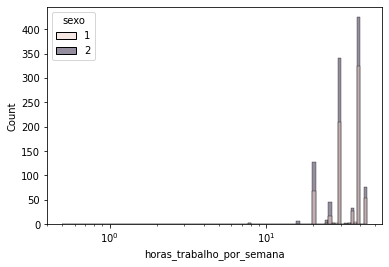

==================Categoria 1


count    717.000000
mean      34.629010
std        7.271598
min        2.000000
25%       30.000000
50%       40.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    1078.000000
mean       33.459647
std         7.772084
min         0.500000
25%        30.000000
50%        33.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a sexo


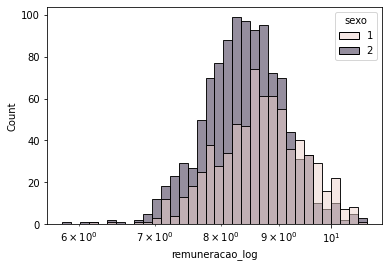

==================Categoria 1


count    717.000000
mean       8.691421
std        0.753607
min        6.192097
25%        8.192302
50%        8.678873
75%        9.203726
max       10.611036
Name: remuneracao_log, dtype: float64

==================Categoria 2


count    1078.000000
mean        8.404942
std         0.686109
min         5.803024
25%         7.946774
50%         8.396265
75%         8.837358
max        10.744580
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a sexo


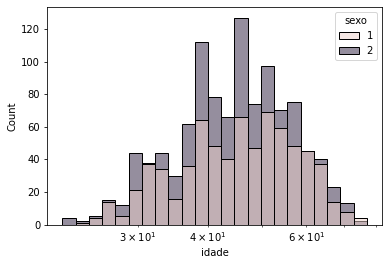

==================Categoria 1


count    717.000000
mean      46.355649
std       10.727732
min       24.000000
25%       38.000000
50%       46.000000
75%       54.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 2


count    1078.000000
mean       45.465677
std        10.378278
min        22.000000
25%        38.000000
50%        45.000000
75%        52.000000
max        77.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


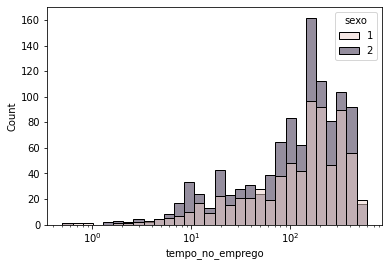

==================Categoria 1


count    717.000000
mean     179.542957
std      134.377463
min        0.600000
25%       64.800000
50%      162.900000
75%      271.800000
max      596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    1078.000000
mean      168.355566
std       130.028872
min         0.500000
25%        58.500000
50%       151.850000
75%       246.900000
max       556.900000
Name: tempo_no_emprego, dtype: float64

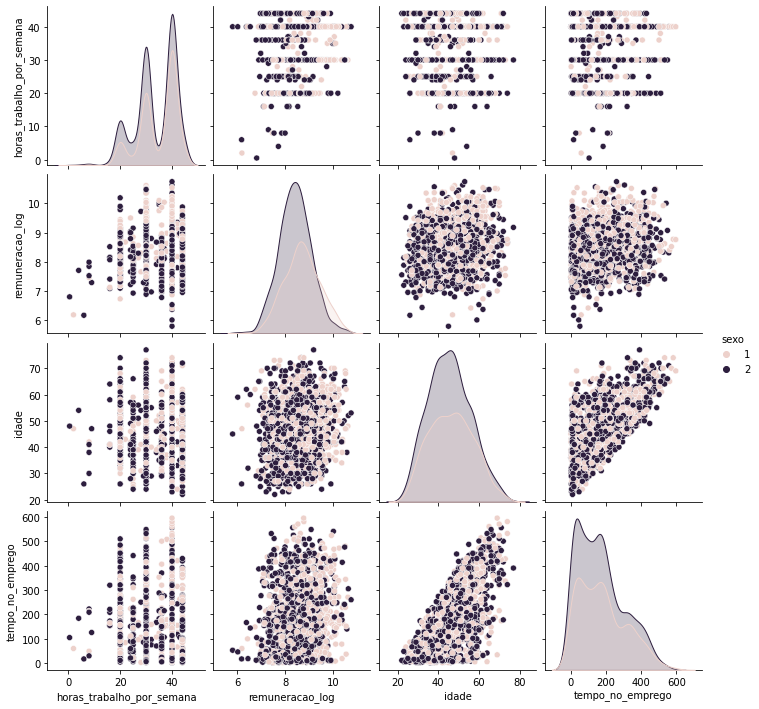

,faixa_etaria,faixa_etaria
6,603,0.335933
7,572,0.318663
5,452,0.251811
4,84,0.046797
8,77,0.042897
3,7,0.003900


================faixa_etaria=============
Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


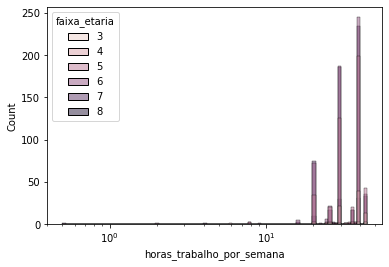

==================Categoria 7


count    572.000000
mean      33.512238
std        7.536591
min        4.000000
25%       30.000000
50%       33.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    452.000000
mean      34.951327
std        7.147314
min        8.000000
25%       30.000000
50%       40.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    77.000000
mean     33.259740
std       7.077397
min      20.000000
25%      30.000000
50%      30.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    603.000000
mean      33.292703
std        7.959364
min        0.500000
25%       30.000000
50%       34.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    84.000000
mean     36.071429
std       7.293809
min       6.000000
25%      30.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count     7.000000
mean     37.857143
std       7.403345
min      25.000000
25%      35.000000
50%      40.000000
75%      43.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a faixa_etaria


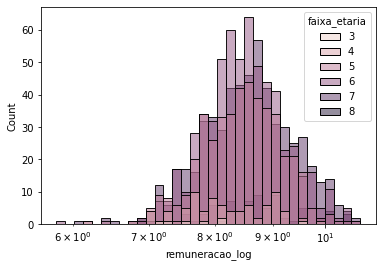

==================Categoria 7


count    572.000000
mean       8.589992
std        0.778308
min        6.018009
25%        8.042710
50%        8.576708
75%        9.100004
max       10.744580
Name: remuneracao_log, dtype: float64

==================Categoria 5


count    452.000000
mean       8.476503
std        0.662393
min        6.445021
25%        8.002362
50%        8.484294
75%        8.941058
max       10.568423
Name: remuneracao_log, dtype: float64

==================Categoria 8


count    77.000000
mean      8.669870
std       0.824601
min       6.894295
25%       8.198642
50%       8.663374
75%       9.042881
max      10.514874
Name: remuneracao_log, dtype: float64

==================Categoria 6


count    603.000000
mean       8.516378
std        0.692697
min        5.803024
25%        8.092844
50%        8.488664
75%        8.937468
max       10.611036
Name: remuneracao_log, dtype: float64

==================Categoria 4


count    84.000000
mean      8.198248
std       0.734908
min       6.178235
25%       7.706393
50%       8.140584
75%       8.889787
max       9.900709
Name: remuneracao_log, dtype: float64

==================Categoria 3


count    7.000000
mean     7.973126
std      0.779662
min      7.203547
25%      7.438831
50%      7.890942
75%      8.162668
max      9.514396
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a faixa_etaria


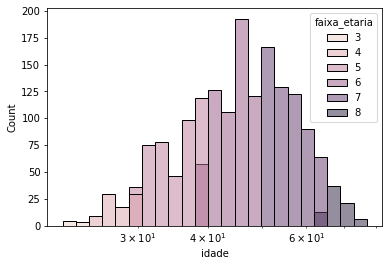

==================Categoria 7


count    572.000000
mean      55.631119
std        4.087306
min       50.000000
25%       52.000000
50%       55.000000
75%       59.000000
max       64.000000
Name: idade, dtype: float64

==================Categoria 5


count    452.000000
mean      35.028761
std        2.907528
min       30.000000
25%       33.000000
50%       35.000000
75%       38.000000
max       39.000000
Name: idade, dtype: float64

==================Categoria 8


count    77.000000
mean     68.363636
std       2.742977
min      65.000000
25%      66.000000
50%      68.000000
75%      70.000000
max      77.000000
Name: idade, dtype: float64

==================Categoria 6


count    603.000000
mean      44.543947
std        2.887591
min       40.000000
25%       42.000000
50%       45.000000
75%       47.000000
max       49.000000
Name: idade, dtype: float64

==================Categoria 4


count    84.000000
mean     27.476190
std       1.418265
min      25.000000
25%      26.000000
50%      28.000000
75%      29.000000
max      29.000000
Name: idade, dtype: float64

==================Categoria 3


count     7.000000
mean     23.285714
std       0.755929
min      22.000000
25%      23.000000
50%      23.000000
75%      24.000000
max      24.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


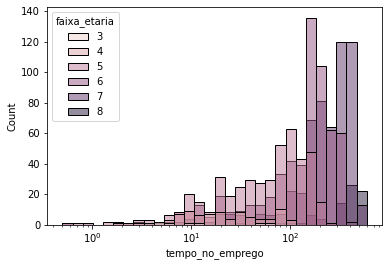

==================Categoria 7


count    572.000000
mean     258.892133
std      127.192972
min        3.900000
25%      169.325000
50%      261.900000
75%      367.800000
max      532.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    452.000000
mean      74.994248
std       55.241267
min        0.500000
25%       23.500000
50%       70.200000
75%      111.150000
max      251.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     77.000000
mean     386.384416
std      130.393218
min       32.900000
25%      337.200000
50%      415.000000
75%      479.700000
max      596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    603.000000
mean     158.681592
std       92.778571
min        0.600000
25%       85.000000
50%      165.500000
75%      216.800000
max      448.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count     84.000000
mean      31.559524
std       28.584974
min        1.900000
25%        9.900000
50%       19.050000
75%       44.125000
max      103.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count     7.000000
mean     21.185714
std      24.560295
min       4.400000
25%       5.450000
50%       9.900000
75%      28.900000
max      65.300000
Name: tempo_no_emprego, dtype: float64

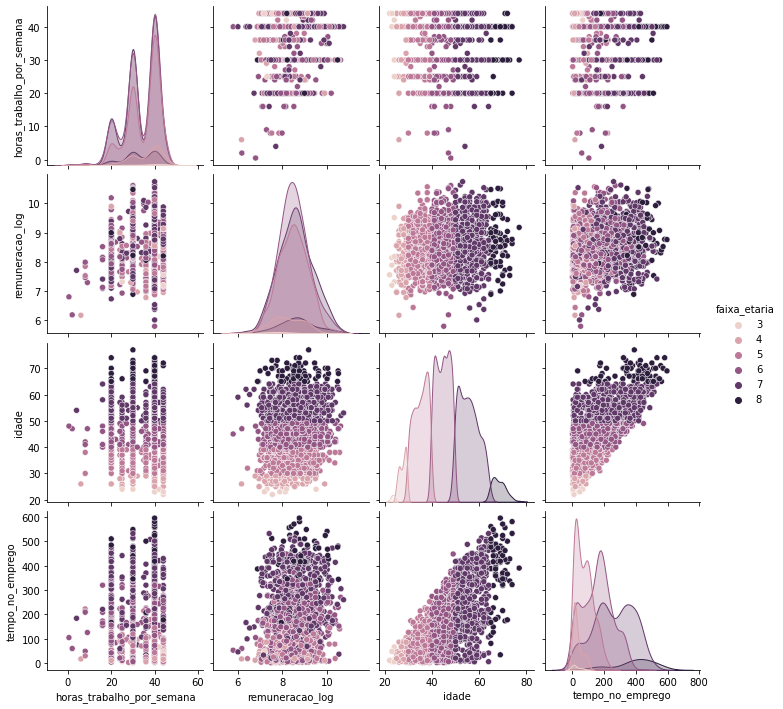

================cor_raca=============


,cor_raca,cor_raca
99,1617,0.900836
8,83,0.046240
9,45,0.025070
2,40,0.022284
4,5,0.002786
1,3,0.001671
6,2,0.001114


Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


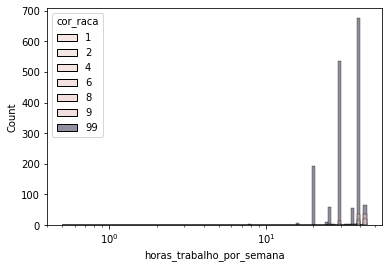

==================Categoria 99


count    1617.000000
mean       33.414348
std         7.408534
min         4.000000
25%        30.000000
50%        30.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    40.000000
mean     40.750000
std       4.813176
min      24.000000
25%      40.000000
50%      42.500000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    45.000000
mean     39.022222
std       6.169901
min       6.000000
25%      40.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    83.000000
mean     37.451807
std       9.384281
min       0.500000
25%      34.000000
50%      40.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count     5.000000
mean     39.400000
std       3.130495
min      36.000000
25%      37.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     3.000000
mean     34.000000
std      10.392305
min      22.000000
25%      31.000000
50%      40.000000
75%      40.000000
max      40.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count     2.000000
mean     37.000000
std       9.899495
min      30.000000
25%      33.500000
50%      37.000000
75%      40.500000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a cor_raca


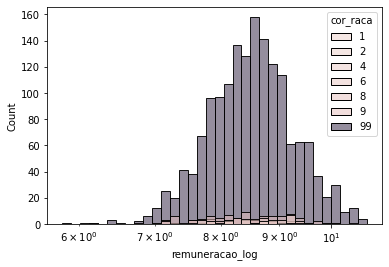

==================Categoria 99


count    1617.000000
mean        8.530438
std         0.723272
min         5.803024
25%         8.031814
50%         8.515754
75%         8.974728
max        10.744580
Name: remuneracao_log, dtype: float64

==================Categoria 2


count    40.000000
mean      8.661069
std       0.750116
min       7.081456
25%       8.057712
50%       8.769681
75%       9.164442
max      10.537103
Name: remuneracao_log, dtype: float64

==================Categoria 9


count    45.000000
mean      8.101937
std       0.640471
min       6.178235
25%       7.808124
50%       8.080315
75%       8.447451
max       9.479350
Name: remuneracao_log, dtype: float64

==================Categoria 8


count    83.000000
mean      8.423762
std       0.789283
min       6.192097
25%       7.812021
50%       8.450215
75%       9.017069
max      10.065265
Name: remuneracao_log, dtype: float64

==================Categoria 4


count    5.000000
mean     8.828750
std      0.624280
min      8.139248
25%      8.164738
50%      9.143387
75%      9.303748
max      9.392627
Name: remuneracao_log, dtype: float64

==================Categoria 1


count    3.000000
mean     8.863626
std      0.308886
min      8.679397
25%      8.685324
50%      8.691251
75%      8.955741
max      9.220231
Name: remuneracao_log, dtype: float64

==================Categoria 6


count    2.000000
mean     8.810556
std      0.410616
min      8.520207
25%      8.665381
50%      8.810556
75%      8.955730
max      9.100905
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a cor_raca


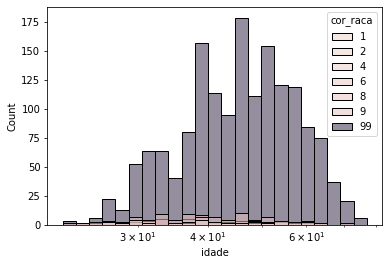

==================Categoria 99


count    1617.000000
mean       46.429808
std        10.429937
min        22.000000
25%        39.000000
50%        46.000000
75%        54.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 2


count    40.000000
mean     40.525000
std      11.295535
min      24.000000
25%      30.750000
50%      39.500000
75%      49.250000
max      62.000000
Name: idade, dtype: float64

==================Categoria 9


count    45.000000
mean     40.177778
std      10.086645
min      23.000000
25%      33.000000
50%      38.000000
75%      47.000000
max      71.000000
Name: idade, dtype: float64

==================Categoria 8


count    83.000000
mean     40.084337
std       9.323724
min      24.000000
25%      33.000000
50%      38.000000
75%      47.000000
max      63.000000
Name: idade, dtype: float64

==================Categoria 4


count     5.000000
mean     42.200000
std       3.962323
min      37.000000
25%      41.000000
50%      42.000000
75%      43.000000
max      48.000000
Name: idade, dtype: float64

==================Categoria 1


count     3.000000
mean     41.666667
std      10.066446
min      31.000000
25%      37.000000
50%      43.000000
75%      47.000000
max      51.000000
Name: idade, dtype: float64

==================Categoria 6


count     2.000000
mean     40.000000
std       5.656854
min      36.000000
25%      38.000000
50%      40.000000
75%      42.000000
max      44.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


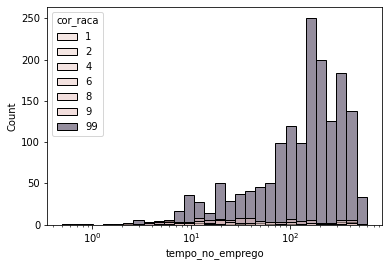

==================Categoria 99


count    1617.000000
mean      182.014100
std       129.394568
min         0.700000
25%        78.000000
50%       165.900000
75%       267.700000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count     40.000000
mean      99.495000
std      124.682277
min        0.900000
25%       13.400000
50%       42.850000
75%      116.325000
max      390.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count     45.000000
mean      62.273333
std      134.907964
min        0.500000
25%        6.900000
50%       11.200000
75%       21.300000
max      556.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     83.000000
mean      96.487952
std      121.153361
min        0.600000
25%       17.850000
50%       38.300000
75%      125.200000
max      508.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count      5.000000
mean      59.580000
std       29.512235
min       28.200000
25%       47.400000
50%       47.800000
75%       68.800000
max      105.700000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      3.000000
mean     144.433333
std      177.011873
min        6.400000
25%       44.650000
50%       82.900000
75%      213.450000
max      344.000000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count      2.000000
mean     190.500000
std       80.044488
min      133.900000
25%      162.200000
50%      190.500000
75%      218.800000
max      247.100000
Name: tempo_no_emprego, dtype: float64

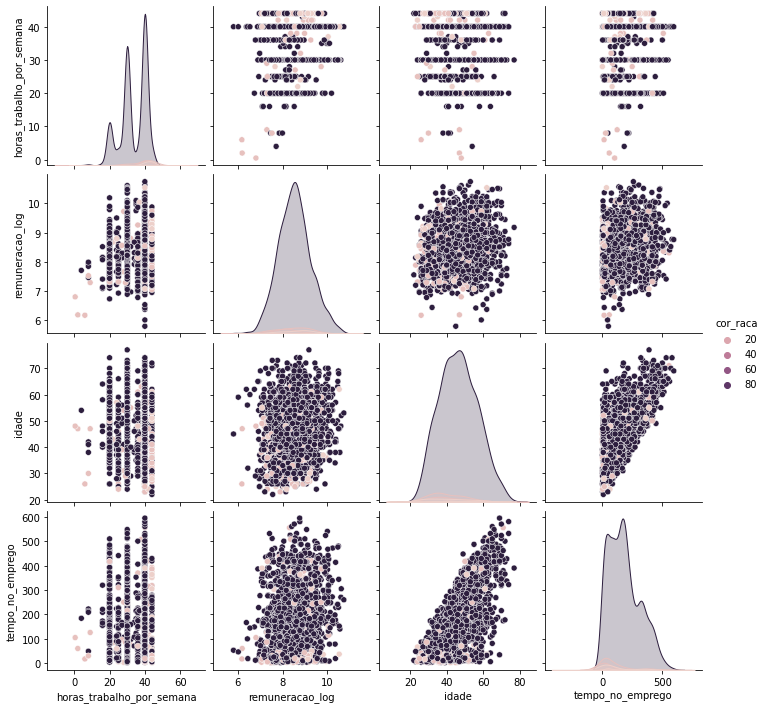

================escolaridade=============


,escolaridade,escolaridade
9,1517,0.845125
7,141,0.078552
10,72,0.040111
8,34,0.018942
11,31,0.017270


Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


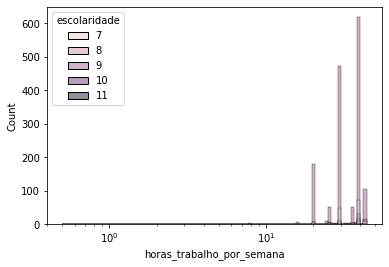

==================Categoria 9


count    1517.000000
mean       33.736322
std         7.568793
min         4.000000
25%        30.000000
50%        36.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    72.000000
mean     35.048611
std      10.420781
min       0.500000
25%      30.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    141.000000
mean      35.567376
std        6.146201
min       20.000000
25%       30.000000
50%       40.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count    31.000000
mean     34.838710
std       6.387993
min      25.000000
25%      30.000000
50%      40.000000
75%      40.000000
max      40.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    34.000000
mean     32.411765
std       7.398270
min      20.000000
25%      30.000000
50%      30.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a escolaridade


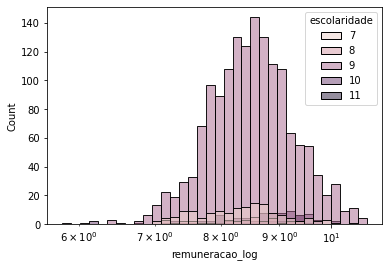

==================Categoria 9


count    1517.000000
mean        8.525384
std         0.719317
min         5.803024
25%         8.035399
50%         8.504065
75%         8.974095
max        10.744580
Name: remuneracao_log, dtype: float64

==================Categoria 10


count    72.000000
mean      8.833474
std       0.811458
min       6.178235
25%       8.502324
50%       8.967703
75%       9.374651
max      10.538743
Name: remuneracao_log, dtype: float64

==================Categoria 7


count    141.000000
mean       8.332419
std        0.711844
min        7.066493
25%        7.789893
50%        8.344897
75%        8.765306
max       10.500261
Name: remuneracao_log, dtype: float64

==================Categoria 11


count    31.000000
mean      8.585461
std       0.768495
min       7.179567
25%       7.913742
50%       8.652635
75%       9.275129
max      10.105713
Name: remuneracao_log, dtype: float64

==================Categoria 8


count    34.000000
mean      8.301118
std       0.681171
min       7.112873
25%       7.696827
50%       8.419125
75%       8.780746
max       9.421484
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a escolaridade


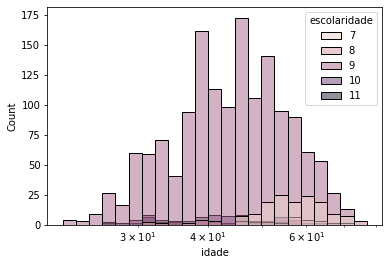

==================Categoria 9


count    1517.000000
mean       44.878049
std        10.141559
min        22.000000
25%        37.000000
50%        45.000000
75%        52.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 10


count    72.000000
mean     42.375000
std       9.325775
min      26.000000
25%      34.750000
50%      42.000000
75%      48.250000
max      68.000000
Name: idade, dtype: float64

==================Categoria 7


count    141.000000
mean      57.581560
std        6.817159
min       45.000000
25%       53.000000
50%       57.000000
75%       62.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 11


count    31.000000
mean     41.419355
std      10.525443
min      27.000000
25%      32.000000
50%      38.000000
75%      50.000000
max      62.000000
Name: idade, dtype: float64

==================Categoria 8


count    34.000000
mean     50.441176
std      10.708793
min      32.000000
25%      41.000000
50%      51.500000
75%      58.750000
max      72.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


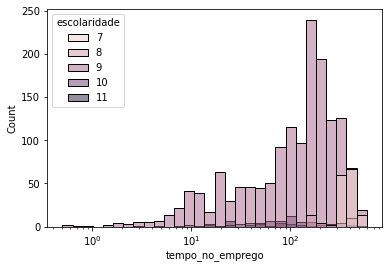

==================Categoria 9


count    1517.000000
mean      154.717469
std       117.964297
min         0.500000
25%        52.900000
50%       147.900000
75%       220.600000
max       581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count     72.000000
mean     117.526389
std      106.316846
min        0.900000
25%       41.150000
50%       87.150000
75%      149.425000
max      472.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    141.000000
mean     391.686525
std       60.538740
min      302.700000
25%      341.000000
50%      386.800000
75%      429.900000
max      596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count     31.000000
mean      76.545161
std       83.993245
min        2.700000
25%       23.100000
50%       46.700000
75%       94.400000
max      429.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     34.000000
mean     277.958824
std      114.724133
min      152.200000
25%      172.900000
50%      233.550000
75%      390.550000
max      514.500000
Name: tempo_no_emprego, dtype: float64

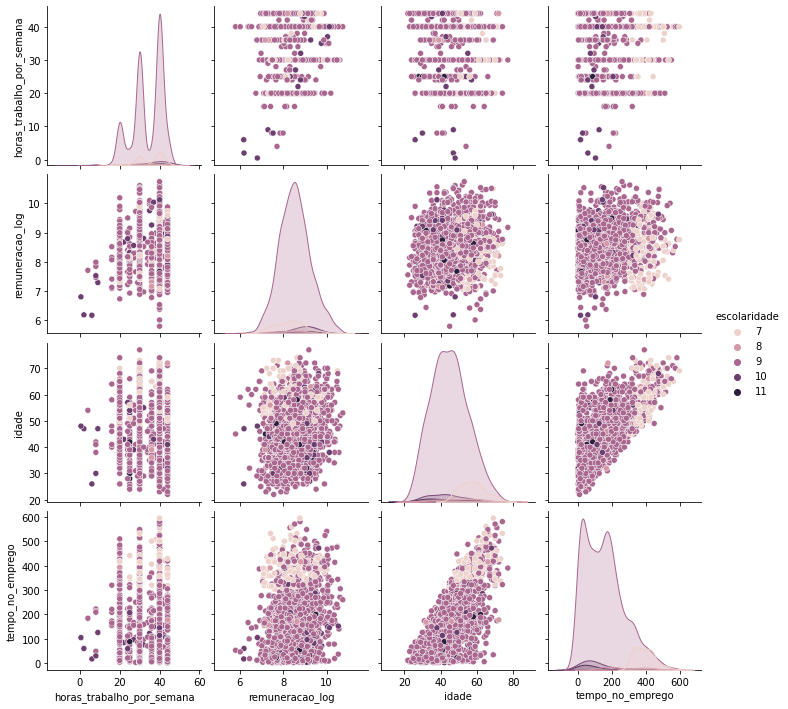

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,1788,0.9961
1,7,0.0039


Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


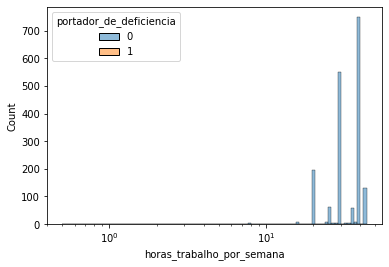

==================Categoria 0


count    1788.000000
mean       33.929810
std         7.599496
min         0.500000
25%        30.000000
50%        36.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     7.000000
mean     33.142857
std       7.033931
min      24.000000
25%      27.500000
50%      35.000000
75%      38.000000
max      42.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a portador_de_deficiencia


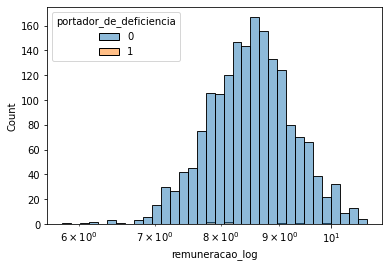

==================Categoria 0


count    1788.000000
mean        8.519056
std         0.727018
min         5.803024
25%         8.021429
50%         8.511634
75%         8.975654
max        10.744580
Name: remuneracao_log, dtype: float64

==================Categoria 1


count    7.000000
mean     8.600531
std      0.855631
min      7.801236
25%      7.956854
50%      8.122009
75%      9.200311
max      9.966141
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a portador_de_deficiencia


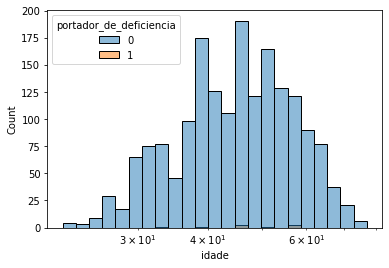

==================Categoria 0


count    1788.000000
mean       45.815996
std        10.533833
min        22.000000
25%        38.000000
50%        45.000000
75%        53.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 1


count     7.000000
mean     47.142857
std       8.591247
min      33.000000
25%      43.000000
50%      47.000000
75%      53.500000
max      57.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


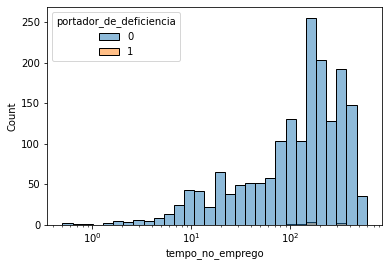

==================Categoria 0


count    1788.000000
mean      172.723154
std       131.985026
min         0.500000
25%        58.500000
50%       155.050000
75%       252.175000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count      7.000000
mean     198.657143
std       98.313730
min      105.500000
25%      133.600000
50%      162.600000
75%      250.850000
max      353.600000
Name: tempo_no_emprego, dtype: float64

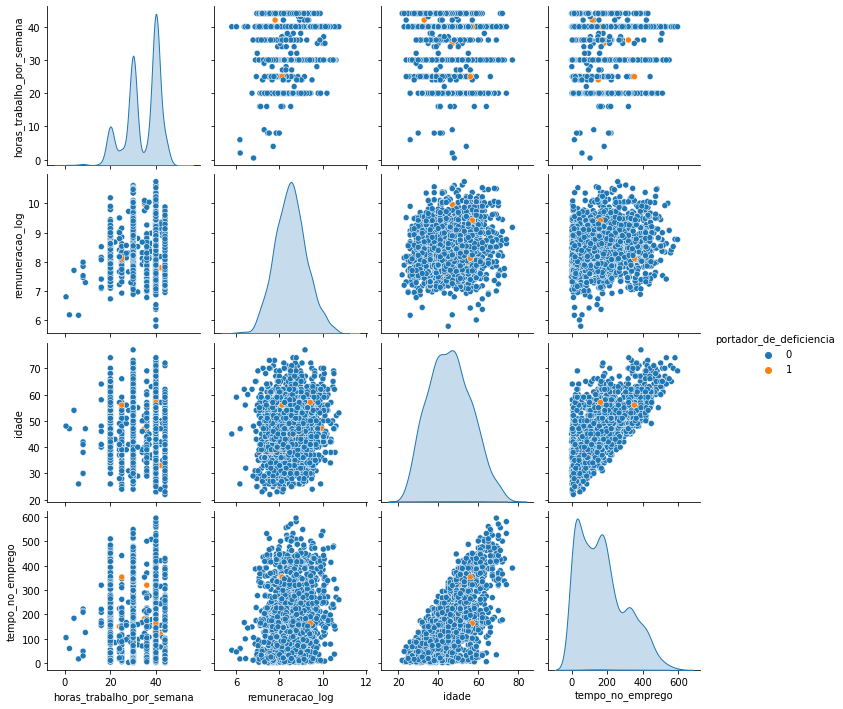

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,1535,0.855153
9,127,0.070752
8,63,0.035097
7,46,0.025627
6,13,0.007242
5,8,0.004457
4,3,0.001671


Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


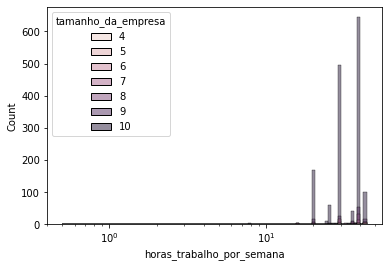

==================Categoria 10


count    1535.000000
mean       33.908795
std         7.295640
min         8.000000
25%        30.000000
50%        36.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    63.000000
mean     35.238095
std       8.499932
min       2.000000
25%      30.000000
50%      40.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    127.000000
mean      34.322835
std        8.929070
min        4.000000
25%       30.000000
50%       40.000000
75%       40.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count     3.000000
mean     25.333333
std      17.473790
min       6.000000
25%      18.000000
50%      30.000000
75%      35.000000
max      40.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    13.000000
mean     32.692308
std      10.888714
min       8.000000
25%      30.000000
50%      36.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count     8.000000
mean     34.500000
std      12.035661
min       8.000000
25%      30.000000
50%      40.000000
75%      41.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    46.000000
mean     32.445652
std       9.200379
min       0.500000
25%      30.000000
50%      30.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a tamanho_da_empresa


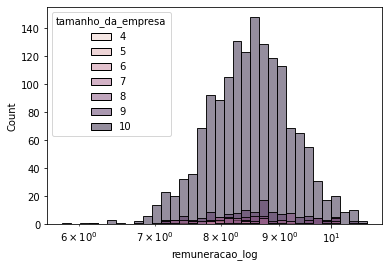

==================Categoria 10


count    1535.000000
mean        8.515281
std         0.707647
min         5.803024
25%         8.028783
50%         8.511807
75%         8.974169
max        10.744580
Name: remuneracao_log, dtype: float64

==================Categoria 8


count    63.000000
mean      8.763344
std       0.879345
min       6.192097
25%       8.210802
50%       8.697523
75%       9.315248
max      10.628859
Name: remuneracao_log, dtype: float64

==================Categoria 9


count    127.000000
mean       8.596053
std        0.800597
min        7.066493
25%        8.016928
50%        8.590875
75%        9.022681
max       10.611036
Name: remuneracao_log, dtype: float64

==================Categoria 4


count    3.000000
mean     8.199615
std      1.892700
min      6.178235
25%      7.334469
50%      8.490703
75%      9.210305
max      9.929907
Name: remuneracao_log, dtype: float64

==================Categoria 6


count    13.000000
mean      8.194376
std       0.710342
min       7.092524
25%       7.881220
50%       7.992978
75%       8.368579
max      10.025853
Name: remuneracao_log, dtype: float64

==================Categoria 5


count    8.000000
mean     8.396413
std      0.766410
min      7.326374
25%      7.909258
50%      8.390674
75%      8.885615
max      9.585636
Name: remuneracao_log, dtype: float64

==================Categoria 7


count    46.000000
mean      8.244189
std       0.744686
min       6.807460
25%       7.707622
50%       8.138756
75%       8.683428
max      10.166641
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a tamanho_da_empresa


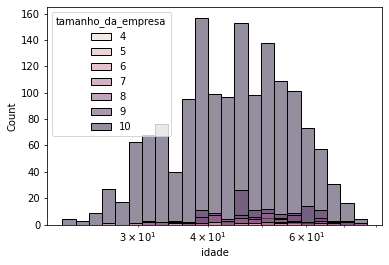

==================Categoria 10


count    1535.000000
mean       45.187622
std        10.549380
min        22.000000
25%        37.000000
50%        45.000000
75%        53.000000
max        74.000000
Name: idade, dtype: float64

==================Categoria 8


count    63.000000
mean     49.507937
std      10.331401
min      27.000000
25%      41.500000
50%      48.000000
75%      56.500000
max      74.000000
Name: idade, dtype: float64

==================Categoria 9


count    127.000000
mean      50.401575
std        9.181814
min       32.000000
25%       45.000000
50%       49.000000
75%       58.000000
max       71.000000
Name: idade, dtype: float64

==================Categoria 4


count     3.000000
mean     36.333333
std      11.060440
min      26.000000
25%      30.500000
50%      35.000000
75%      41.500000
max      48.000000
Name: idade, dtype: float64

==================Categoria 6


count    13.000000
mean     47.307692
std      10.298743
min      32.000000
25%      41.000000
50%      48.000000
75%      55.000000
max      67.000000
Name: idade, dtype: float64

==================Categoria 5


count     8.000000
mean     48.625000
std      10.927521
min      30.000000
25%      41.750000
50%      49.000000
75%      58.000000
max      62.000000
Name: idade, dtype: float64

==================Categoria 7


count    46.000000
mean     48.978261
std       8.787590
min      29.000000
25%      42.250000
50%      48.500000
75%      53.750000
max      77.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


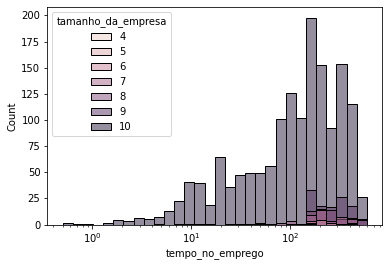

==================Categoria 10


count    1535.000000
mean      161.007101
std       130.577008
min         0.500000
25%        46.850000
50%       133.000000
75%       234.450000
max       596.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count     63.000000
mean     245.485714
std      118.475395
min        7.600000
25%      174.650000
50%      214.600000
75%      290.450000
max      581.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    127.000000
mean     257.994488
std      116.413569
min        4.500000
25%      168.400000
50%      247.200000
75%      346.500000
max      549.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count      3.000000
mean     184.900000
std      181.892138
min       15.900000
25%       88.650000
50%      161.400000
75%      269.400000
max      377.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     13.000000
mean     217.130769
std      108.645788
min       40.400000
25%      172.300000
50%      202.900000
75%      248.500000
max      468.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count      8.000000
mean     187.737500
std      177.023323
min        0.900000
25%       24.100000
50%      152.500000
75%      337.825000
max      446.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count     46.000000
mean     216.597826
std       99.772244
min       10.300000
25%      160.125000
50%      211.000000
75%      294.675000
max      415.700000
Name: tempo_no_emprego, dtype: float64

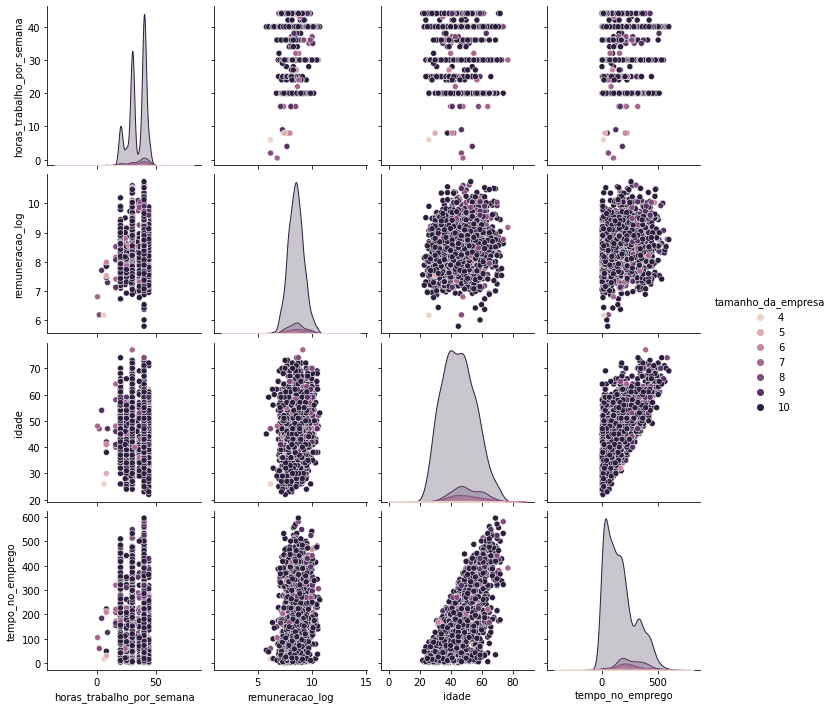

In [ ]:
#treino['idade_raiz'] = np.sqrt(treino['idade'])
#treino['idade_transf'] = np.log(treino['idade']) # melhor
#treino['idade'] = np.exp(treino['idade_transf'])
#treino['horas_trabalho_por_semana_transf'] = np.log(treino['horas_trabalho_por_semana'].replace(0,1))
#treino['horas_trabalho_por_semana_raiz'] = np.sqrt(treino['horas_trabalho_por_semana'].replace(0,1))
#treino['tempo_no_emprego_transf'] = np.log(treino['tempo_no_emprego'].replace(0,1))
#treino['tempo_no_emprego_raiz'] = treino['tempo_no_emprego']**(1/3) #melhor
#treino['tempo_no_emprego'] = treino['tempo_no_emprego_raiz']**3
#treino[['tempo_no_emprego_raiz', 'tempo_no_emprego', 'tempo_no_emprego_transf']].hist()
#treino[['idade', 'remuneracao', 'remuneracao_log']].corr()



derere = treino[mask_13 | mask_14 | mask_15 | mask_16 | mask_17 | mask_18].copy()
derere = derere.drop(['id', 'tempo_no_emprego_raiz', 'idade_transf'], axis = 1)
derere_normal = treino.drop(derere.index).copy()
derere_normal = derere_normal.drop(['id', 'tempo_no_emprego_raiz', 'idade_transf'], axis = 1)

def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = derere.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = derere.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([derere[i].value_counts(), derere[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(dad, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()
  


================sexo=============


,sexo,sexo
1,5362,0.615968
2,3343,0.384032


Grafico de distribuição de horas_trabalho_por_semana com relação a sexo


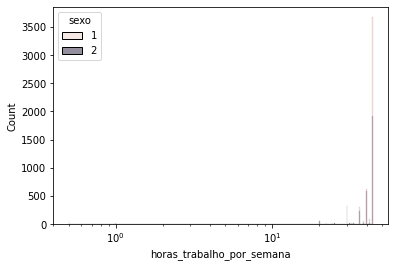

==================Categoria 1


count    5362.000000
mean       40.756341
std         7.205596
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    3343.000000
mean       39.661083
std         7.254582
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a sexo


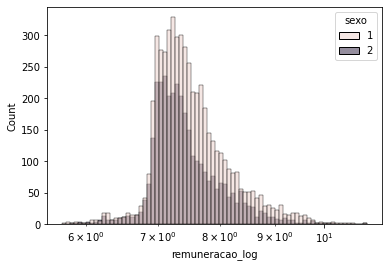

==================Categoria 1


count    5362.000000
mean        7.541471
std         0.613546
min         5.708538
25%         7.132296
50%         7.404462
75%         7.808562
max        10.917313
Name: remuneracao_log, dtype: float64

==================Categoria 2


count    3343.000000
mean        7.442357
std         0.560363
min         5.840176
25%         7.074290
50%         7.312594
75%         7.683252
max        10.948158
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a sexo


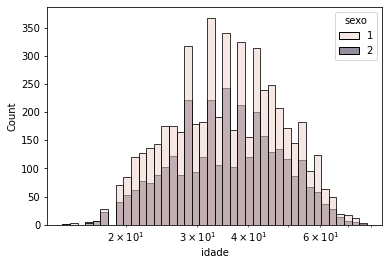

==================Categoria 1


count    5362.000000
mean       37.005781
std        11.253376
min        14.000000
25%        28.000000
50%        36.000000
75%        44.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 2


count    3343.000000
mean       36.928208
std        10.972584
min        14.000000
25%        28.000000
50%        36.000000
75%        44.000000
max        78.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a sexo


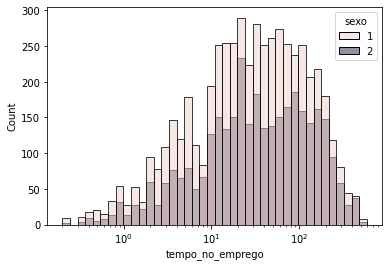

==================Categoria 1


count    5362.000000
mean       61.756658
std        79.133883
min         0.200000
25%        10.400000
50%        29.900000
75%        82.900000
max       589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    3343.000000
mean       69.671971
std        84.391103
min         0.200000
25%        11.900000
50%        33.900000
75%        96.500000
max       545.500000
Name: tempo_no_emprego, dtype: float64

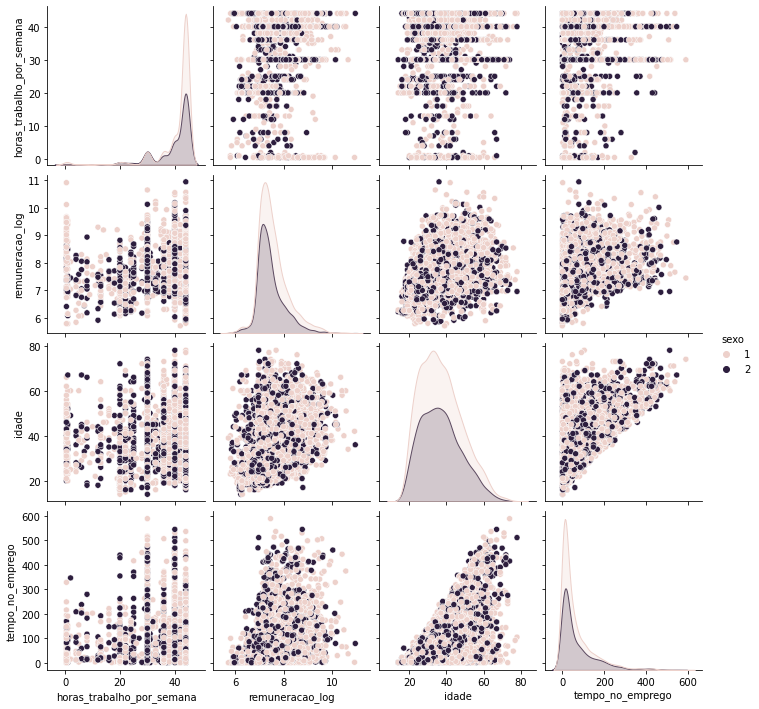

================faixa_etaria=============


,faixa_etaria,faixa_etaria
5,2858,0.328317
6,2056,0.236186
4,1371,0.157496
7,1166,0.133946
3,1126,0.129351
8,102,0.011717
2,24,0.002757
1,2,0.000230


Grafico de distribuição de horas_trabalho_por_semana com relação a faixa_etaria


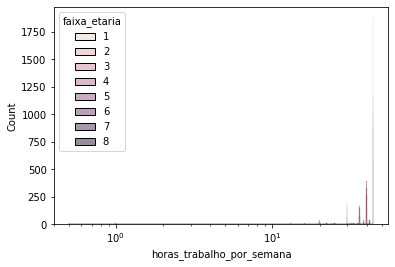

==================Categoria 6


count    2056.000000
mean       39.698930
std         7.396295
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    1371.000000
mean       41.399708
std         6.380053
min         0.500000
25%        42.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    1166.000000
mean       39.237564
std         7.546946
min         0.500000
25%        38.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    1126.000000
mean       41.387211
std         6.984534
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    2858.000000
mean       40.588523
std         7.117264
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count     2.000000
mean     25.000000
std       7.071068
min      20.000000
25%      22.500000
50%      25.000000
75%      27.500000
max      30.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    102.000000
mean      36.416667
std        9.151390
min        0.500000
25%       30.000000
50%       40.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    24.000000
mean     25.958333
std       8.927141
min      20.000000
25%      20.000000
50%      22.000000
75%      28.500000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a faixa_etaria


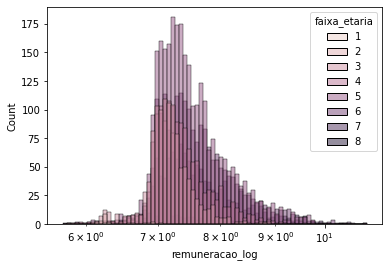

==================Categoria 6


count    2056.000000
mean        7.628596
std         0.623910
min         5.790082
25%         7.184001
50%         7.486728
75%         7.935375
max        10.917313
Name: remuneracao_log, dtype: float64

==================Categoria 4


count    1371.000000
mean        7.376206
std         0.463208
min         5.857676
25%         7.064135
50%         7.295111
75%         7.588827
max         9.711446
Name: remuneracao_log, dtype: float64

==================Categoria 7


count    1166.000000
mean        7.684051
std         0.677987
min         5.895312
25%         7.218254
50%         7.517199
75%         8.013926
max        10.569970
Name: remuneracao_log, dtype: float64

==================Categoria 3


count    1126.000000
mean        7.163717
std         0.379294
min         5.787357
25%         6.976308
50%         7.138160
75%         7.326799
max         8.899495
Name: remuneracao_log, dtype: float64

==================Categoria 5


count    2858.000000
mean        7.536057
std         0.585615
min         5.708538
25%         7.136618
50%         7.396415
75%         7.791428
max        10.948158
Name: remuneracao_log, dtype: float64

==================Categoria 1


count    2.000000
mean     6.253232
std      0.047260
min      6.219815
25%      6.236523
50%      6.253232
75%      6.269941
max      6.286650
Name: remuneracao_log, dtype: float64

==================Categoria 8


count    102.000000
mean       7.717899
std        0.720431
min        6.252597
25%        7.267546
50%        7.547103
75%        8.193510
max       10.343246
Name: remuneracao_log, dtype: float64

==================Categoria 2


count    24.000000
mean      6.511001
std       0.566415
min       6.145322
25%       6.224863
50%       6.264970
75%       6.683530
max       8.783864
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a faixa_etaria


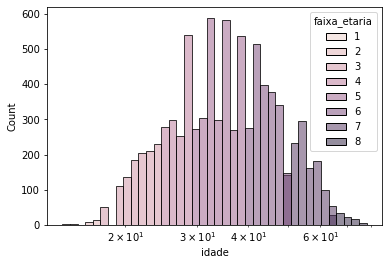

==================Categoria 6


count    2056.000000
mean       43.934339
std         2.864170
min        40.000000
25%        41.000000
50%        44.000000
75%        46.000000
max        49.000000
Name: idade, dtype: float64

==================Categoria 4


count    1371.000000
mean       26.951860
std         1.404067
min        25.000000
25%        26.000000
50%        27.000000
75%        28.000000
max        29.000000
Name: idade, dtype: float64

==================Categoria 7


count    1166.000000
mean       55.179245
std         3.957016
min        50.000000
25%        52.000000
50%        54.000000
75%        58.000000
max        64.000000
Name: idade, dtype: float64

==================Categoria 3


count    1126.000000
mean       21.723801
std         1.778664
min        18.000000
25%        20.000000
50%        22.000000
75%        23.000000
max        24.000000
Name: idade, dtype: float64

==================Categoria 5


count    2858.000000
mean       34.428971
std         2.839794
min        30.000000
25%        32.000000
50%        34.000000
75%        37.000000
max        39.000000
Name: idade, dtype: float64

==================Categoria 1


count     2.0
mean     14.0
std       0.0
min      14.0
25%      14.0
50%      14.0
75%      14.0
max      14.0
Name: idade, dtype: float64

==================Categoria 8


count    102.000000
mean      68.372549
std        3.239367
min       65.000000
25%       65.250000
50%       67.000000
75%       70.000000
max       78.000000
Name: idade, dtype: float64

==================Categoria 2


count    24.00000
mean     16.50000
std       0.65938
min      15.00000
25%      16.00000
50%      17.00000
75%      17.00000
max      17.00000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a faixa_etaria


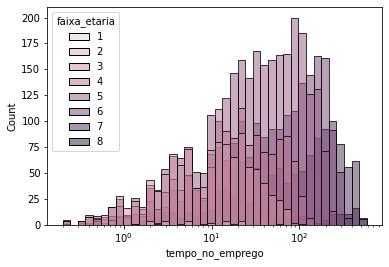

==================Categoria 6


count    2056.000000
mean       84.145088
std        78.149205
min         0.200000
25%        17.900000
50%        58.050000
75%       135.900000
max       357.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    1371.000000
mean       28.967250
std        27.362514
min         0.200000
25%         8.300000
50%        19.400000
75%        42.900000
max       133.400000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    1166.000000
mean      138.990652
std       126.036780
min         0.300000
25%        29.900000
50%       102.800000
75%       223.725000
max       536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    1126.000000
mean       14.913588
std        15.630854
min         0.200000
25%         3.625000
50%         9.900000
75%        20.900000
max       104.600000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    2858.000000
mean       52.218404
std        50.984511
min         0.200000
25%        11.900000
50%        33.250000
75%        80.900000
max       250.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count    2.000000
mean     1.800000
std      0.565685
min      1.400000
25%      1.600000
50%      1.800000
75%      2.000000
max      2.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    102.000000
mean     225.319608
std      166.654109
min        0.500000
25%       68.375000
50%      224.950000
75%      370.750000
max      589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    24.000000
mean     10.583333
std      12.549785
min       1.400000
25%       2.675000
50%       5.600000
75%      15.525000
max      59.900000
Name: tempo_no_emprego, dtype: float64

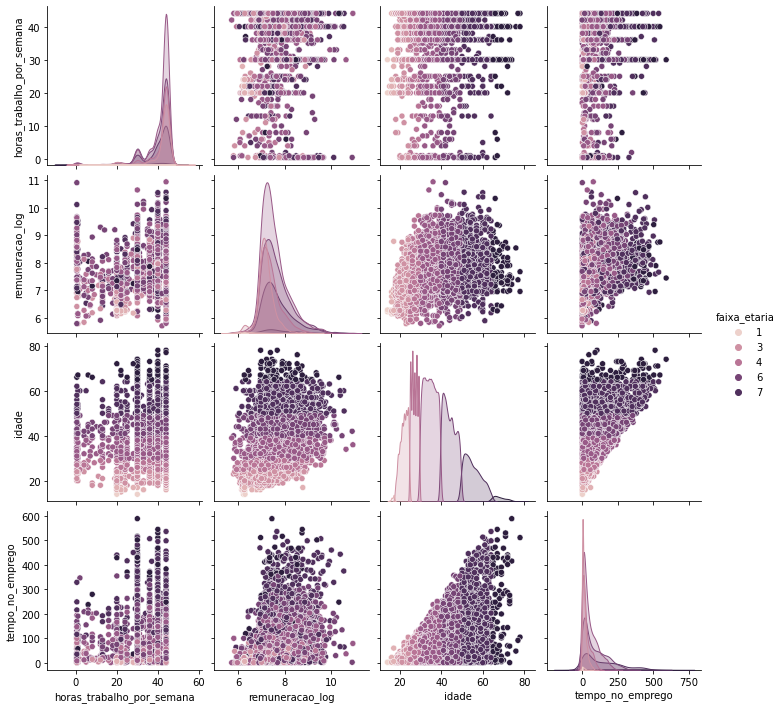

================cor_raca=============


,cor_raca,cor_raca
8,4527,0.520046
99,1838,0.211143
9,1093,0.125560
2,984,0.113038
4,200,0.022975
6,50,0.005744
1,13,0.001493


Grafico de distribuição de horas_trabalho_por_semana com relação a cor_raca


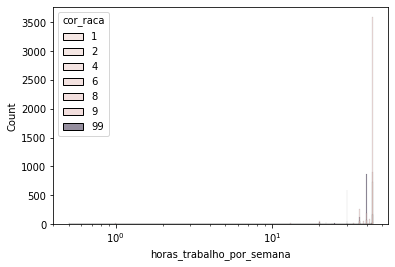

==================Categoria 8


count    4527.000000
mean       41.550585
std         6.962368
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    1093.000000
mean       42.038884
std         6.041038
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 99


count    1838.000000
mean       36.025571
std         6.155745
min         1.000000
25%        30.000000
50%        40.000000
75%        40.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    984.000000
mean      40.726626
std        8.273428
min        0.500000
25%       42.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    200.000000
mean      41.705000
std        6.170564
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    50.000000
mean     40.270000
std       9.652752
min       0.500000
25%      44.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    13.000000
mean     33.076923
std      16.352683
min       1.000000
25%      25.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a cor_raca


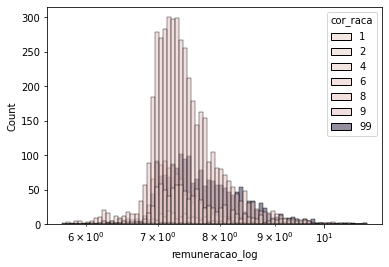

==================Categoria 8


count    4527.000000
mean        7.434670
std         0.552138
min         5.787357
25%         7.085956
50%         7.321532
75%         7.671650
max        10.917313
Name: remuneracao_log, dtype: float64

==================Categoria 9


count    1093.000000
mean        7.312458
std         0.480152
min         5.837585
25%         7.025049
50%         7.225518
75%         7.507053
max        10.236736
Name: remuneracao_log, dtype: float64

==================Categoria 99


count    1838.000000
mean        7.734122
std         0.631949
min         6.038181
25%         7.258525
50%         7.601320
75%         8.102212
max        10.651723
Name: remuneracao_log, dtype: float64

==================Categoria 2


count    984.000000
mean       7.622163
std        0.698533
min        5.708538
25%        7.135721
50%        7.441520
75%        7.928013
max       10.948158
Name: remuneracao_log, dtype: float64

==================Categoria 4


count    200.000000
mean       7.422895
std        0.500029
min        6.192281
25%        7.122429
50%        7.363602
75%        7.662500
max        9.329567
Name: remuneracao_log, dtype: float64

==================Categoria 6


count    50.000000
mean      7.429442
std       0.551498
min       6.308809
25%       7.006275
50%       7.316332
75%       7.682402
max       8.912648
Name: remuneracao_log, dtype: float64

==================Categoria 1


count    13.000000
mean      7.409270
std       0.548801
min       6.894214
25%       7.124575
50%       7.217473
75%       7.476931
max       8.780632
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a cor_raca


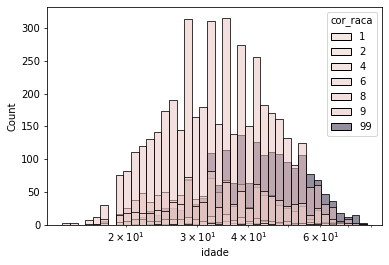

==================Categoria 8


count    4527.000000
mean       35.211619
std        10.437399
min        14.000000
25%        27.000000
50%        34.000000
75%        42.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 9


count    1093.000000
mean       34.308326
std        10.305547
min        17.000000
25%        26.000000
50%        33.000000
75%        41.000000
max        66.000000
Name: idade, dtype: float64

==================Categoria 99


count    1838.000000
mean       42.930903
std        11.142865
min        17.000000
25%        35.000000
50%        42.000000
75%        51.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 2


count    984.000000
mean      37.333333
std       11.258304
min       17.000000
25%       29.000000
50%       36.000000
75%       45.000000
max       77.000000
Name: idade, dtype: float64

==================Categoria 4


count    200.000000
mean      34.205000
std       10.969257
min       16.000000
25%       26.000000
50%       32.000000
75%       40.250000
max       67.000000
Name: idade, dtype: float64

==================Categoria 6


count    50.000000
mean     39.680000
std      10.222903
min      21.000000
25%      33.250000
50%      38.500000
75%      44.000000
max      64.000000
Name: idade, dtype: float64

==================Categoria 1


count    13.000000
mean     38.923077
std      10.735157
min      24.000000
25%      32.000000
50%      39.000000
75%      43.000000
max      59.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a cor_raca


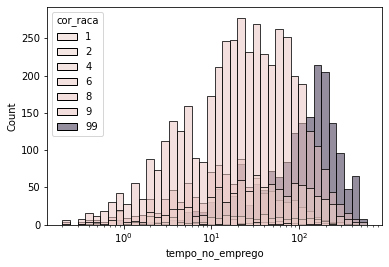

==================Categoria 8


count    4527.000000
mean       45.155953
std        56.476108
min         0.200000
25%         8.900000
50%        23.900000
75%        60.900000
max       456.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    1093.000000
mean       28.503019
std        40.314007
min         0.200000
25%         5.200000
50%        14.500000
75%        33.700000
max       436.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 99


count    1838.000000
mean      136.787976
std       108.652591
min         0.200000
25%        45.900000
50%       118.900000
75%       194.875000
max       589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    984.000000
mean      64.925305
std       77.733300
min        0.200000
25%       12.675000
50%       34.550000
75%       91.450000
max      545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    200.000000
mean      47.043500
std       56.933906
min        0.300000
25%        9.825000
50%       22.900000
75%       65.025000
max      376.700000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count     50.000000
mean      56.774000
std       61.941493
min        0.300000
25%       16.450000
50%       34.400000
75%       65.800000
max      263.800000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     13.000000
mean      71.353846
std       66.489719
min        7.500000
25%       32.500000
50%       52.600000
75%       76.800000
max      230.700000
Name: tempo_no_emprego, dtype: float64

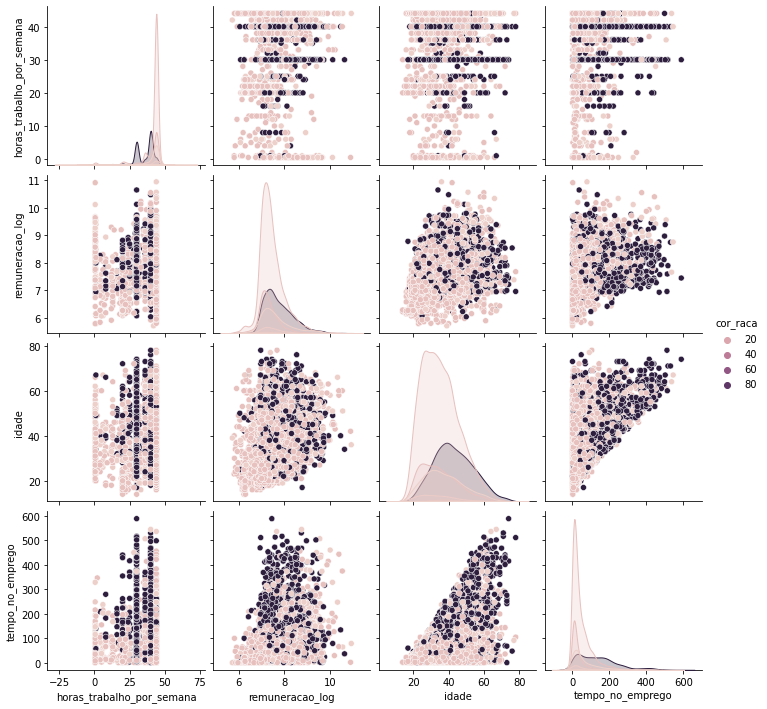

================escolaridade=============


,escolaridade,escolaridade
7,5476,0.629064
9,1000,0.114877
5,634,0.072832
6,493,0.056634
4,392,0.045032
8,296,0.034003
2,218,0.025043
3,149,0.017117
1,37,0.004250
11,10,0.001149


Grafico de distribuição de horas_trabalho_por_semana com relação a escolaridade


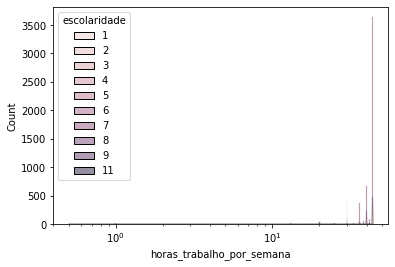

==================Categoria 7


count    5476.000000
mean       40.788349
std         6.535903
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    1000.000000
mean       37.300500
std        10.488539
min         0.500000
25%        36.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    296.000000
mean      40.866554
std        7.156715
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 2


count    218.000000
mean      41.885321
std        4.506080
min        8.000000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    634.000000
mean      40.197950
std        6.637762
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    493.000000
mean      40.027383
std        8.119581
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    392.000000
mean      40.883929
std        6.075393
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    149.000000
mean      41.429530
std        5.078113
min       20.000000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 11


count    10.000000
mean     30.100000
std      11.551335
min       8.000000
25%      22.500000
50%      30.000000
75%      40.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    37.000000
mean     41.027027
std       5.937108
min      16.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a escolaridade


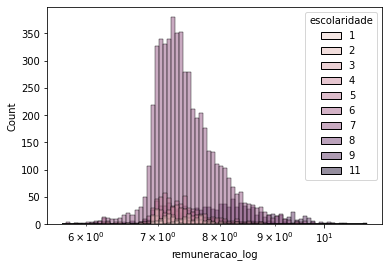

==================Categoria 7


count    5476.000000
mean        7.443353
std         0.512410
min         5.787357
25%         7.098433
50%         7.338183
75%         7.688328
max        10.205065
Name: remuneracao_log, dtype: float64

==================Categoria 9


count    1000.000000
mean        8.093886
std         0.820813
min         5.837585
25%         7.504370
50%         8.062214
75%         8.577196
max        10.948158
Name: remuneracao_log, dtype: float64

==================Categoria 8


count    296.000000
mean       7.585677
std        0.633694
min        5.912908
25%        7.132970
50%        7.453497
75%        7.898153
max        9.513036
Name: remuneracao_log, dtype: float64

==================Categoria 2


count    218.000000
mean       7.357687
std        0.430218
min        6.456016
25%        7.060485
50%        7.268997
75%        7.581763
max        9.184713
Name: remuneracao_log, dtype: float64

==================Categoria 5


count    634.000000
mean       7.388749
std        0.483175
min        6.010237
25%        7.082576
50%        7.297203
75%        7.574688
max        9.713457
Name: remuneracao_log, dtype: float64

==================Categoria 6


count    493.000000
mean       7.262850
std        0.485487
min        5.895312
25%        6.998053
50%        7.205747
75%        7.504953
max        9.455356
Name: remuneracao_log, dtype: float64

==================Categoria 4


count    392.000000
mean       7.385184
std        0.449257
min        5.708538
25%        7.100004
50%        7.305460
75%        7.605139
max        9.390763
Name: remuneracao_log, dtype: float64

==================Categoria 3


count    149.000000
mean       7.368712
std        0.379136
min        6.228708
25%        7.085927
50%        7.285246
75%        7.615274
max        8.753466
Name: remuneracao_log, dtype: float64

==================Categoria 11


count    10.000000
mean      8.912278
std       0.755843
min       8.166864
25%       8.319408
50%       8.817370
75%       9.137333
max      10.554747
Name: remuneracao_log, dtype: float64

==================Categoria 1


count    37.000000
mean      7.217290
std       0.423473
min       6.720932
25%       6.978708
50%       7.119344
75%       7.299872
max       9.154242
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a escolaridade


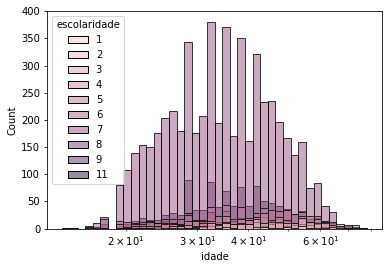

==================Categoria 7


count    5476.000000
mean       35.669649
std        10.453230
min        14.000000
25%        27.000000
50%        35.000000
75%        42.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 9


count    1000.000000
mean       38.471000
std         9.761273
min        20.000000
25%        31.000000
50%        37.000000
75%        44.000000
max        73.000000
Name: idade, dtype: float64

==================Categoria 8


count    296.000000
mean      31.706081
std        9.764243
min       18.000000
25%       24.000000
50%       30.000000
75%       37.000000
max       69.000000
Name: idade, dtype: float64

==================Categoria 2


count    218.000000
mean      44.376147
std       11.439111
min       19.000000
25%       36.000000
50%       44.000000
75%       53.000000
max       70.000000
Name: idade, dtype: float64

==================Categoria 5


count    634.000000
mean      41.070978
std       11.874928
min       15.000000
25%       33.000000
50%       40.000000
75%       50.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 6


count    493.000000
mean      35.440162
std       12.658064
min       15.000000
25%       26.000000
50%       34.000000
75%       44.000000
max       78.000000
Name: idade, dtype: float64

==================Categoria 4


count    392.000000
mean      43.181122
std       13.174235
min       14.000000
25%       33.000000
50%       42.000000
75%       53.000000
max       74.000000
Name: idade, dtype: float64

==================Categoria 3


count    149.000000
mean      43.973154
std       11.915778
min       21.000000
25%       35.000000
50%       42.000000
75%       53.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 11


count    10.000000
mean     39.400000
std       9.686187
min      27.000000
25%      31.750000
50%      39.500000
75%      43.750000
max      60.000000
Name: idade, dtype: float64

==================Categoria 1


count    37.000000
mean     44.189189
std      12.482961
min      19.000000
25%      35.000000
50%      44.000000
75%      54.000000
max      69.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a escolaridade


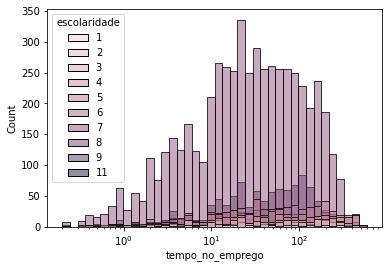

==================Categoria 7


count    5476.000000
mean       56.710628
std        70.503346
min         0.200000
25%         9.900000
50%        27.450000
75%        77.025000
max       545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    1000.000000
mean       65.450700
std        68.813555
min         0.200000
25%        15.975000
50%        43.900000
75%        97.900000
max       460.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    296.000000
mean      49.212838
std       62.734427
min        0.200000
25%       10.875000
50%       23.700000
75%       70.625000
max      536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 2


count    218.000000
mean      88.169725
std      102.670587
min        0.700000
25%       11.825000
50%       40.300000
75%      150.525000
max      461.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    634.000000
mean      93.745584
std      108.886300
min        0.300000
25%       14.700000
50%       46.100000
75%      142.400000
max      517.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    493.000000
mean      67.355375
std       90.972051
min        0.300000
25%       10.900000
50%       34.900000
75%       79.300000
max      589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    392.000000
mean     108.045663
std      127.363744
min        0.200000
25%       15.275000
50%       51.350000
75%      155.900000
max      530.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    149.000000
mean     105.381879
std      106.667817
min        1.400000
25%       18.400000
50%       70.400000
75%      170.600000
max      472.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 11


count     10.00000
mean      72.42000
std      111.88902
min        0.90000
25%       16.07500
50%       30.20000
75%       76.90000
max      375.10000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     37.000000
mean      76.908108
std       94.780918
min        0.500000
25%       10.900000
50%       28.300000
75%      116.600000
max      335.900000
Name: tempo_no_emprego, dtype: float64

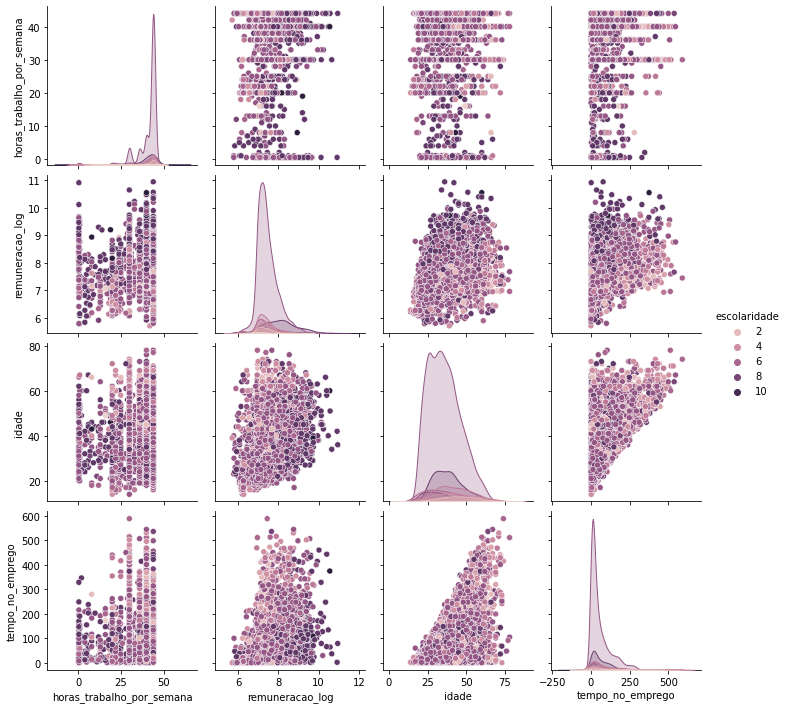

================portador_de_deficiencia=============


,portador_de_deficiencia,portador_de_deficiencia
0,8624,0.990695
1,81,0.009305


Grafico de distribuição de horas_trabalho_por_semana com relação a portador_de_deficiencia


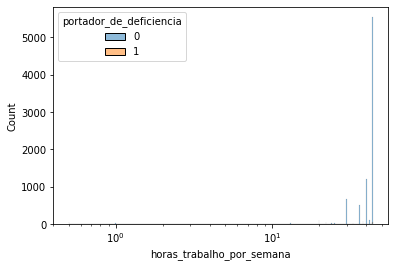

==================Categoria 0


count    8624.000000
mean       40.328096
std         7.259080
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 1


count    81.000000
mean     41.148148
std       5.322385
min      20.000000
25%      40.000000
50%      44.000000
75%      44.000000
max      44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a portador_de_deficiencia


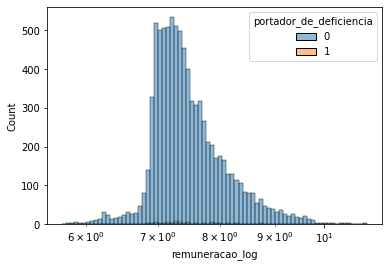

==================Categoria 0


count    8624.000000
mean        7.503836
std         0.595846
min         5.708538
25%         7.106893
50%         7.367952
75%         7.764664
max        10.948158
Name: remuneracao_log, dtype: float64

==================Categoria 1


count    81.000000
mean      7.457881
std       0.571350
min       6.282865
25%       7.076747
50%       7.326992
75%       7.821916
max       9.961947
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a portador_de_deficiencia


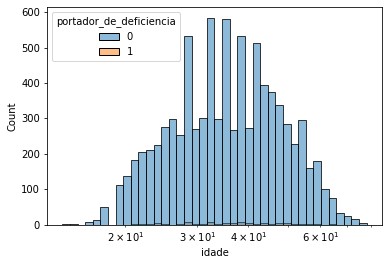

==================Categoria 0


count    8624.000000
mean       36.955821
std        11.145481
min        14.000000
25%        28.000000
50%        36.000000
75%        44.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 1


count    81.000000
mean     39.123457
std      11.039002
min      21.000000
25%      30.000000
50%      38.000000
75%      47.000000
max      65.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a portador_de_deficiencia


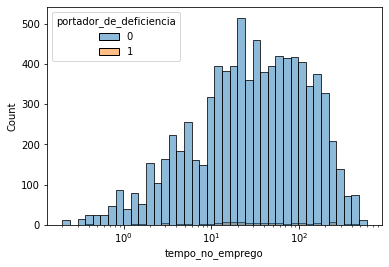

==================Categoria 0


count    8624.000000
mean       64.739425
std        81.145632
min         0.200000
25%        10.900000
50%        31.750000
75%        88.900000
max       589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 1


count     81.000000
mean      70.861728
std       94.844098
min        0.400000
25%       14.400000
50%       28.900000
75%       87.900000
max      456.800000
Name: tempo_no_emprego, dtype: float64

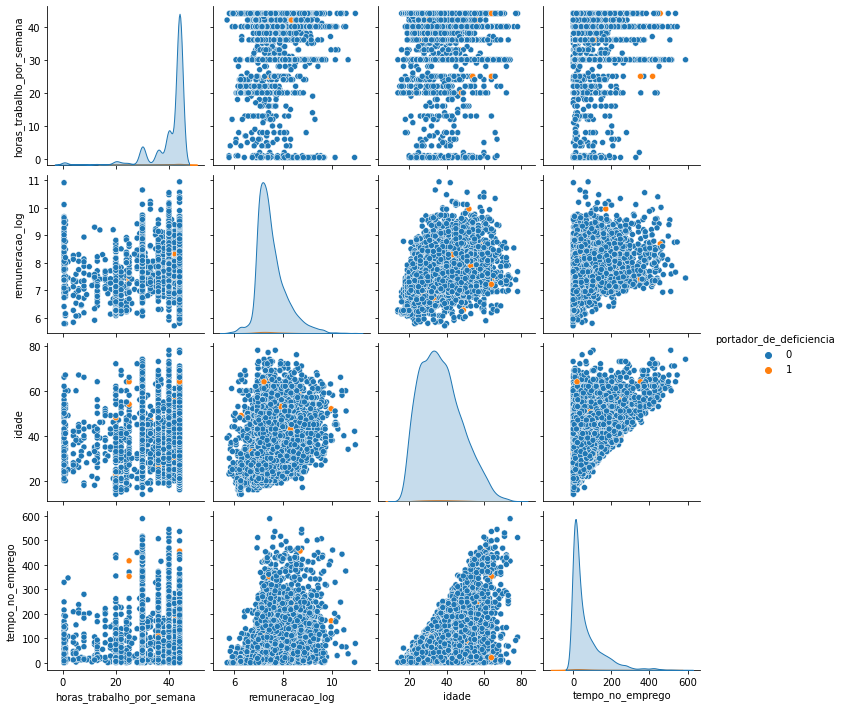

================tamanho_da_empresa=============


,tamanho_da_empresa,tamanho_da_empresa
10,1781,0.204595
5,1027,0.117978
7,1005,0.115451
9,959,0.110167
8,861,0.098909
4,840,0.096496
3,774,0.088914
6,758,0.087076
2,700,0.080414


Grafico de distribuição de horas_trabalho_por_semana com relação a tamanho_da_empresa


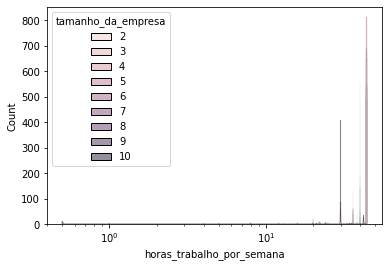

==================Categoria 2


count    700.000000
mean      42.655000
std        5.345025
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 7


count    1005.000000
mean       40.267662
std         7.866320
min         0.500000
25%        40.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 4


count    840.000000
mean      41.764286
std        6.735451
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 5


count    1027.000000
mean       41.124635
std         8.008618
min         0.500000
25%        44.000000
50%        44.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 8


count    861.000000
mean      40.229384
std        7.372951
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 6


count    758.000000
mean      40.434037
std        8.276130
min        0.500000
25%       40.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 9


count    959.000000
mean      39.152763
std        8.143825
min        0.500000
25%       38.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 10


count    1781.000000
mean       37.985121
std         6.210464
min         0.500000
25%        30.000000
50%        40.000000
75%        44.000000
max        44.000000
Name: horas_trabalho_por_semana, dtype: float64

==================Categoria 3


count    774.000000
mean      42.625969
std        4.900625
min        0.500000
25%       44.000000
50%       44.000000
75%       44.000000
max       44.000000
Name: horas_trabalho_por_semana, dtype: float64

Grafico de distribuição de remuneracao_log com relação a tamanho_da_empresa


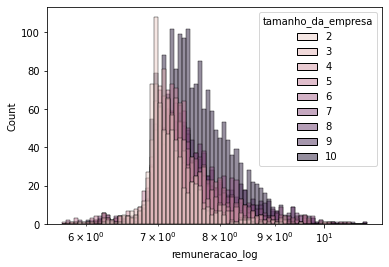

==================Categoria 2


count    700.000000
mean       7.196038
std        0.384040
min        5.928285
25%        6.961132
50%        7.109475
75%        7.335248
max        9.473646
Name: remuneracao_log, dtype: float64

==================Categoria 7


count    1005.000000
mean        7.570358
std         0.631513
min         5.912908
25%         7.158654
50%         7.427198
75%         7.883575
max        10.554747
Name: remuneracao_log, dtype: float64

==================Categoria 4


count    840.000000
mean       7.374104
std        0.528694
min        5.787357
25%        7.057183
50%        7.275079
75%        7.570992
max       10.569970
Name: remuneracao_log, dtype: float64

==================Categoria 5


count    1027.000000
mean        7.447721
std         0.587913
min         5.708538
25%         7.088755
50%         7.309366
75%         7.711515
max        10.403426
Name: remuneracao_log, dtype: float64

==================Categoria 8


count    861.000000
mean       7.648199
std        0.667777
min        6.016669
25%        7.213496
50%        7.472796
75%        7.891824
max       10.948158
Name: remuneracao_log, dtype: float64

==================Categoria 6


count    758.000000
mean       7.503040
std        0.602201
min        5.790082
25%        7.100978
50%        7.361998
75%        7.796857
max       10.343246
Name: remuneracao_log, dtype: float64

==================Categoria 9


count    959.000000
mean       7.662278
std        0.676178
min        6.129028
25%        7.201271
50%        7.487454
75%        7.996315
max       10.917313
Name: remuneracao_log, dtype: float64

==================Categoria 10


count    1781.000000
mean        7.617011
std         0.554619
min         5.895312
25%         7.220893
50%         7.509741
75%         7.939911
max        10.205065
Name: remuneracao_log, dtype: float64

==================Categoria 3


count    774.000000
mean       7.289726
std        0.459306
min        5.840176
25%        7.027827
50%        7.185455
75%        7.445279
max       10.018843
Name: remuneracao_log, dtype: float64

Grafico de distribuição de idade com relação a tamanho_da_empresa


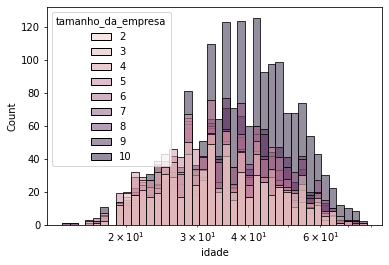

==================Categoria 2


count    700.000000
mean      35.442857
std       11.157906
min       16.000000
25%       26.000000
50%       33.000000
75%       43.000000
max       67.000000
Name: idade, dtype: float64

==================Categoria 7


count    1005.000000
mean       37.003980
std        11.215473
min        14.000000
25%        28.000000
50%        36.000000
75%        45.000000
max        73.000000
Name: idade, dtype: float64

==================Categoria 4


count    840.000000
mean      34.664286
std       10.683513
min       17.000000
25%       26.000000
50%       33.000000
75%       41.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 5


count    1027.000000
mean       35.167478
std        10.451745
min        16.000000
25%        27.000000
50%        34.000000
75%        42.000000
max        77.000000
Name: idade, dtype: float64

==================Categoria 8


count    861.000000
mean      37.657375
std       11.107714
min       15.000000
25%       29.000000
50%       36.000000
75%       45.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 6


count    758.000000
mean      36.081794
std       11.067878
min       16.000000
25%       28.000000
50%       35.000000
75%       42.000000
max       72.000000
Name: idade, dtype: float64

==================Categoria 9


count    959.000000
mean      38.134515
std       10.575390
min       14.000000
25%       30.000000
50%       37.000000
75%       45.000000
max       73.000000
Name: idade, dtype: float64

==================Categoria 10


count    1781.000000
mean       39.977541
std        11.267311
min        17.000000
25%        32.000000
50%        39.000000
75%        47.000000
max        78.000000
Name: idade, dtype: float64

==================Categoria 3


count    774.000000
mean      35.010336
std       11.222547
min       17.000000
25%       26.000000
50%       33.000000
75%       42.000000
max       78.000000
Name: idade, dtype: float64

Grafico de distribuição de tempo_no_emprego com relação a tamanho_da_empresa


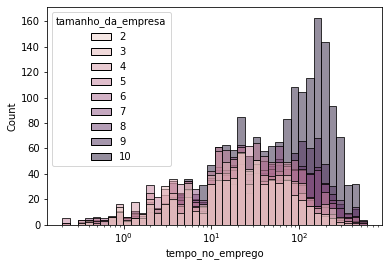

==================Categoria 2


count    700.000000
mean      39.329857
std       49.839931
min        0.300000
25%        8.900000
50%       22.350000
75%       48.075000
max      342.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 7


count    1005.000000
mean       61.063284
std        78.107571
min         0.200000
25%        10.600000
50%        30.100000
75%        79.700000
max       545.500000
Name: tempo_no_emprego, dtype: float64

==================Categoria 4


count    840.000000
mean      39.628571
std       54.321620
min        0.200000
25%        6.900000
50%       20.400000
75%       53.425000
max      414.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 5


count    1027.000000
mean       44.941870
std        62.753472
min         0.200000
25%         7.900000
50%        22.300000
75%        56.850000
max       536.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 8


count    861.000000
mean      72.167596
std       87.615732
min        0.400000
25%       10.900000
50%       36.800000
75%      103.100000
max      468.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 6


count    758.000000
mean      52.134697
std       72.369372
min        0.200000
25%        9.400000
50%       24.400000
75%       67.600000
max      517.200000
Name: tempo_no_emprego, dtype: float64

==================Categoria 9


count    959.000000
mean      79.295412
std       85.976300
min        0.200000
25%       15.900000
50%       47.600000
75%      120.850000
max      530.900000
Name: tempo_no_emprego, dtype: float64

==================Categoria 10


count    1781.000000
mean      103.779057
std       101.055422
min         0.200000
25%        19.900000
50%        75.500000
75%       164.700000
max       589.300000
Name: tempo_no_emprego, dtype: float64

==================Categoria 3


count    774.000000
mean      42.868992
std       56.240691
min        0.200000
25%        8.975000
50%       21.800000
75%       55.900000
max      460.900000
Name: tempo_no_emprego, dtype: float64

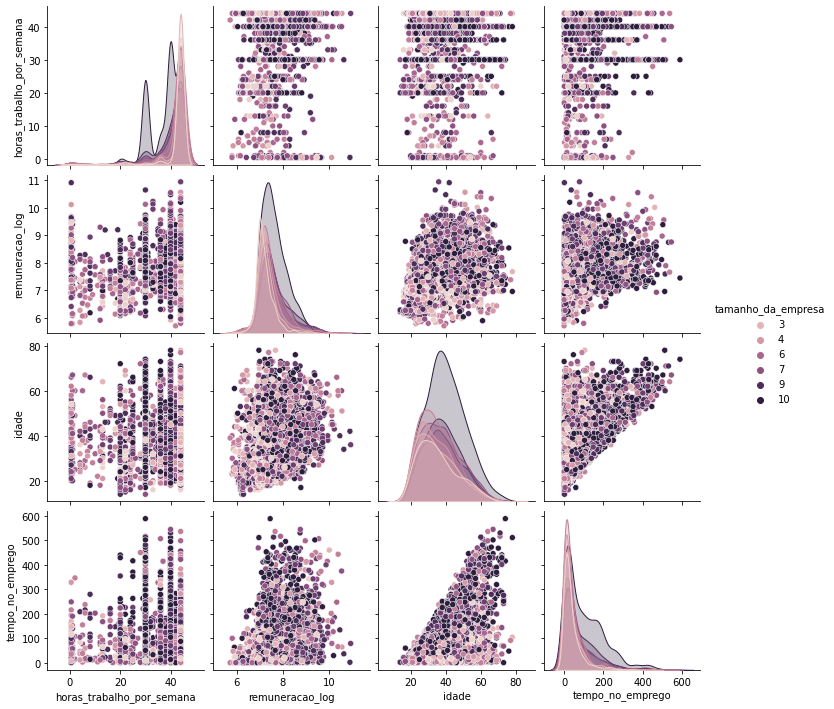

In [ ]:
def tira_0(x):
  if x == 0:
    return 0.5
  else:
    return x
cat = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num = derere_normal.drop(cat, axis = 1).columns.copy()
palette=sns.color_palette("Paired")
dad = derere_normal.copy()
for i in cat:
  p = num.to_list().copy()
  print(f'================{i}=============')
  display(pd.concat([derere_normal[i].value_counts(), derere_normal[i].value_counts(normalize = True)], axis = 1))
  for j in num:
    if 0 in dad[j].unique():
      dad[j] = dad[j].apply(tira_0)
    else:
      pass
    print(f'Grafico de distribuição de {j} com relação a {i}')
    fig = px.histogram(dad, x = j, color = i)
    fig.show()
    dad[dad[j]==0][j] = 10
    sns.histplot(data = dad, x = j, hue = i, log_scale = True, )
    sns.histplot(palette=palette)
    plt.show()
    for k in dad[i].unique():
      print(f'==================Categoria {k}')
      filt = dad[dad[i]==k].copy()
      display(filt[j].describe())

  p.append(i)
  sns.pairplot(data = dad[p], hue = i)
  plt.show()

In [ ]:
dados_1_1['tamanho_da_empresa'].value_counts()
#dados.columns escolaridade, raça, sexo e portador_de_deficiencia
dados.columns

Index(['sexo', 'idade', 'faixa_etaria', 'cor_raca', 'escolaridade',
       'horas_trabalho_por_semana', 'portador_de_deficiencia',
       'tamanho_da_empresa', 'tempo_no_emprego', 'remuneracao', 'id'],
      dtype='object')

In [ ]:

dados_1_1 = treino[mask_13 | mask_14 | mask_15 | mask_16 | mask_17 | mask_18].copy()
dados_1_1 = dados_1_1.drop(['id', 'tempo_no_emprego', 'idade'], axis = 1)
dados_1_2 = treino.drop(dados_1_1.index).copy()
dados_1_2 = dados_1_2.drop(['id', 'tempo_no_emprego', 'idade'], axis = 1)

num_11 = ['horas_trabalho_por_semana','idade_transf', 'tempo_no_emprego_raiz']
cat_11 = ['sexo', 'faixa_etaria', 'cor_raca', 'escolaridade', 'portador_de_deficiencia', 'tamanho_da_empresa']
num_12 = ['horas_trabalho_por_semana','idade_transf', 'tempo_no_emprego_raiz', 'faixa_etaria', 'escolaridade', 'tamanho_da_empresa']
cat_12 = ['sexo', 'cor_raca', 'portador_de_deficiencia']




dados_6_1 = dados_1_1.copy()
dados_6_1 = dados_6_1.drop(['faixa_etaria', 'portador_de_deficiencia'], axis = 1)
dados_6_2 = dados_1_2.copy()
dados_6_2 = dados_6_2.drop(['faixa_etaria', 'portador_de_deficiencia'], axis = 1)

num_61 = ['horas_trabalho_por_semana','idade_transf', 'tempo_no_emprego_raiz']
cat_61 = ['sexo', 'cor_raca', 'escolaridade', 'tamanho_da_empresa']
num_62 = ['horas_trabalho_por_semana','idade_transf', 'tempo_no_emprego_raiz', 'escolaridade', 'tamanho_da_empresa']
cat_62 = ['sexo', 'cor_raca']



dados_5_1 = dados_1_1.copy()
dados_5_1 = dados_5_1.drop(['escolaridade', 'cor_raca', 'sexo', 'portador_de_deficiencia', 'faixa_etaria'], axis = 1)
dados_5_2 = dados_1_2.copy()
dados_5_2 = dados_5_2.drop(['portador_de_deficiencia', 'faixa_etaria'], axis = 1)
num_5_1 = ['idade_transf', 'tempo_no_emprego_raiz']
cat_5_1 = ['horas_trabalho_por_semana', 'tamanho_da_empresa']
num_5_2 = ['horas_trabalho_por_semana','idade_transf', 'tempo_no_emprego_raiz', 'escolaridade', 'tamanho_da_empresa']
cat_5_2 = ['sexo', 'cor_raca']
dados_5_1.columns
def transf_horas_trabalho(x):
  if x < 40:
    return 30
  elif x == 40:
    return 40
  else: 
    return 44
  
def transf_tamanho(x):
  if x == 10:
    return 1
  else:
    return 0

dados_5_1['horas_trabalho_por_semana'] = dados_5_1['horas_trabalho_por_semana'].apply(transf_horas_trabalho)
dados_5_1['tamanho_da_empresa'] = dados_5_1['tamanho_da_empresa'].apply(transf_tamanho)


In [ ]:
from sklearn.ensemble import VotingRegressor, StackingRegressor


#dadosao_1 = [dados_1_1, dados_6_1, dados_5_1]
#dadosao_2 = [dados_1_2, dados_6_2, dados_5_2]
dadosao_1 = [dados_1_1, dados_6_1, dados_5_1]
dadosao_2 = [dados_1_2, dados_6_2, dados_5_2]

num_cats = [[(num_11, cat_11), (num_12, cat_12)],
           [(num_61, cat_61), (num_62, cat_62)],
            [(num_5_1,cat_5_1,num_5_2,cat_5_2)]]


r1 = Lasso()
r2 = RandomForestRegressor()
estimators = [('lr', r1), ('rf', r2)]
estimators_2 = [('Elastic', ElasticNet()), ('lgbm', LGBMRegressor()), ('SVM', SVR())]
combinado_1 = VotingRegressor([('lr', r1), ('rf', r2)])
combinado_2 = VotingRegressor([('Elastic', ElasticNet()), ('lgbm', LGBMRegressor()), ('SVM', SVR())])

stacking_1 = StackingRegressor(estimators=estimators)
stacking_2 = StackingRegressor(estimators = estimators_2, final_estimator = RandomForestRegressor())


modelos = [RandomForestRegressor(), GradientBoostingRegressor(), KNeighborsRegressor(),
           Ridge(), Lasso(), ElasticNet(), SVR(), LGBMRegressor(), XGBRegressor(), combinado_1, combinado_2, stacking_1, stacking_2]

name_modelos = ['RF', 'GBR', 'KNN', 'L2', 'L1', 'L1_L2', 'SVM', 'LGBM', 'XGB', 'Combinado_1', 'combinado_2', 'stacking_1', 'stacking_2']

scalers = [StandardScaler()]
encoders = [ce.CatBoostEncoder()]
name_dados = [1,6, 5]
name_scal = ['Standard']
name_encoder = ['CatBoost']
num_cats_name = [1,2]

data_frame_1 = []
mae_train_list_1 = []
mae_test_list_1 = []
rmse_train_list_1 = []
rmse_test_list_1 = []
r2_train_list_1 = []
r2_test_list_1 = []
tipo_1 = []
mae_medio_train_1 = []
mae_median_train_1 = []
mae_std_train_1 = []
rmse_medio_train_1 = []
rmse_std_train_1 = []
r2_medio_train_1 = []
r2_std_train_1 = []
mae_medio_test_1 = []
mae_median_test_1 = []
mae_std_test_1 = []
rmse_medio_test_1 = []
rmse_std_test_1 = []
r2_medio_test_1 = []
r2_std_test_1 = []
preditos_test_1 = []
real_test_1 =  np.exp(treino[mask_13 | mask_14 | mask_15 | mask_16 | mask_17 | mask_18].copy().remuneracao_log)



data_frame_2 = []
mae_train_list_2 = []
mae_test_list_2 = []
rmse_train_list_2 = []
rmse_test_list_2 = []
r2_train_list_2 = []
r2_test_list_2 = []
tipo_2 = []
mae_medio_train_2 = []
mae_median_train_2 = []
mae_std_train_2 = []
rmse_medio_train_2 = []
rmse_std_train_2 = []
r2_medio_train_2 = []
r2_std_train_2 = []
mae_medio_test_2 = []
mae_median_test_2 = []
mae_std_test_2 = []
rmse_medio_test_2 = []
rmse_std_test_2 = []
r2_medio_test_2 = []
r2_std_test_2 = []
preditos_test_2 = []
real_test_2 =  np.exp(treino.drop(real_test_1.index).remuneracao_log)



columns = ['MAE_TRAIN_MEAN', 'MAE_TEST_MEAN',
                     'MAE_TRAIN_SUM','MAE_TEST_SUM',
                     'MAE_TRAIN_STD', 'MAE_TEST_STD',
                     'RMSE_TRAIN_MEAN', 'RMSE_TEST_MEAN',
                     'RMSE_TRAIN_STD', 'RMSE_TEST_STD',
                     'R2_TRAIN_MEAN', 'R2_TEST_MEAN',
                     'R2_TRAIN_STD', 'R2_TEST_STD']
                     


for pos_dados, dados_aqui in enumerate(dadosao_1):
  for pos_cat, num_cat in enumerate(num_cats[pos_dados]):
    for pos_scaler, scaler in enumerate(scalers):
      for pos_encoder, encoder in enumerate(encoders):
        for pos_modelo, modelo in enumerate(modelos):
          print(f'=================Rodando {name_modelos[pos_modelo]}=================')
            
          mae_train, mae_test, rmse_train, rmse_test, r2_train, r2_test, preditos = retorna_resultados(X = dados_aqui.drop('remuneracao_log', axis = 1),
                                                                                             y = dados_aqui.remuneracao_log,
                                                                                             modelo = modelo,
                                                                                             num = num_cat[0],
                                                                                             cat = num_cat[1],
                                                                                             scaler = scaler, encoder = encoder)
          
          mae_train_list_1.append(mae_train)
          mae_test_list_1.append(mae_test)
          rmse_train_list_1.append(rmse_train)
          rmse_test_list_1.append(rmse_test)
          r2_train_list_1.append(r2_train)
          r2_test_list_1.append(r2_test)
          preditos_test_1.append(preditos)
          tipo_1.append(f'''Dados: {name_dados[pos_dados]}
                      Categorias: {num_cats_name[pos_cat]}
                      Scaler: {name_scal[pos_scaler]}
                      Encoder: {name_encoder[pos_encoder]}
                      Modelo: {name_modelos[pos_modelo]}''')
          
          mae_medio_train_1.append(mae_train.mean())
          mae_median_train_1.append(mae_train.sum())
          mae_std_train_1.append(mae_train.std())
          mae_medio_test_1.append(mae_test.mean())
          mae_median_test_1.append(mae_test.sum())
          mae_std_test_1.append(mae_test.std())
          rmse_medio_train_1.append(rmse_train.mean())
          rmse_std_train_1.append(rmse_train.std())
          rmse_medio_test_1.append(rmse_test.mean())
          rmse_std_test_1.append(rmse_test.std())
          r2_medio_train_1.append(r2_train.mean())
          r2_std_train_1.append(r2_train.std())
          r2_medio_test_1.append(r2_test.mean())
          r2_std_test_1.append(r2_test.std())

          data_frame_1.append([mae_train.mean(), mae_test.mean(),
                             mae_train.sum(), mae_test.sum(),
                             mae_train.std(), mae_test.std(),
                             rmse_train.mean(), rmse_test.mean(),
                             rmse_train.std(), rmse_test.std(),
                             r2_train.mean(), r2_test.mean(),
                             r2_train.std(), r2_test.std()])
          


          if pos_dados ==2:
            mae_train, mae_test, rmse_train, rmse_test, r2_train, r2_test, preditos = retorna_resultados(X = dadosao_2[pos_dados].drop('remuneracao_log', axis = 1),
                                                                                             y = dadosao_2[pos_dados].remuneracao_log,
                                                                                             modelo = modelo,
                                                                                             num = num_cat[2],
                                                                                             cat = num_cat[2],
                                                                                             scaler = scaler, encoder = encoder)
          else:
          
            mae_train, mae_test, rmse_train, rmse_test, r2_train, r2_test, preditos = retorna_resultados(X = dadosao_2[pos_dados].drop('remuneracao_log', axis = 1),
                                                                                              y = dadosao_2[pos_dados].remuneracao_log,
                                                                                              modelo = modelo,
                                                                                              num = num_cat[0],
                                                                                              cat = num_cat[1],
                                                                                              scaler = scaler, encoder = encoder)
          
          mae_train_list_2.append(mae_train)
          mae_test_list_2.append(mae_test)
          rmse_train_list_2.append(rmse_train)
          rmse_test_list_2.append(rmse_test)
          r2_train_list_2.append(r2_train)
          r2_test_list_2.append(r2_test)
          preditos_test_2.append(preditos)
          tipo_2.append(f'''Dados: {name_dados[pos_dados]}
                      Categorias: {num_cats_name[pos_cat]}
                      Scaler: {name_scal[pos_scaler]}
                      Encoder: {name_encoder[pos_encoder]}
                      Modelo: {name_modelos[pos_modelo]}''')
          
          mae_medio_train_2.append(mae_train.mean())
          mae_median_train_2.append(mae_train.sum())
          mae_std_train_2.append(mae_train.std())
          mae_medio_test_2.append(mae_test.mean())
          mae_median_test_2.append(mae_test.sum())
          mae_std_test_2.append(mae_test.std())
          rmse_medio_train_2.append(rmse_train.mean())
          rmse_std_train_2.append(rmse_train.std())
          rmse_medio_test_2.append(rmse_test.mean())
          rmse_std_test_2.append(rmse_test.std())
          r2_medio_train_2.append(r2_train.mean())
          r2_std_train_2.append(r2_train.std())
          r2_medio_test_2.append(r2_test.mean())
          r2_std_test_2.append(r2_test.std())

          data_frame_2.append([mae_train.mean(), mae_test.mean(),
                             mae_train.sum(), mae_test.sum(),
                             mae_train.std(), mae_test.std(),
                             rmse_train.mean(), rmse_test.mean(),
                             rmse_train.std(), rmse_test.std(),
                             r2_train.mean(), r2_test.mean(),
                             r2_train.std(), r2_test.std()])




          
          print(f'=================Rodou o {name_modelos[pos_modelo]}=================')
          
          

=================Rodando RF=================
=================Rodou o RF=================
=================Rodando GBR=================
=================Rodou o GBR=================
=================Rodando KNN=================
=================Rodou o KNN=================
=================Rodando L2=================
=================Rodou o L2=================
=================Rodando L1=================
=================Rodou o L1=================
=================Rodando L1_L2=================
=================Rodou o L1_L2=================
=================Rodando SVM=================
=================Rodou o SVM=================
=================Rodando LGBM=================
=================Rodou o LGBM=================
=================Rodando XGB=================
[01:36:47] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:36:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now depre

In [ ]:
pd.set_option('display.max_rows', None)
df_1 = pd.DataFrame(data_frame_1, index = tipo_1, columns = columns).sort_values('MAE_TEST_MEAN', ascending = False)
df_1

,MAE_TRAIN_MEAN,MAE_TEST_MEAN,MAE_TRAIN_SUM,MAE_TEST_SUM,MAE_TRAIN_STD,MAE_TEST_STD,RMSE_TRAIN_MEAN,RMSE_TEST_MEAN,RMSE_TRAIN_STD,RMSE_TEST_STD,R2_TRAIN_MEAN,R2_TEST_MEAN,R2_TRAIN_STD,R2_TEST_STD
Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,-0.459055,-0.517193,-2.295275,-2.585966,0.005243,0.020778,-0.592051,-0.663020,0.007792,0.028290,0.336544,0.159272,0.009669,0.038769
Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,-0.459055,-0.517222,-2.295275,-2.586108,0.005243,0.020837,-0.592051,-0.662970,0.007792,0.028305,0.336544,0.159368,0.009669,0.039474
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,-0.458872,-0.517374,-2.294359,-2.586870,0.005327,0.020493,-0.591589,-0.663040,0.007905,0.027914,0.337597,0.159164,0.008505,0.039211
Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,-0.458872,-0.517414,-2.294359,-2.587068,0.005327,0.020438,-0.591589,-0.663185,0.007905,0.027894,0.337597,0.158846,0.008505,0.038143
Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.454740,-0.518451,-2.273699,-2.592257,0.005185,0.019403,-0.585475,-0.665142,0.008148,0.026613,0.351232,0.153811,0.008048,0.037008
Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.454740,-0.518564,-2.273699,-2.592819,0.005185,0.019349,-0.585475,-0.665186,0.008148,0.026539,0.351232,0.153686,0.008048,0.037151
Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.454487,-0.519030,-2.272435,-2.595148,0.004983,0.020352,-0.585038,-0.664952,0.007676,0.027776,0.352190,0.154271,0.007609,0.039890
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.454487,-0.519117,-2.272435,-2.595587,0.004983,0.020240,-0.585038,-0.664863,0.007676,0.027667,0.352190,0.154471,0.007609,0.040177
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,-0.322934,-0.525558,-1.614671,-2.627792,0.007689,0.025908,-0.412640,-0.674731,0.009045,0.030650,0.677596,0.130184,0.012953,0.021450
Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,-0.319993,-0.526421,-1.599966,-2.632103,0.011507,0.026847,-0.408899,-0.675602,0.014493,0.031633,0.683298,0.128070,0.020062,0.020033


In [ ]:

df_2 = pd.DataFrame(data_frame_2, index = tipo_2, columns = columns).sort_values('MAE_TEST_MEAN', ascending = False)
df_2

,MAE_TRAIN_MEAN,MAE_TEST_MEAN,MAE_TRAIN_SUM,MAE_TEST_SUM,MAE_TRAIN_STD,MAE_TEST_STD,RMSE_TRAIN_MEAN,RMSE_TEST_MEAN,RMSE_TRAIN_STD,RMSE_TEST_STD,R2_TRAIN_MEAN,R2_TEST_MEAN,R2_TRAIN_STD,R2_TEST_STD
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,-0.278744,-0.325379,-1.393718,-1.626893,0.001434,0.005983,-0.374960,-0.443427,0.001730,0.011495,0.603479,0.443202,0.006244,0.019830
Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,-0.278744,-0.325379,-1.393718,-1.626893,0.001434,0.005983,-0.374960,-0.443427,0.001730,0.011495,0.603479,0.443202,0.006244,0.019830
Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,-0.278705,-0.325692,-1.393523,-1.628461,0.001764,0.005738,-0.375120,-0.444211,0.002581,0.011782,0.603148,0.441187,0.006439,0.021563
Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,-0.278705,-0.325692,-1.393523,-1.628461,0.001764,0.005738,-0.375120,-0.444211,0.002581,0.011782,0.603148,0.441187,0.006439,0.021563
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.316895,-0.329244,-1.584473,-1.646220,0.002389,0.006774,-0.427199,-0.446656,0.003241,0.012777,0.485372,0.435209,0.003042,0.018405
Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.316913,-0.329252,-1.584563,-1.646258,0.002309,0.007078,-0.427217,-0.446604,0.003249,0.013222,0.485328,0.435419,0.003209,0.016892
Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.316895,-0.329255,-1.584473,-1.646274,0.002389,0.006810,-0.427199,-0.446675,0.003241,0.012799,0.485372,0.435170,0.003042,0.018147
Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,-0.316913,-0.329257,-1.584563,-1.646283,0.002309,0.007059,-0.427217,-0.446566,0.003249,0.013168,0.485328,0.435514,0.003209,0.016802
Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,-0.317803,-0.330261,-1.589015,-1.651306,0.002566,0.006709,-0.428658,-0.447729,0.003484,0.013075,0.481856,0.432534,0.002907,0.017663
Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,-0.317787,-0.330283,-1.588936,-1.651417,0.002471,0.006917,-0.428644,-0.447699,0.003212,0.013260,0.481881,0.432641,0.003431,0.017125


In [ ]:
real_test_1 = np.exp(treino[mask_13 | mask_14 | mask_15 | mask_16 | mask_17 | mask_18].copy().remuneracao_log)
real_test_2 = np.exp(treino.drop(real_test_1.index).remuneracao_log)

In [ ]:
pd.set_option('display.max_rows', 10)

df_1 = pd.DataFrame(preditos_test_1).T
df_1 = df_1.set_index(real_test_1.index)
df_1.columns = tipo_1
df_1 = pd.concat([df_1, pd.Series(real_test_1, name = 'VERDADEIRO')], axis = 1)
df_1

,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combinado_2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combinado_2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combinado_2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combi

In [ ]:
pd.set_option('display.max_rows', 10)
real_test_2 =  np.exp(treino.drop(real_test_1.index).copy().remuneracao_log)
df_2 = pd.DataFrame(preditos_test_2).T
df_2 = df_2.set_index(real_test_2.index)
df_2.columns = tipo_2
df_2 = pd.concat([df_2, pd.Series(real_test_2, name = 'VERDADEIRO')], axis = 1)
df_2

,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combinado_2,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,Dados: 1\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combinado_2,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,Dados: 1\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combinado_2,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_1,Dados: 6\n Categorias: 1\n Scaler: Standard\n Encoder: CatBoost\n Modelo: stacking_2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: RF,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: GBR,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: KNN,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: L1_L2,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: SVM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: LGBM,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: XGB,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: Combinado_1,Dados: 6\n Categorias: 2\n Scaler: Standard\n Encoder: CatBoost\n Modelo: combi

In [ ]:
erros_1 = df_1.copy()
for column in erros_1.columns:
  erros_1[column] = erros_1[column] - erros_1['VERDADEIRO']
erros_1.sum()

Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: RF            -1.894897e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: GBR           -2.357225e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: KNN           -1.658296e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L2            -2.489973e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L1            -2.805126e+06
                                                                      

In [ ]:
erros_2 = df_2.copy()
for column in erros_2.columns:
  erros_2[column] = erros_2[column] - erros_2['VERDADEIRO']
erros_2.sum()

Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: RF            -2.082762e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: GBR           -2.794437e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: KNN           -2.192457e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L2            -3.292934e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L1            -4.087131e+06
                                                                      

In [ ]:
t_1 = erros_1.filter(regex = '(Dados: 6|Dados: 1)').filter(regex = 'CatB').filter(regex = 'Standard').filter(regex = 'Categorias: 1\n')
metricas_1 = t_1.T.describe()
metricas_1

,1578,3219,976,2963,11038,3912,10950,11923,12450,7907,37,576,4822,2245,5270,4165,6454,1180,9185,10735,5277,8254,11705,10565,7706,4454,5340,11113,8159,13039,7936,9505,9211,9881,3873,8852,2801,12853,10778,7254,...,11494,13931,10921,11506,6668,3242,1757,6019,863,7035,1028,14183,14434,11837,13067,6278,6184,391,2027,8571,14552,7892,7869,11990,14605,14737,7989,1021,7513,10627,1528,4658,9998,2747,7849,8666,2433,10583,8322,6265
count,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,...,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000
mean,2510.973597,-5726.537840,368.596379,-5276.541421,-361.476471,-9709.690538,-212.906973,84.569497,2607.245451,1378.191654,-6843.136576,2574.699141,-2036.281005,94.917041,580.450067,423.051096,136.229994,3407.098590,-3638.576424,2777.460231,3994.012258,2032.518048,-8992.896767,2065.093804,2300.158111,-2686.039415,-879.843453,-2176.303515,3545.199986,3613.262861,169.297566,4139.574731,1580.215728,-410.374457,-1329.408239,4094.659744,-3147.786935,478.842220,-566.776835,-6320.279529,...,-1794.928858,-5297.481337,-7695.903228,-146.230406,1813.730384,-9358.598020,3285.438981,4361.948978,-6081.553225,-831.712596,-3745.323610,-1957.901871,1081.380351,-16609.828834,239.461605,-9752.435674,-2087.913252,2123.827798,5.596514,-1776.888751,-5554.642088,1692.954329,-2976.498075,3803.628013,-1262.893006,-16223.565519,-237.355645,-280.016342,3525.258053,-6187.844686,-441.831898,-1752.227250,-1652.086307,2792.741488,1704.448781,-269.466184,-1920.118108,-6212.512893,-114.671355,-10832.190841
std,621.583875,348.607849,2390.693047,789.156135,657.227547,1349.005037,631.068605,1317.887282,4084.577933,512.271291,1222.010498,828.221621,704.260208,710.854973,377.094533,818.537276,836.817371,1583.446724,579.332034,1136.183104,1609.079579,587.052262,1947.107516,513.290187,874.768647,778.452550,999.354927,850.396522,500.035308,1307.393515,1036.005342,3302.657666,679.667753,1496.183448,907.829554,730.330701,517.528310,1160.045060,1048.472726,828.005482,...,772.666172,1663.597554,475.557028,859.019283,844.947009,534.949230,843.958114,1075.029366,413.740859,499.759603,917.940669,880.058899,2368.300658,873.956991,419.603623,974.726392,457.437088,515.570305,2485.651474,1125.337714,817.234413,796.341447,591.078651,934.817656,766.519333,2757.607570,1548.671931,655.208682,3007.549173,566.316570,702.190680,1219.594474,755.827873,608.093265,1155.250650,1170.427698,743.877417,1069.928741,932.226929,519.965115
min,344.543543,-6258.736738,-1795.209367,-6767.090175,-1763.604977,-11551.281713,-2518.904725,-1295.659367,-853.399367,194.562341,-8441.278136,878.262179,-2901.255206,-1276.176461,-316.371390,-759.079919,-1067.560917,2211.917906,-4417.135303,1162.821327,2819.716426,956.327315,-11697.089367,604.039985,1104.966036,-3647.839367,-2295.184389,-3169.547354,1699.347094,2107.987697,-2320.318518,545.310633,856.634067,-2488.362997,-2657.010626,2963.569377,-4196.357664,-1871.389900,-1921.584984,-8056.294015,...,-3795.029730,-7452.020033,-8519.057716,-1346.869959,399.996302,-10589.312788,1929.351079,3343.419967,-6714.047309,-1699.241985,-6010.724804,-2485.732044,-1947.690033,-17768.360814,-884.441600,-11962.794224,-3021.673661,1331.952311,-3078.840033,-4336.713036,-6838.785602,1041.809967,-4030.519768,2989.829024,-2164.126832,-20074.530033,-2336.580033,-1718.9

In [ ]:
t_2 = erros_2.filter(regex = '(Dados: 6|Dados: 1)').filter(regex = 'CatB').filter(regex = 'Standard').filter(regex = 'Categorias: 1\n')
metricas_2 = t_2.T.describe()
metricas_2

,11797,5899,9513,1572,12995,879,6472,1509,1896,8963,4112,10140,1845,13942,9751,9282,7565,5194,5418,13896,13133,7413,14115,5405,8310,3614,2108,12437,8248,14947,11376,14126,7759,12695,5653,13210,8431,6827,14744,4325,...,1267,7734,1899,3005,2734,189,9167,2047,2558,9274,11096,13035,6396,12309,3385,4555,1184,6420,5051,5311,6949,13803,769,1685,11111,11363,11636,14423,5578,4426,13526,466,5734,11284,11964,5191,13418,5390,860,7270
count,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,...,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000,26.000000
mean,176.773076,156.912444,-14313.606098,-1817.534318,-951.363747,-358.812463,190.934395,-780.594395,-3828.097880,-3111.479995,342.742702,-283.138612,628.389849,-952.396789,-1006.346898,-206.300795,-19.181773,-1082.135853,-1871.906439,302.176066,288.109417,-98.841624,-485.944777,-6319.562609,586.299798,-334.817595,-1693.894034,-671.310503,-1805.720320,462.086878,-948.528868,162.713264,449.766992,67.599381,0.767900,483.175502,523.963546,-548.261255,163.107290,673.049046,...,-1392.705563,-94.179128,180.325478,-1336.905294,-1304.076979,102.862760,-5227.747385,178.127207,332.899292,39.755429,-406.707513,222.443563,707.863053,821.909684,-141.388439,410.108236,569.005834,893.295000,-2571.818935,-1520.409869,634.823737,351.714974,511.440422,337.677898,408.717702,814.344744,-832.268413,-427.581595,267.320373,-1325.402390,-1373.636336,792.830946,1598.491859,-2993.088511,349.492152,300.916209,966.404561,594.898331,719.031960,391.594300
std,171.349062,124.710745,777.471528,98.212759,380.167713,449.784396,259.470731,121.218928,932.247659,264.746312,138.318154,167.835698,81.655749,155.188098,429.545441,144.221198,258.915264,501.582758,1167.277501,156.718319,161.946809,189.635669,230.561985,957.840276,317.274527,214.676526,234.070463,154.685306,77.538158,590.943761,300.610359,183.694306,327.032092,176.538313,186.373808,249.921325,1560.197914,165.971398,263.350625,303.587392,...,1076.686392,174.681855,209.809062,388.116704,156.482030,109.996417,305.849440,407.845919,189.843199,230.617449,114.554099,145.098460,202.825191,245.141453,147.317582,174.696588,445.323600,356.191348,389.019813,153.289697,177.568605,443.330711,227.490410,239.178332,100.339439,490.636625,264.373089,160.489824,280.646303,324.526084,228.421229,381.317480,573.962501,1866.210483,113.171923,197.183689,849.295361,154.906041,196.934444,174.003312
min,-106.025979,6.770288,-15384.705863,-2023.817338,-1486.676220,-866.547216,-186.133482,-1247.183490,-5174.965146,-3616.072315,68.035374,-671.091927,436.788624,-1143.720191,-1758.232885,-407.871947,-252.496198,-1810.299921,-3533.116638,32.064282,53.629145,-400.019087,-877.983694,-7646.315146,-15.974679,-588.835863,-2027.742979,-992.181097,-1937.875862,-381.655146,-1550.406292,-86.991378,53.420217,-188.257667,-216.944298,260.152461,-1570.925146,-860.961851,-355.751079,160.757712,...,-2846.549476,-341.551940,-83.032328,-1867.173034,-1480.088713,-153.083098,-5687.290420,-365.036304,109.123422,-249.549818,-617.403732,-66.683266,327.047929,567.051468,-425.179993,128.507214,75.848730,300.770348,-3107.124933,-1808.275791,268.100521,-50.860879,151.642844,69.630098,186.196711,91.827333,-1366.575135,-606.639786,-371.352192,-1765.639476,-1964.040656,158.725197,846.307333,-5403.359476,203.640730,71.200447,-212.932667,337.390939,505.

In [ ]:
pd.set_option('display.max_rows', None)

t_1.abs().sum()

Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: RF             5.924237e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: GBR            5.836592e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: KNN            6.282167e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L2             5.955858e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L1             6.329412e+06
Dados: 1\n                      Categorias: 1\n                      S

In [ ]:
pd.set_option('display.max_rows', None)

t_2.abs().sum()

Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: RF             7.908646e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: GBR            7.670250e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: KNN            8.387650e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L2             8.480899e+06
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L1             9.516790e+06
Dados: 1\n                      Categorias: 1\n                      S

In [ ]:
t_1.abs().sum() + t_2.abs().sum()

Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: RF       1.391397e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: GBR      1.349561e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: KNN      1.467743e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L2       1.450850e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L1       1.645099e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n             

In [ ]:
t.abs().sum()

Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: RF       1.379496e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: GBR      1.351587e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: KNN      1.465216e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L2       1.478578e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n                      Encoder: CatBoost\n                      Modelo: L1       1.735938e+07
Dados: 1\n                      Categorias: 1\n                      Scaler: Standard\n             